In [1]:
#import important dependancies
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
#importing the data set
df=pd.read_csv("Customer_conversion_dataset.csv")
df.head()

,age,job,marital,education_qual,call_type,day,mon,dur,num_calls,prev_outcome,y
0,58,management,married,tertiary,unknown,5,may,261,1,unknown,no
1,44,technician,single,secondary,unknown,5,may,151,1,unknown,no
2,33,entrepreneur,married,secondary,unknown,5,may,76,1,unknown,no
3,47,blue-collar,married,unknown,unknown,5,may,92,1,unknown,no
4,33,unknown,single,unknown,unknown,5,may,198,1,unknown,no


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             45211 non-null  int64 
 1   job             45211 non-null  object
 2   marital         45211 non-null  object
 3   education_qual  45211 non-null  object
 4   call_type       45211 non-null  object
 5   day             45211 non-null  int64 
 6   mon             45211 non-null  object
 7   dur             45211 non-null  int64 
 8   num_calls       45211 non-null  int64 
 9   prev_outcome    45211 non-null  object
 10  y               45211 non-null  object
dtypes: int64(4), object(7)
memory usage: 3.8+ MB


In [4]:
df.describe()

,age,day,dur,num_calls
count,45211.000000,45211.000000,45211.000000,45211.000000
mean,40.936210,15.806419,258.163080,2.763841
std,10.618762,8.322476,257.527812,3.098021
min,18.000000,1.000000,0.000000,1.000000
25%,33.000000,8.000000,103.000000,1.000000
50%,39.000000,16.000000,180.000000,2.000000
75%,48.000000,21.000000,319.000000,3.000000
max,95.000000,31.000000,4918.000000,63.000000


In [5]:
df.shape

(45211, 11)

In [6]:
df=df.drop_duplicates()

In [7]:
#after droping the dupplicate values
df.shape

(45205, 11)

# EDA and Feature engineering

In [8]:
df.isnull().sum()

age               0
job               0
marital           0
education_qual    0
call_type         0
day               0
mon               0
dur               0
num_calls         0
prev_outcome      0
y                 0
dtype: int64

## Univariate analysis

<AxesSubplot: xlabel='age'>

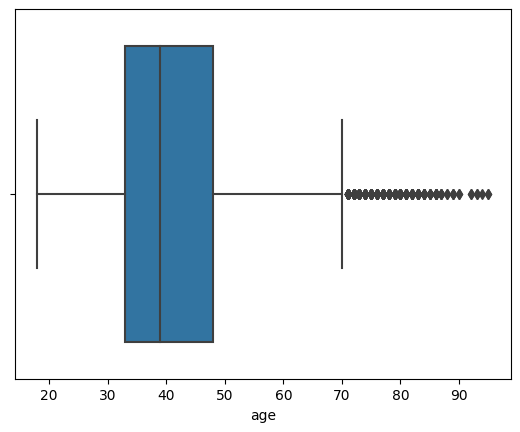

In [9]:
#box plot for age column
sns.boxplot(x=df["age"])

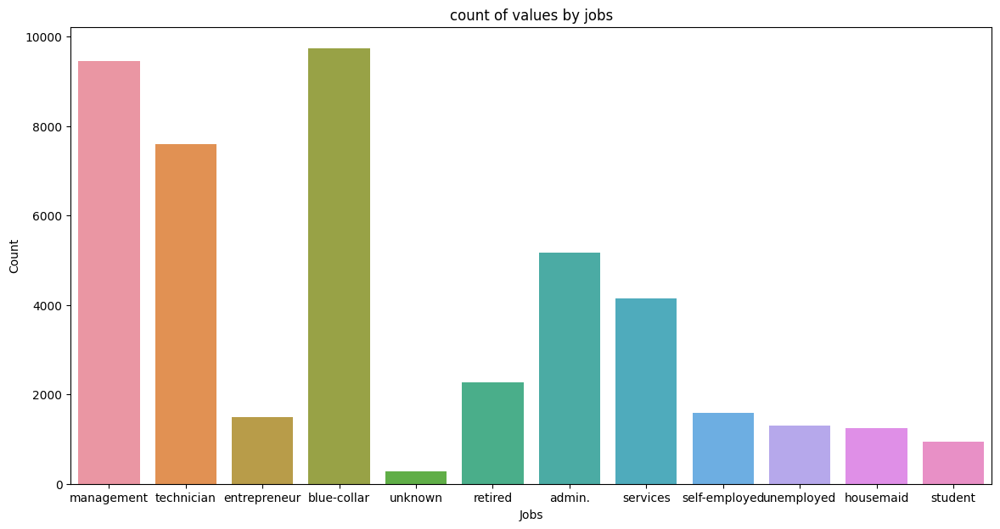

In [10]:
#count plot for job column
plt.figure(figsize=(14,7))
plot=sns.countplot(data=df,x="job")

#adding label and title
plot.set(xlabel="Jobs",ylabel="Count",title="count of values by jobs")
plt.show()

<AxesSubplot: >

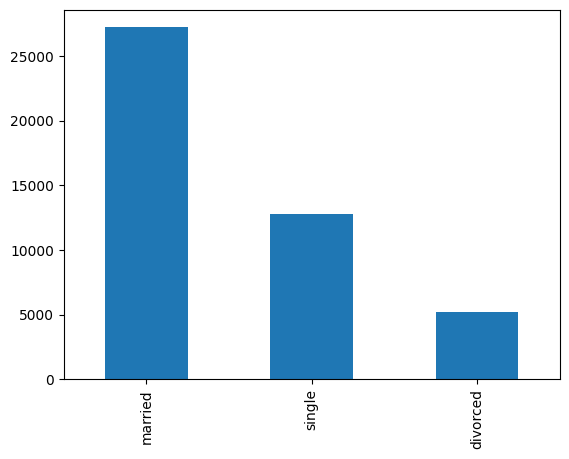

In [11]:
#based on marital column plotting bar plot
df["marital"].value_counts().plot.bar()

<AxesSubplot: >

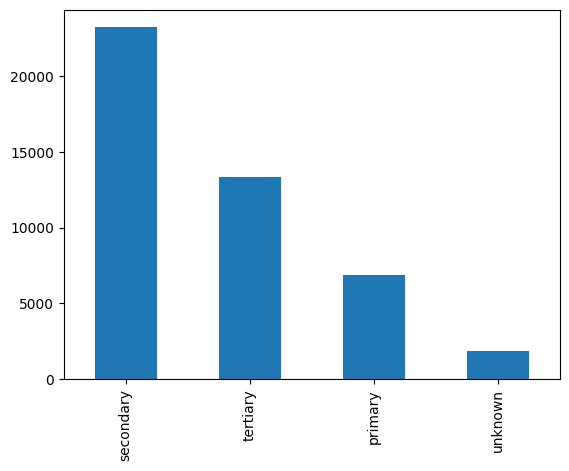

In [12]:
#education qualification column analyse 
df["education_qual"].value_counts().plot.bar()

<AxesSubplot: >

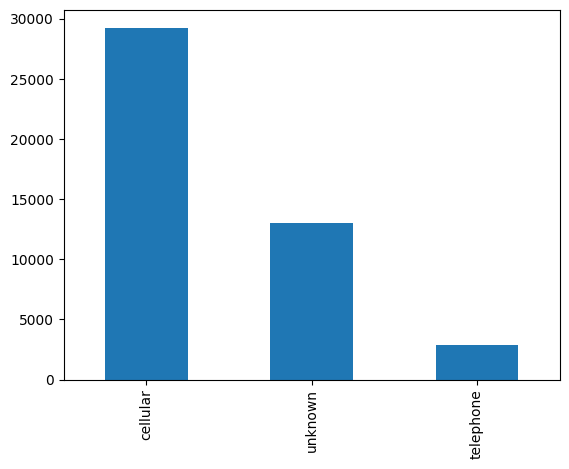

In [13]:
#bar plot analyse to call_type column 
df['call_type'].value_counts().plot.bar()

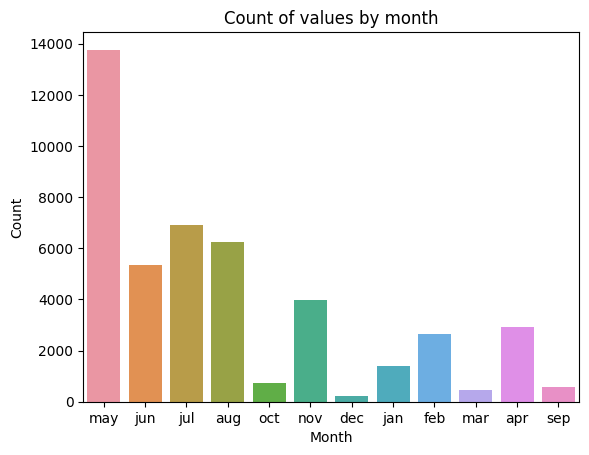

In [14]:
#count of values by month
plot=sns.countplot(x="mon", data=df)

# Add labels and title
plot.set(xlabel='Month', ylabel='Count', title='Count of values by month')

# Show the plot
plt.show()

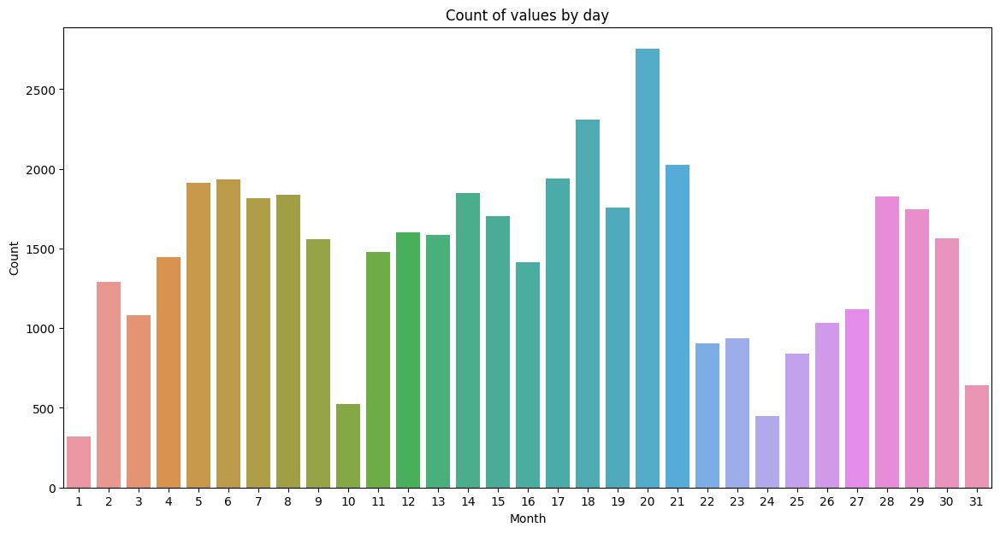

In [15]:
#count of values by day
plt.figure(figsize=(14,7))
plot=sns.countplot(x="day", data=df)

# Add labels and title
plot.set(xlabel='Month', ylabel='Count', title='Count of values by day')

# Show the plot
plt.show()

<AxesSubplot: xlabel='num_calls', ylabel='count'>

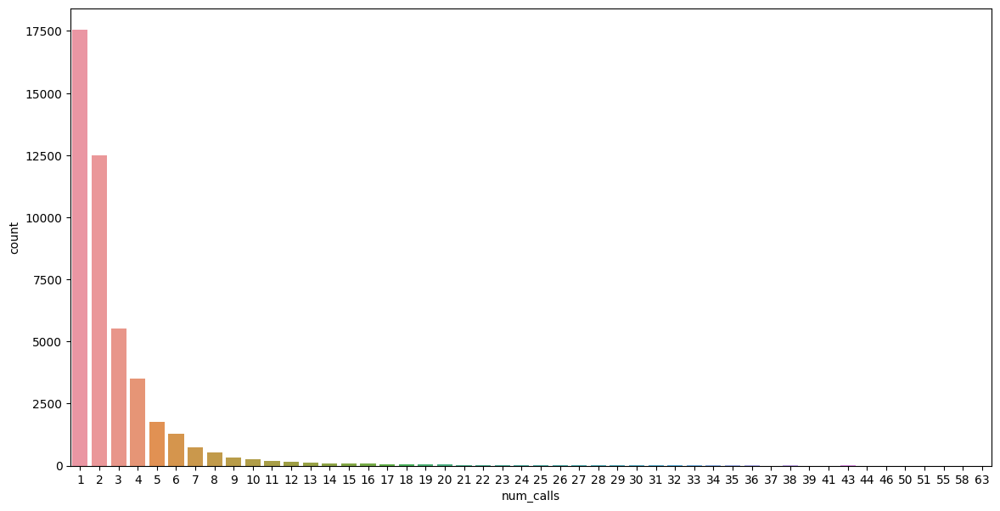

In [16]:
#number of calls
plt.figure(figsize=(14,7))
sns.countplot(data=df,x="num_calls")

<AxesSubplot: xlabel='num_calls', ylabel='dur'>

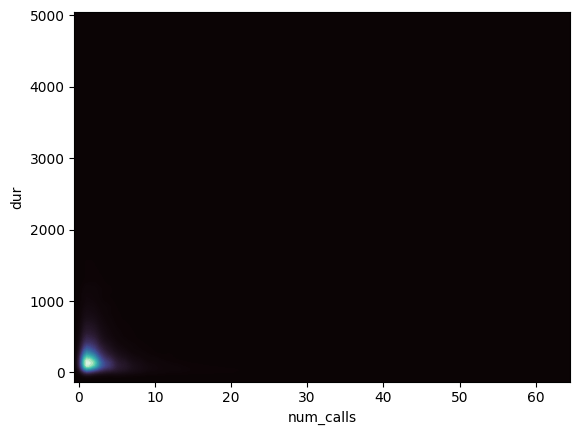

In [17]:
#kde plot for call duration
sns.kdeplot(
    data=df, x="num_calls", y="dur",
    fill=True, thresh=0, levels=100, cmap="mako",
)

#sns.barplot(x="dur",y="num_calls",data=df)

<AxesSubplot: xlabel='prev_outcome', ylabel='count'>

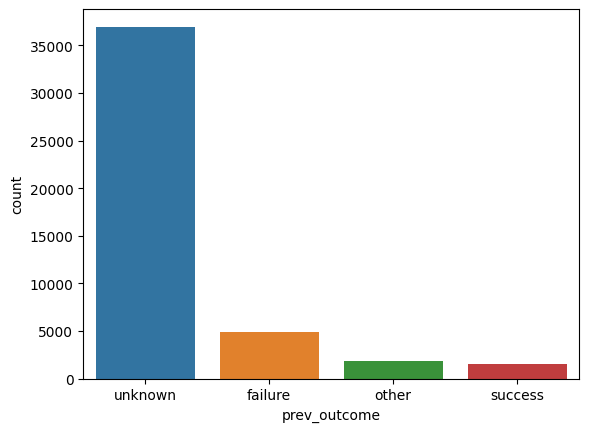

In [18]:
#using count plot for prev_outcom
sns.countplot(x="prev_outcome",data=df)

<AxesSubplot: xlabel='y', ylabel='count'>

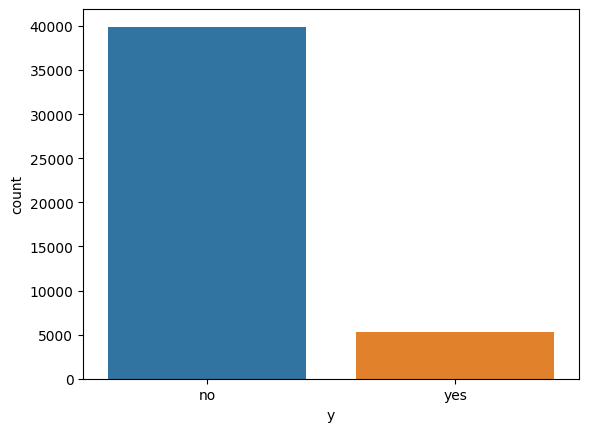

In [19]:
sns.countplot(data=df,x="y")

# observations:
1. The above data set contains **6 rows** of duplicates.
2. The **"Job"** feature shows that **"Blue Collar" and "Management"** occupations occupy almost 43%.
3. The **"Marital"** feature shows that divorced persons are a very low proportion. **"Married"** persons are more numerous than **"Single"** persons.
4. The **"edu_qual"** feature shows that persons with a **"Secondary"** level of education occupy more than **54%** of the total data.
5. Most people make contact via **"Cellular"** networks, with a lot of phone calls being made in May, followed by July, August, and June, etc. Most of the calls are made in the middle of the month, such as on the **19th to 20th, which is high, the 5th to 9th are moderate, and the 11th to 17th and 28th to 30th are medium**. The beginning of the month, on the 1st and 2nd, has very low phone call volumes, less than **0.7%.**
6. The **second time** of calling is very low compared to the first time. Most people decide whether they need insurance during their first call. Only **4%** of people continue to make more than four calls.
8. **prev_outcome** is become a highly imbalanced **(53.1%).** 
7. Finally, the results show that **88%** of people won't take term insurance.


## Bivariate analysis 

In [20]:
#here using pandas profile report to analysis the data
import pandas as pd
from pandas_profiling import ProfileReport


# Create a profile report
profile = ProfileReport(df)

# Generate the report
profile.to_file("output.html")


C:\Users\elcot\AppData\Local\Temp\ipykernel_2756\3784291343.py:3: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

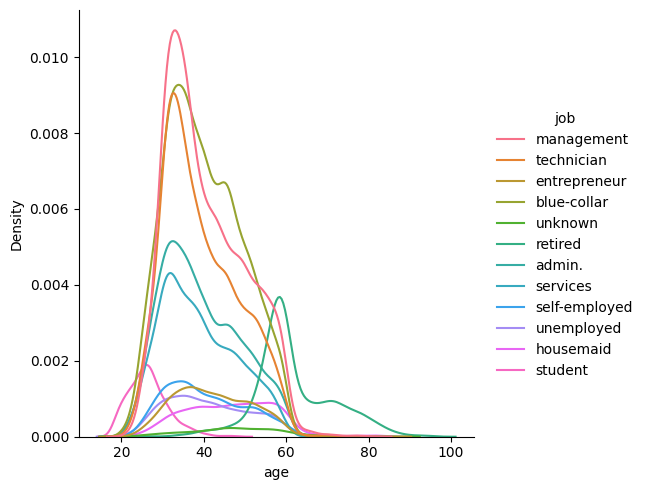

In [21]:
#dist plot for age and job feature

sns.displot(data=df, x="age", hue="job", kind="kde")

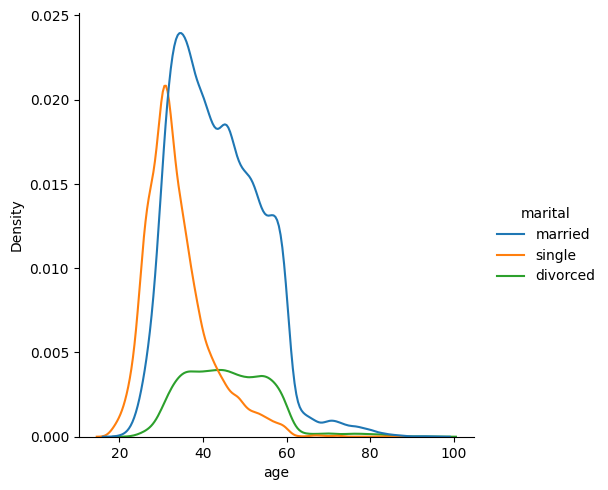

In [22]:
# dist plot for age vs marital
sns.displot(data=df, x="age", hue="marital", kind="kde")

<AxesSubplot: xlabel='age', ylabel='Density'>

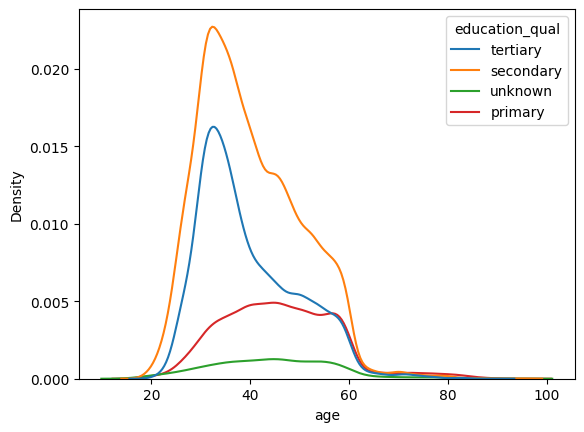

In [23]:
#dist plot for age vs educational qualification
sns.kdeplot(data=df, x="age", hue="education_qual")

<AxesSubplot: xlabel='age', ylabel='Density'>

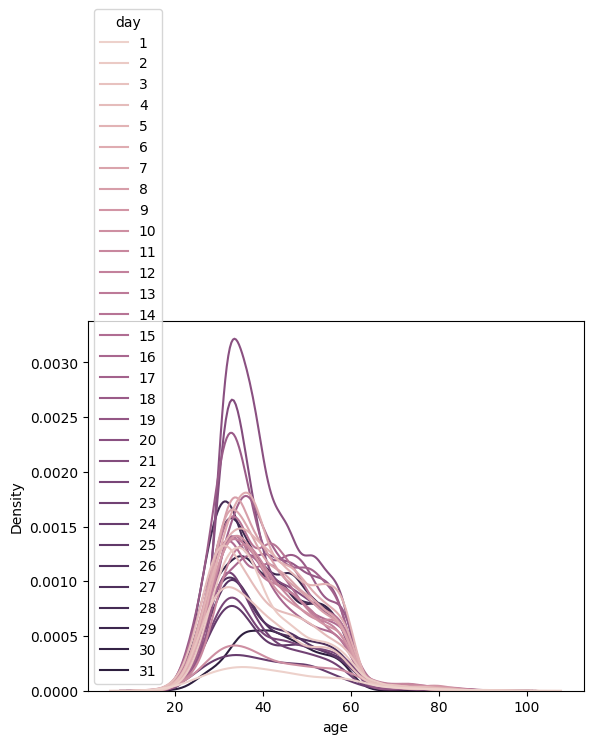

In [24]:
#scatter plot for age vs day column

sns.kdeplot(data=df, x="age", hue="day")

<AxesSubplot: xlabel='age', ylabel='Density'>

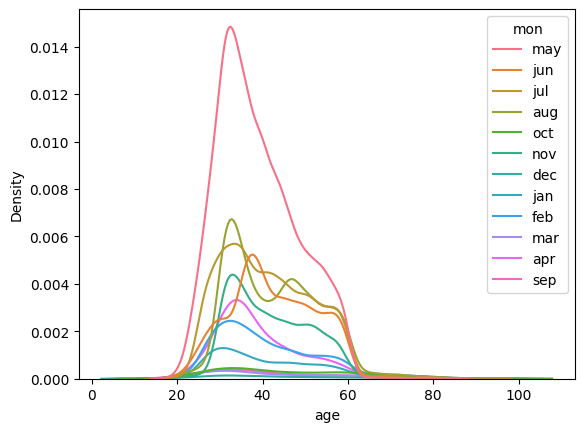

In [25]:
#kde plot for age vs mon
sns.kdeplot(data=df, x="age", hue="mon")

<AxesSubplot: xlabel='age', ylabel='dur'>

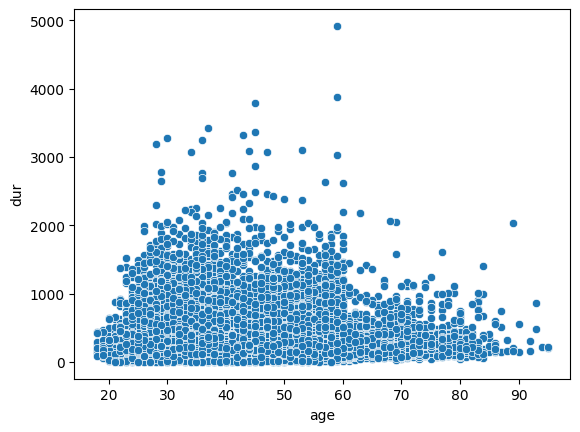

In [26]:
#scatter plot for age vs dur

sns.scatterplot(data=df, x="age",y="dur")

<AxesSubplot: xlabel='age', ylabel='num_calls'>

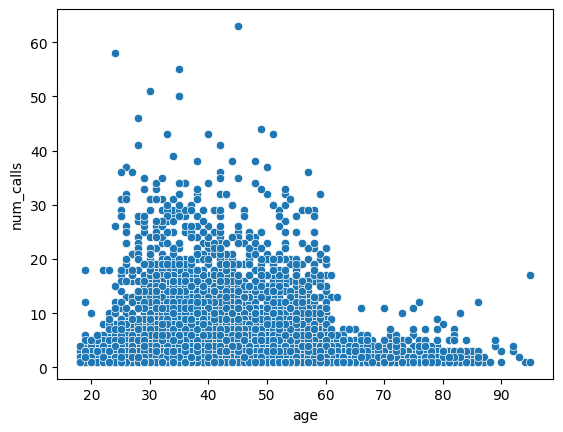

In [27]:
#scatter plot for age vs number of calls connecting

sns.scatterplot(data=df, x="age", y="num_calls")

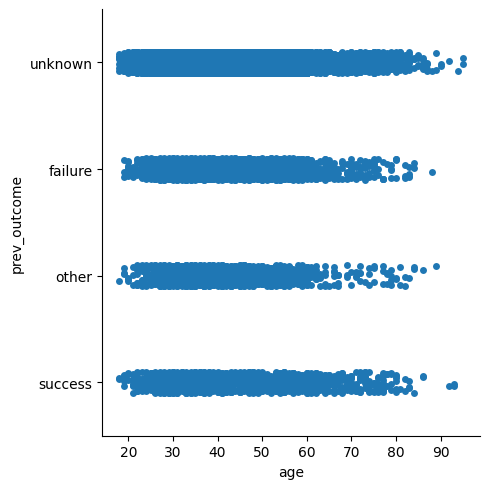

In [28]:
#catplot for age and prev_calls column
sns.catplot(data=df, x="age", y="prev_outcome")

<AxesSubplot: xlabel='age', ylabel='Density'>

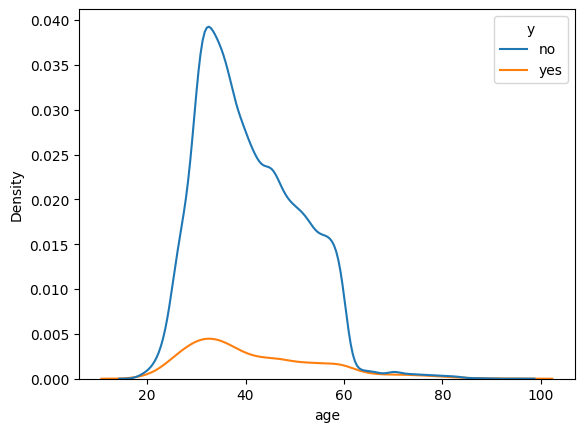

In [29]:
#kdeplot for age vs y feature

sns.kdeplot(data=df, x="age", hue="y")

<AxesSubplot: xlabel='job', ylabel='count'>

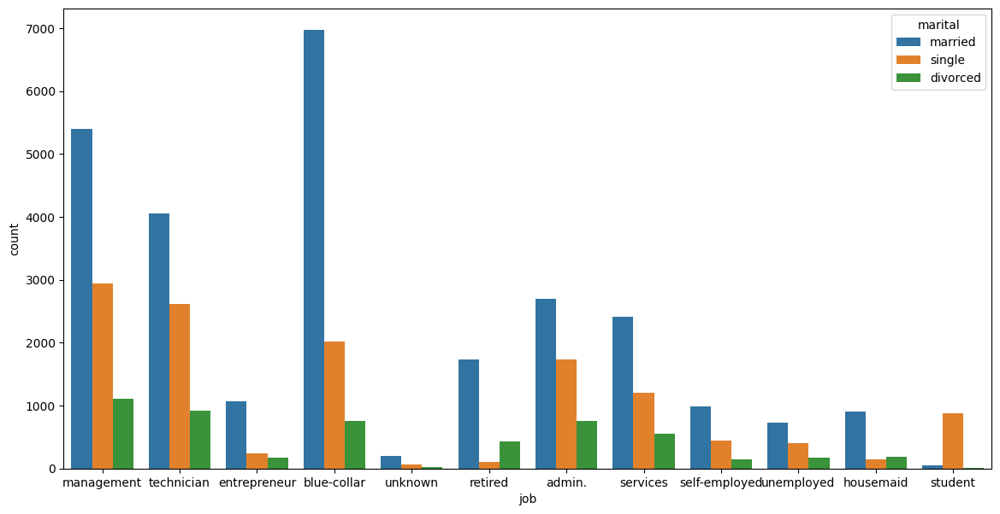

In [30]:
#count plot for job vs marital
plt.figure(figsize=(14,7))
sns.countplot(data=df,x="job", hue="marital")

<AxesSubplot: xlabel='job', ylabel='count'>

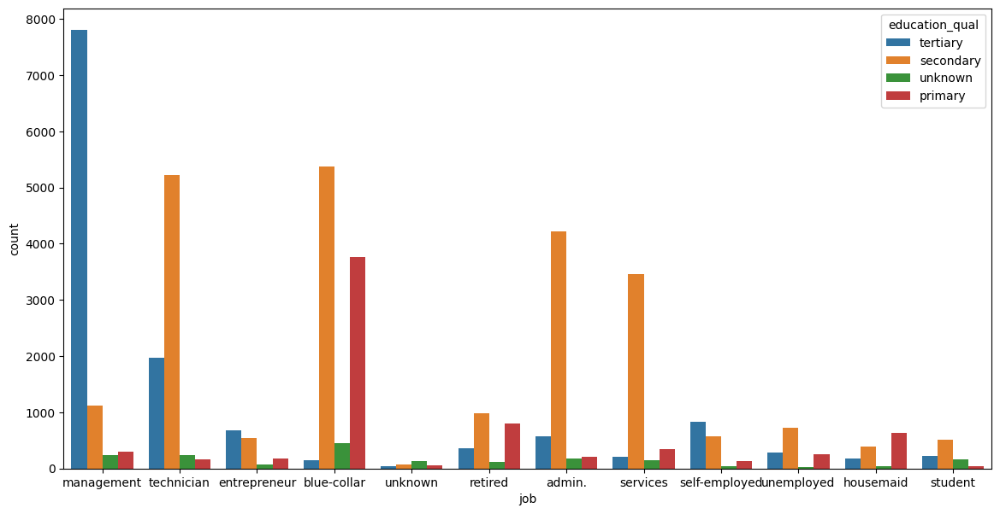

In [31]:
#count plot for jov vs educational qualification
plt.figure(figsize=(14,7))
sns.countplot(data=df, x="job", hue="education_qual")

<AxesSubplot: xlabel='job', ylabel='count'>

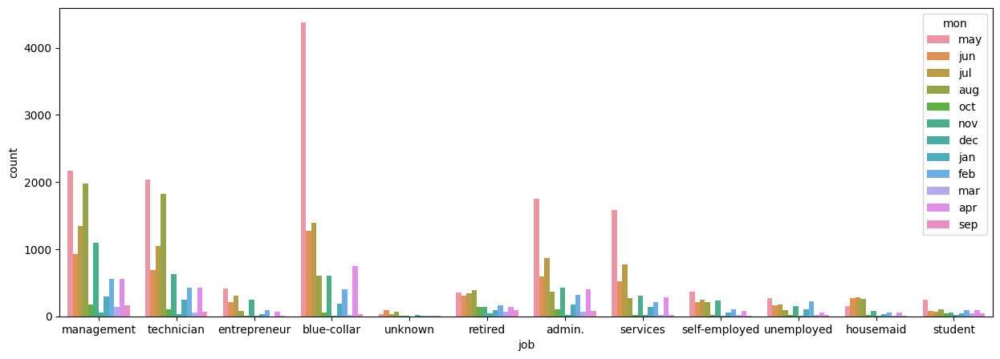

In [32]:
#countplot for job vs mon
plt.figure(figsize=(15,5))
sns.countplot(data=df, x="job", hue="mon")

<AxesSubplot: xlabel='job', ylabel='count'>

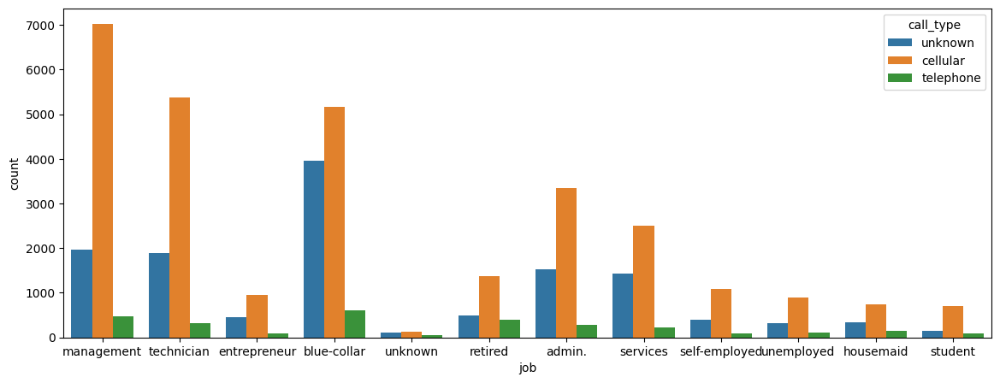

In [33]:
#count plot for job vs call_type feature column

plt.figure(figsize=(14,5))
sns.countplot(data=df, x="job", hue="call_type")

<AxesSubplot: xlabel='job', ylabel='dur'>

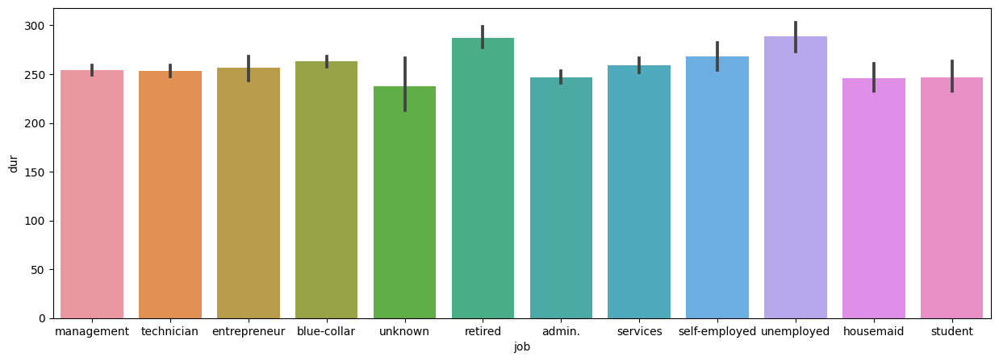

In [34]:
#kdeplot for job vs dur 

plt.figure(figsize=(15,5))
sns.barplot(data=df,x="job",y="dur",estimator="mean")

<AxesSubplot: xlabel='job', ylabel='num_calls'>

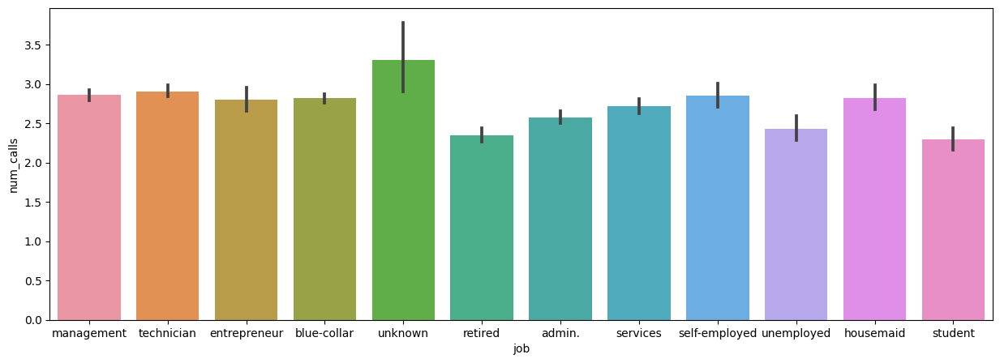

In [35]:
#barplot for job vs num_calls feature column 

plt.figure(figsize=(15,5))
sns.barplot(data=df,x="job",y="num_calls")

<AxesSubplot: xlabel='job', ylabel='count'>

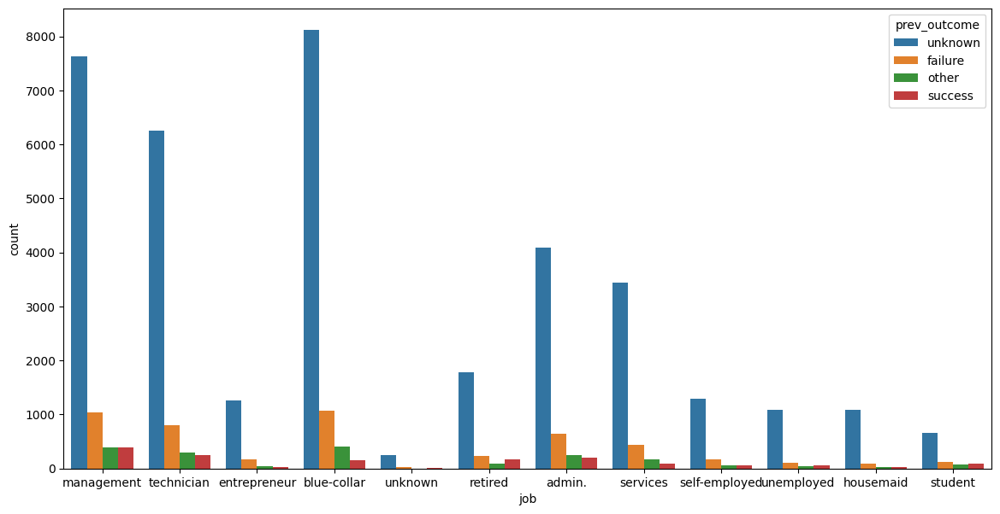

In [36]:
#count plot for job vs prev_outcome

plt.figure(figsize=(14,7))
sns.countplot(data=df,x="job",hue="prev_outcome")

<AxesSubplot: xlabel='job', ylabel='count'>

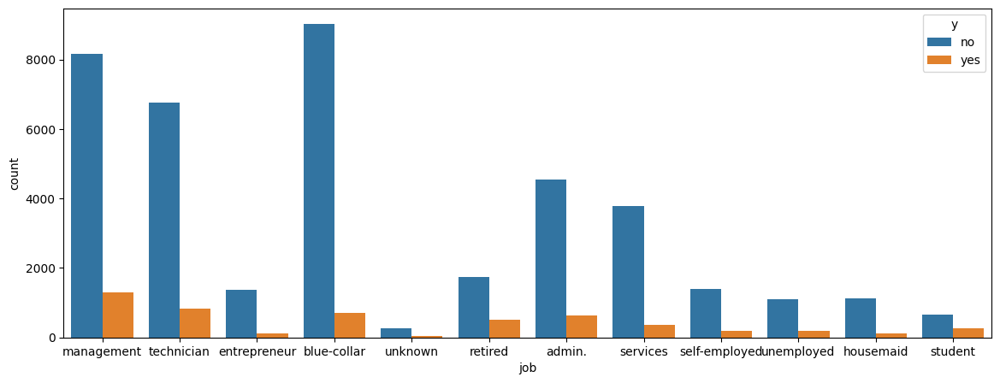

In [37]:
#displot in job vs y(outcome)

plt.figure(figsize=(14,5))
sns.countplot(data=df, x="job", hue="y")

<AxesSubplot: xlabel='marital', ylabel='count'>

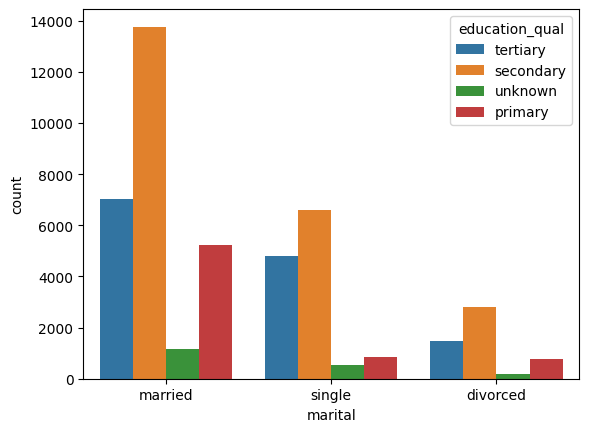

In [38]:
#barplot for marital vs education_qualification

sns.countplot(data=df,x="marital",hue="education_qual")

<AxesSubplot: xlabel='marital', ylabel='count'>

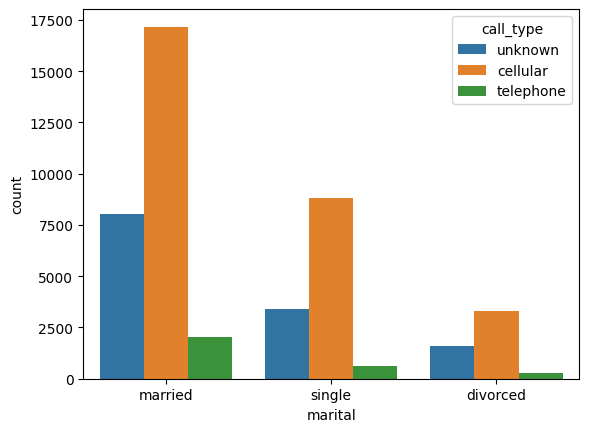

In [39]:
#countplot for marital vs call_type feature

sns.countplot(data=df, x="marital", hue="call_type")

<AxesSubplot: xlabel='count', ylabel='marital'>

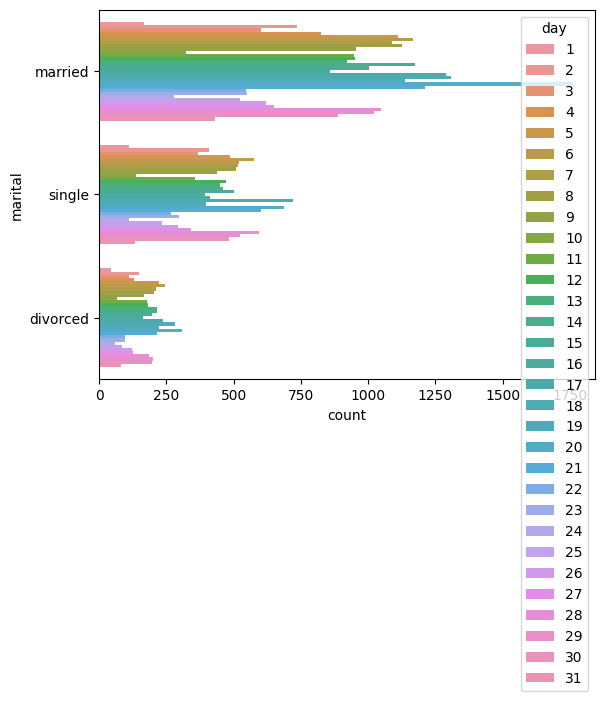

In [40]:
#countplot for marital vs day feature column

sns.countplot(data=df, y="marital",hue="day")

<AxesSubplot: xlabel='marital', ylabel='count'>

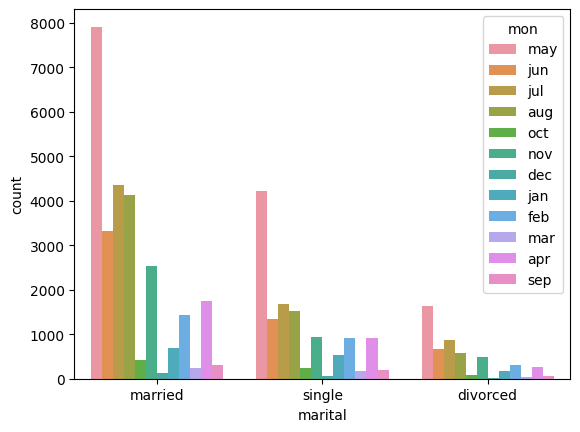

In [41]:
#count plot for marital vs month featrue column

sns.countplot(data=df, x="marital",hue="mon")

<AxesSubplot: xlabel='marital', ylabel='dur'>

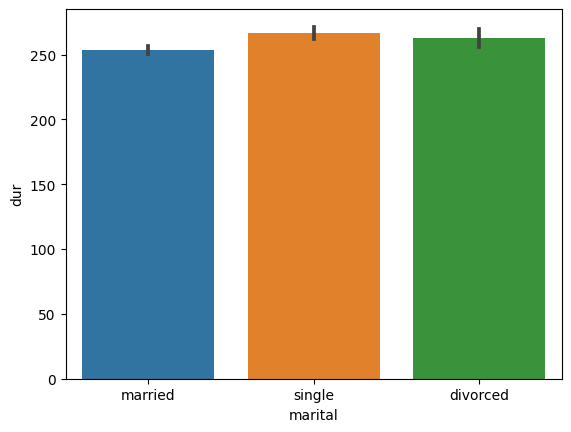

In [42]:
#bar plot for marital and call duration feature column

sns.barplot(data=df,x="marital",y="dur")

<AxesSubplot: xlabel='marital', ylabel='num_calls'>

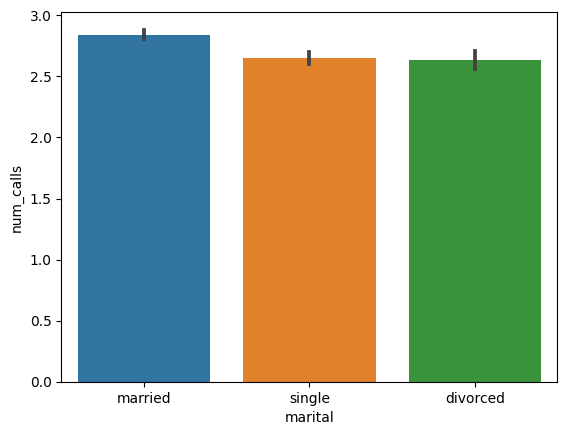

In [43]:
#bar plot for marital vs num_calls column

sns.barplot(data=df, x="marital", y="num_calls")

<AxesSubplot: xlabel='marital', ylabel='count'>

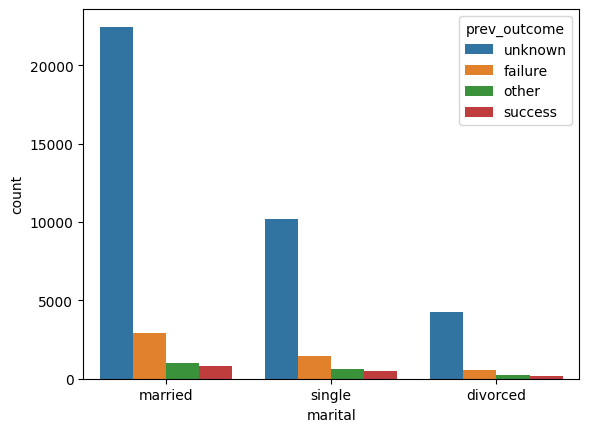

In [44]:
#barplot for marital vs prev_outcome column

sns.countplot(data=df,x="marital",hue="prev_outcome")

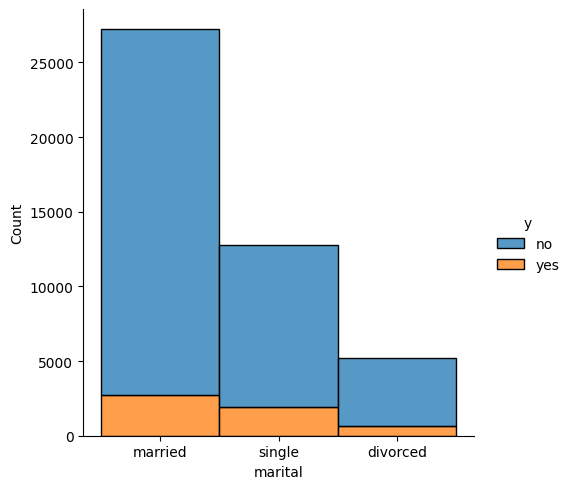

In [45]:
#displot for marital vs final outcome(y) features

sns.displot(data=df, x="marital", hue="y", multiple="stack")

<AxesSubplot: xlabel='education_qual', ylabel='count'>

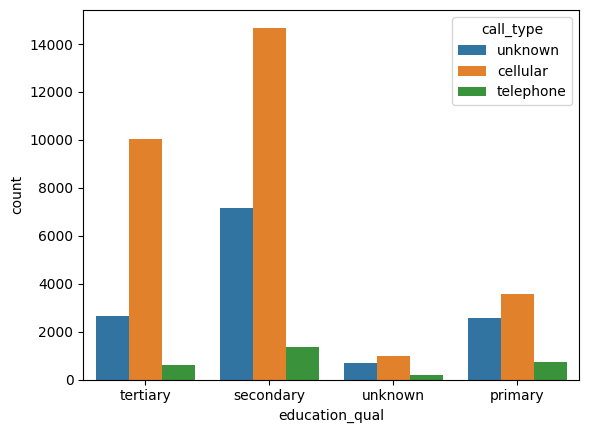

In [46]:
#count plot education _qual vs call_type

sns.countplot(data=df,x="education_qual", hue="call_type")

<AxesSubplot: xlabel='count', ylabel='education_qual'>

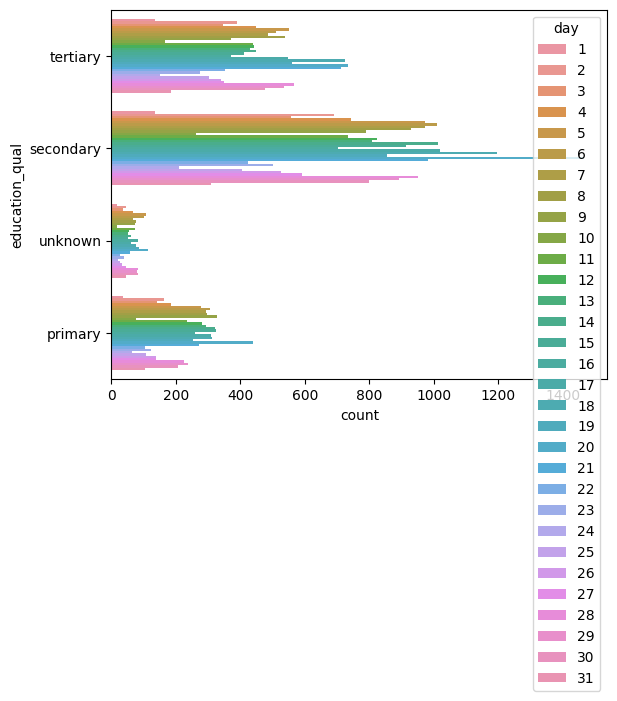

In [47]:
#barplot for eucation_qua vs day column

sns.countplot(data=df,y="education_qual",hue="day")

<AxesSubplot: xlabel='education_qual', ylabel='count'>

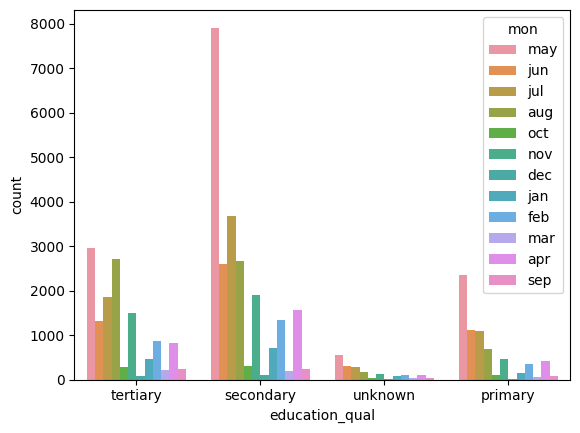

In [48]:
#count plot for education qualification vs month feature

sns.countplot(data=df,x="education_qual", hue="mon")

<AxesSubplot: xlabel='education_qual', ylabel='dur'>

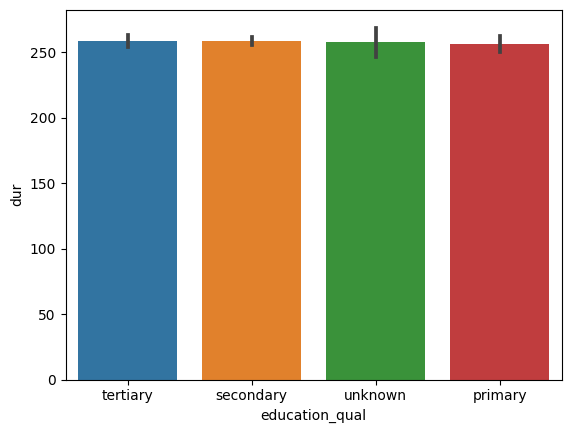

In [49]:
#barplot education_qual vs duration feature column

sns.barplot(data=df, x="education_qual",y="dur")

<AxesSubplot: xlabel='education_qual', ylabel='num_calls'>

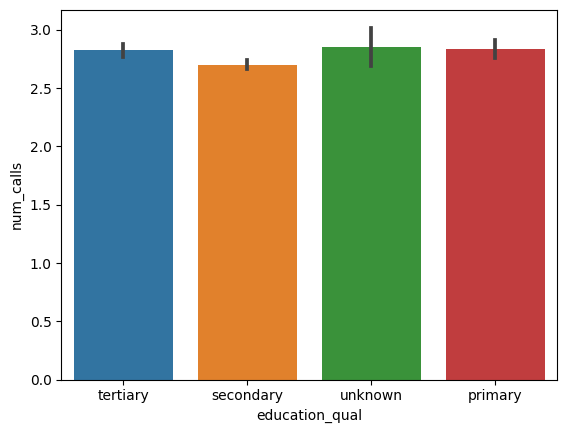

In [50]:
#barplot for educational qualification vs num_calls feature column

sns.barplot(data=df, x="education_qual",y="num_calls")

<AxesSubplot: xlabel='education_qual', ylabel='count'>

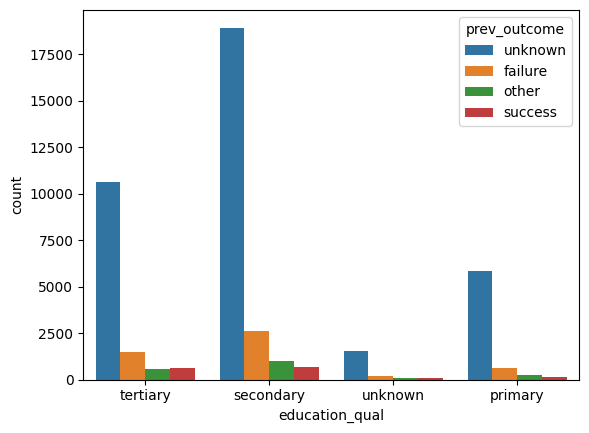

In [51]:
#countplot for education qualification vs pre_outcom

sns.countplot(data=df,x="education_qual",hue="prev_outcome")

<AxesSubplot: xlabel='education_qual', ylabel='count'>

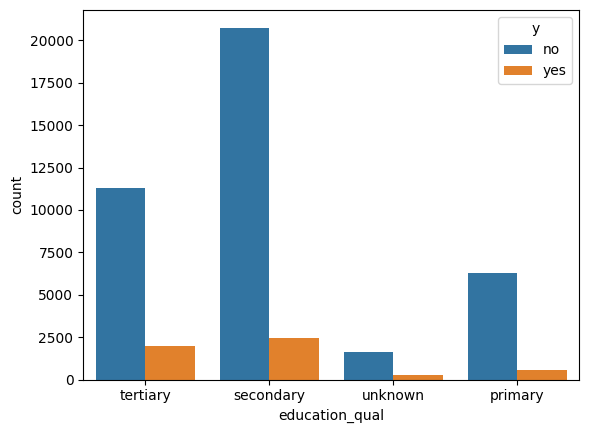

In [52]:
#countplot for education qualification vs y

sns.countplot(data=df, x="education_qual",hue="y")

<AxesSubplot: xlabel='call_type', ylabel='count'>

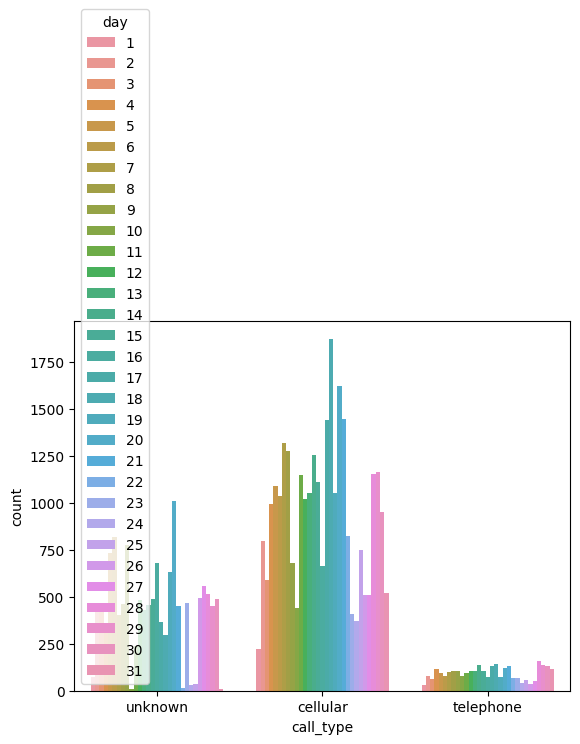

In [53]:
#countplot call_type vs day feature column

sns.countplot(data=df,x="call_type",hue="day")

<AxesSubplot: xlabel='call_type', ylabel='count'>

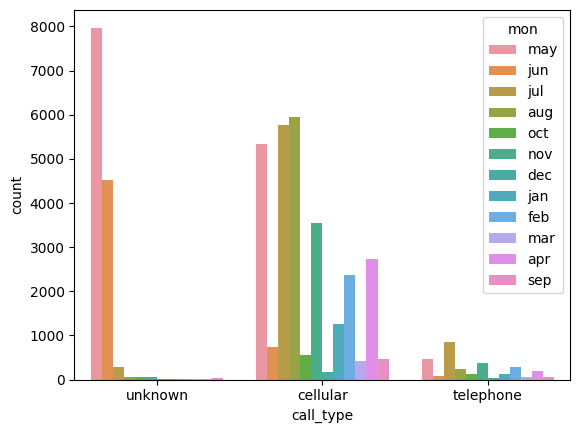

In [54]:
#countplot call_type vs month feature column

sns.countplot(data=df,x="call_type",hue="mon")

<AxesSubplot: xlabel='call_type', ylabel='dur'>

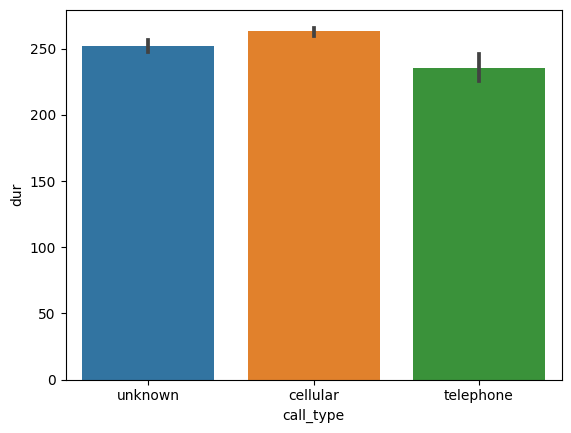

In [55]:
#barplot for call type vs duration feature

sns.barplot(data=df, x="call_type",y="dur")

<AxesSubplot: xlabel='call_type', ylabel='num_calls'>

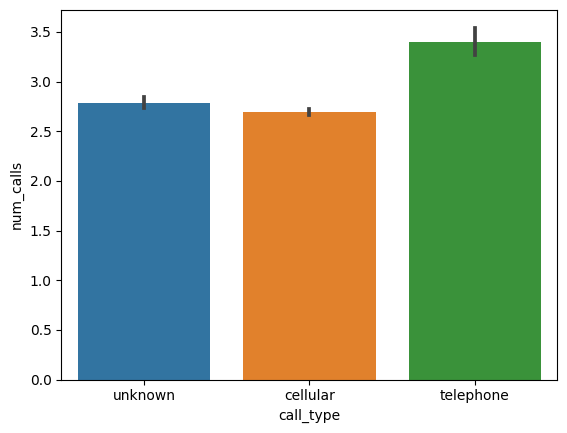

In [56]:
#barplot call_type vs num_calls feature calumn

sns.barplot(data=df,x="call_type",y="num_calls")

<AxesSubplot: xlabel='call_type', ylabel='count'>

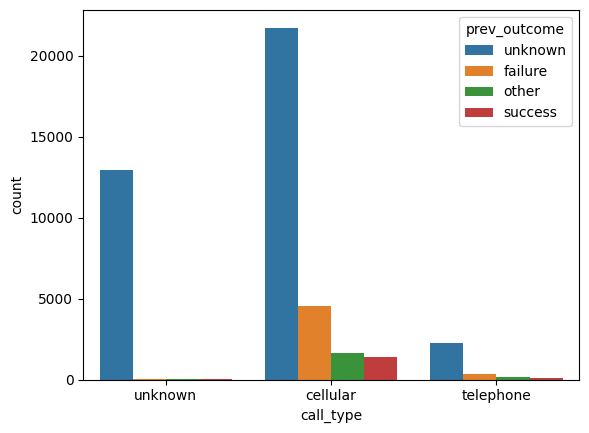

In [57]:
#countplot prev_outcome vs call_type column

sns.countplot(data=df,x="call_type",hue="prev_outcome")

<AxesSubplot: xlabel='call_type', ylabel='count'>

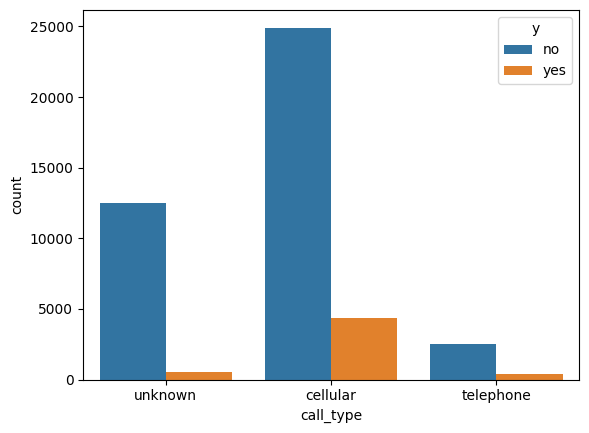

In [58]:
#countplot calltype vs y (outcome)


sns.countplot(data=df,x="call_type",hue="y")

<AxesSubplot: xlabel='day', ylabel='Density'>

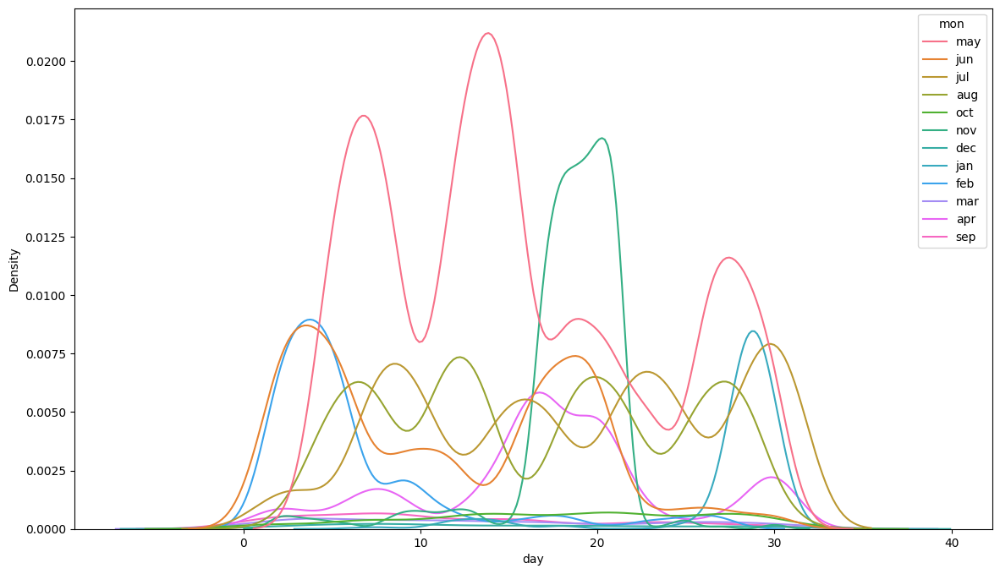

In [59]:
#line plot for day vs month feature

plt.figure(figsize=(14,8))
sns.kdeplot(data=df,x="day",hue="mon")

<AxesSubplot: xlabel='day', ylabel='dur'>

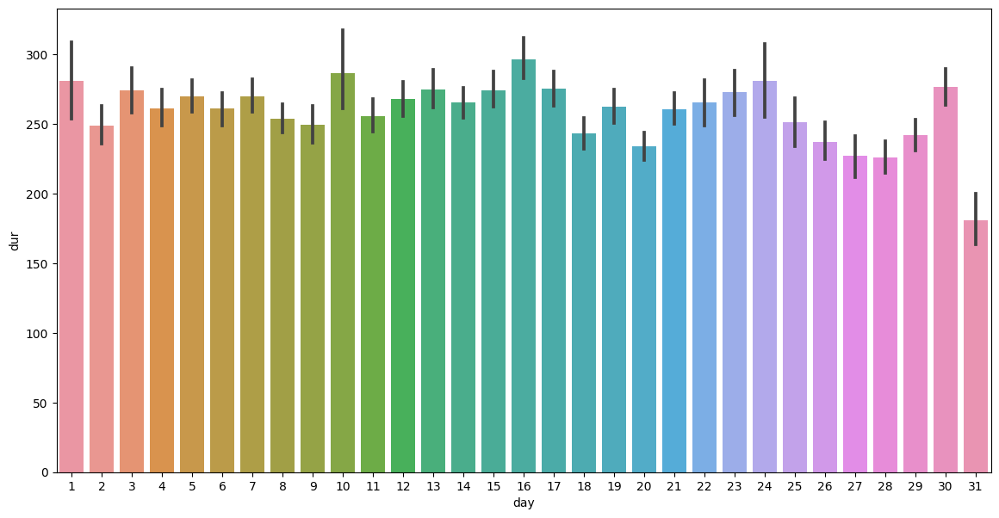

In [60]:
#bar plot for day vs dur feature

plt.figure(figsize=(14,7))
sns.barplot(data=df,x="day",y="dur",estimator="mean")

<AxesSubplot: xlabel='day', ylabel='num_calls'>

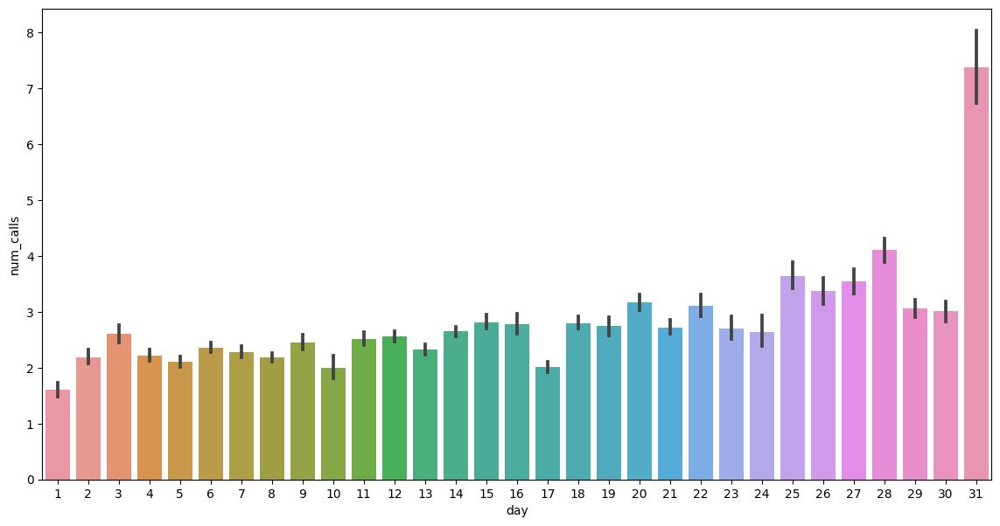

In [61]:
#barplot for day vs num_calls

plt.figure(figsize=(14,7))
sns.barplot(data=df,x="day",y="num_calls")

<Figure size 1400x500 with 0 Axes>

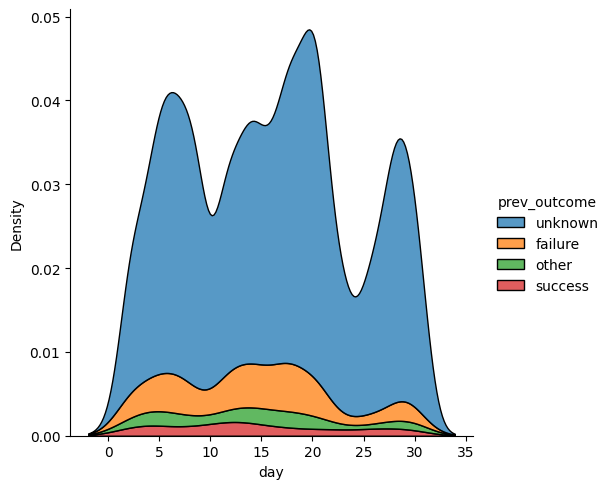

In [62]:
#displot for day vs prev_outcome features

plt.figure(figsize=(14,5))
sns.displot(df, x="day", hue="prev_outcome", kind="kde", multiple="stack")
#sns.displot(df,x="day",hue="prev_outcome",stat="percent")

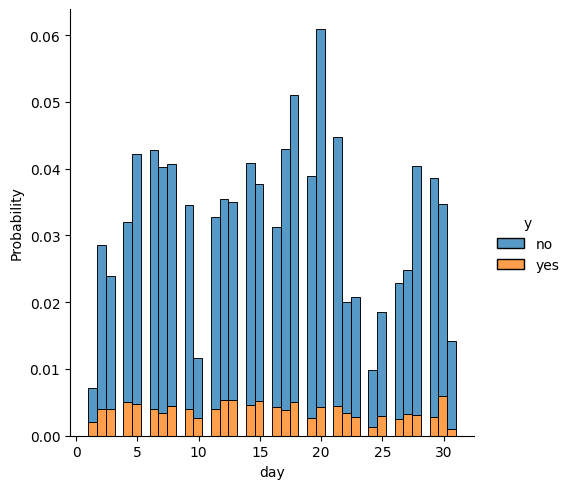

In [63]:
#displot for day vs y(outcome)

sns.displot(df, x="day",hue="y",multiple="stack",stat="probability")

<AxesSubplot: xlabel='mon', ylabel='dur'>

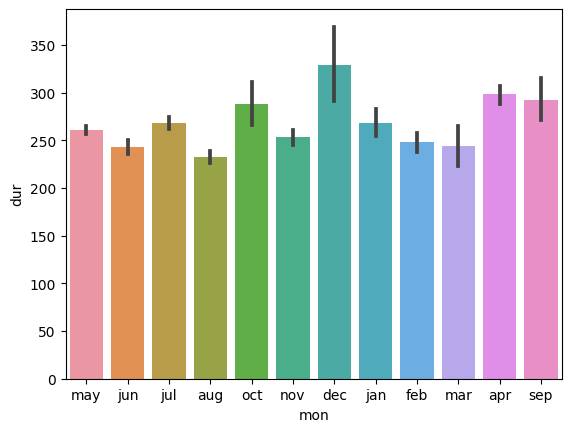

In [64]:
#barplot for month vs duration feature

sns.barplot(data=df,y="dur",x="mon")

<AxesSubplot: xlabel='count', ylabel='mon'>

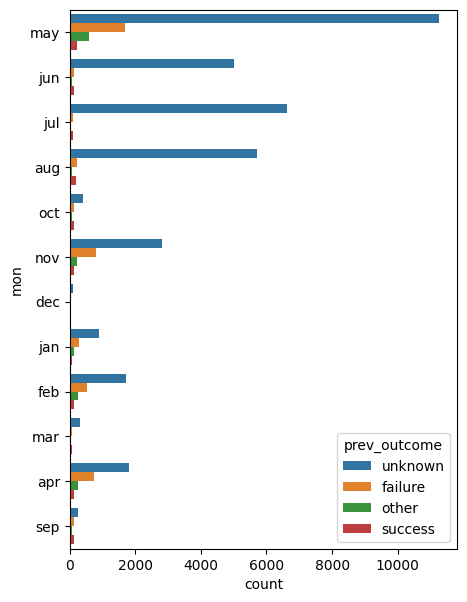

In [65]:
#counplot for month vs prev_outcome feature

plt.figure(figsize=(5,7))
sns.countplot(df,y="mon",hue="prev_outcome")

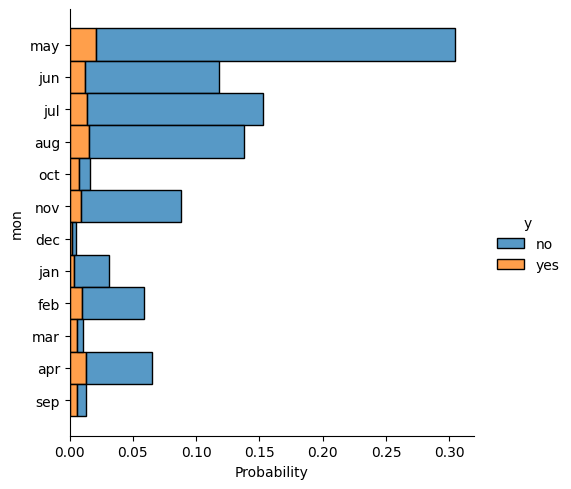

In [66]:
#displot for month vs y(outcome)

sns.displot(df,y="mon",hue="y",multiple="stack",stat="probability")

<AxesSubplot: xlabel='dur', ylabel='num_calls'>

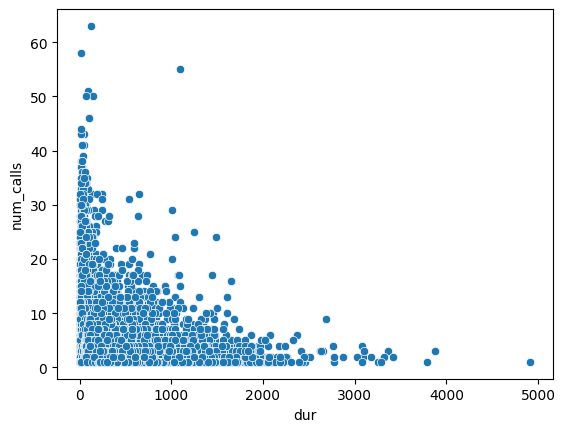

In [67]:
#scatter plot for duration of calls vs number of calls

sns.scatterplot(data=df,x="dur",y="num_calls")

<AxesSubplot: xlabel='dur', ylabel='prev_outcome'>

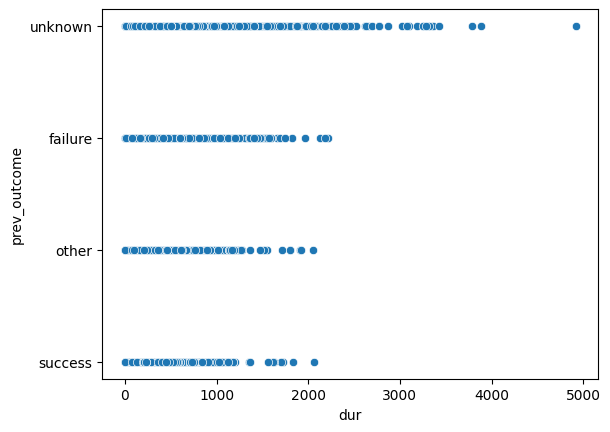

In [68]:
#scatter plot for duration vs prev_outcome

sns.scatterplot(data=df, x="dur",y="prev_outcome")

<AxesSubplot: xlabel='y', ylabel='dur'>

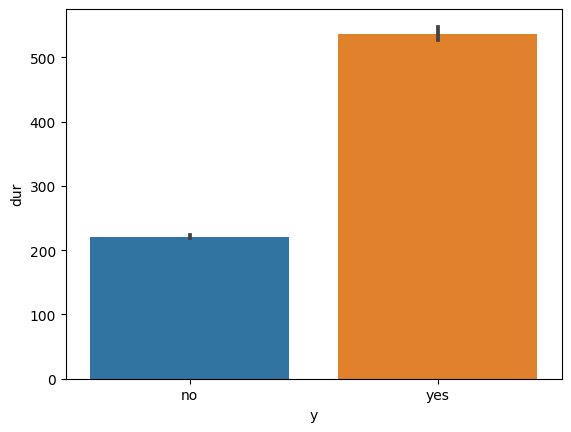

In [69]:
#scatterplot for duration vs y

sns.barplot(data=df,x="y",y="dur",estimator="mean")

<AxesSubplot: xlabel='prev_outcome', ylabel='num_calls'>

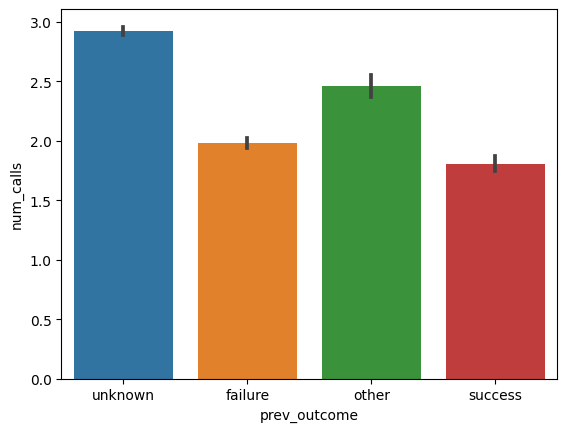

In [70]:
#barplot num_calls vs prev_outcome feature

sns.barplot(data=df,x="prev_outcome",y="num_calls")

<AxesSubplot: xlabel='y', ylabel='num_calls'>

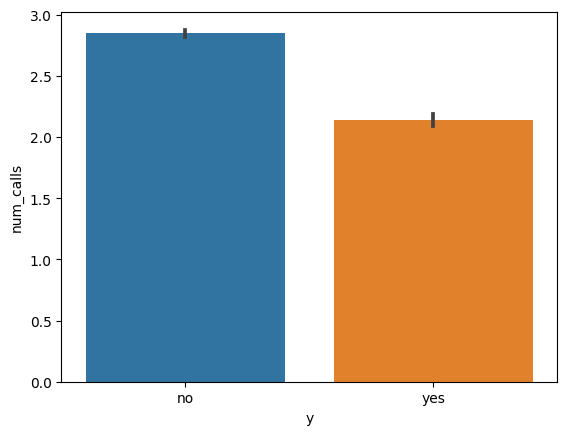

In [71]:
#barplot for num_calls vs y

sns.barplot(data=df,x="y",y="num_calls")

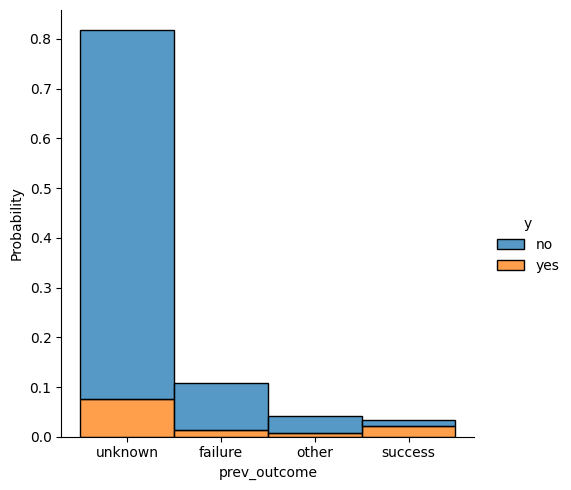

In [72]:
#countplot for prev_outcome vs y

sns.displot(df,x="prev_outcome",hue="y",multiple="stack",stat="probability")

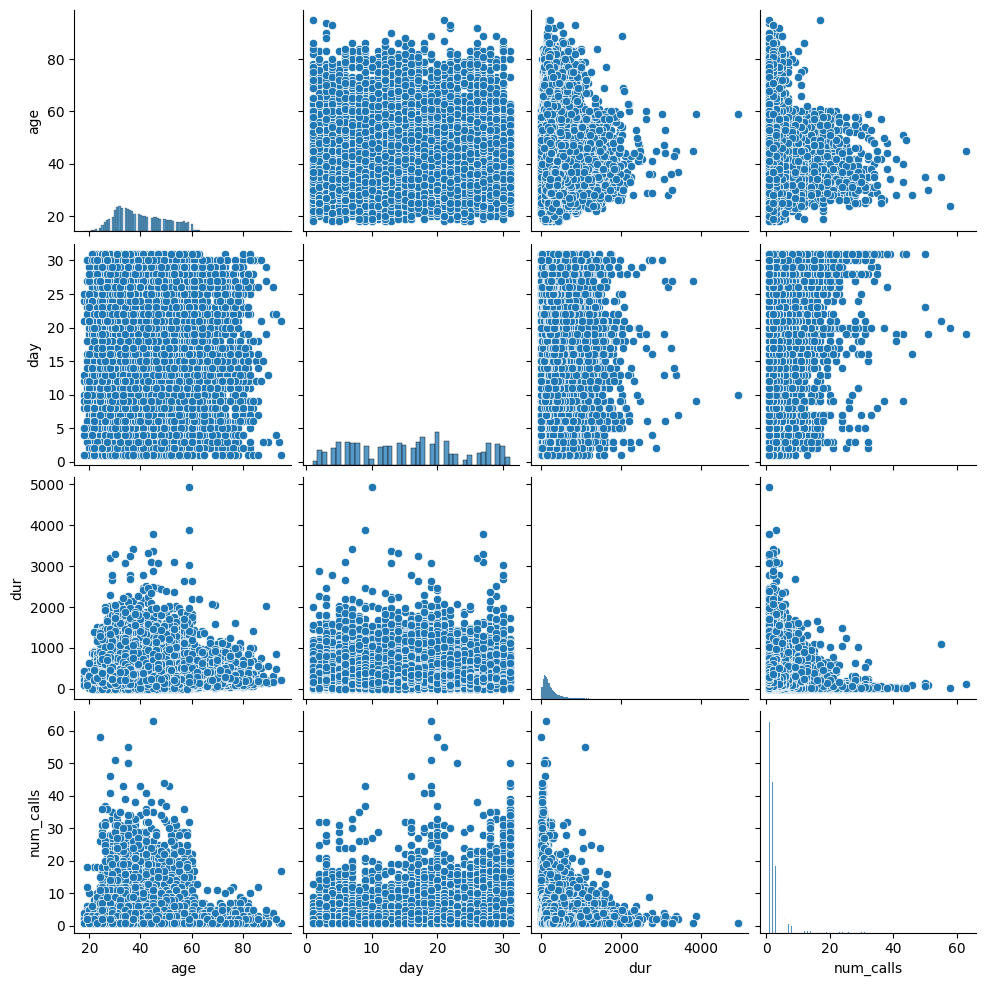

In [73]:
#pairplot for our dataset

sns.pairplot(df)

## Observation

1. In the previous outcome feature, there were a lot of unknown stages of people. Nearly 11% of people were taking the insurance. In the last campaign, 10% of people were in the "failure" status, 1.3% converted to taking the term insurance, 3.3% of people actually accepted the term insurance, but finally, 1% of people rejected the insurance. Married persons are mostly present in the previous outcome across all stages.


2. Maximum job roles are held by people aged between 30-50 years. Many people get married at the age of 25. People aged 30 have completed more secondary education compared to tertiary education. People aged 25-60 receive a higher number of cellular calls and talk for a longer duration. People aged 40 are not interested in taking term insurance.


3. Blue collar job persons have a marriage rate of 15%, which is higher than single status. In management job roles, more than 2% of people got divorced. Management people have the most number of completed tertiary education, with around 58% of all tertiary completion people occupied by them. Blue collar, technician, admin, and service working persons have the most number of secondary education qualifications. Blue collar job persons have the highest number of people with primary education. Approximately 16% of management people take term insurance, followed by technician job persons.

   Most calls connect to blue collar job people in May. The order for management, technician, admin, services, etc., is the same. Unknown job people have a low number of call connections. Most cellular calls connect to management type job role persons, followed by technicians, and then blue-collar persons. Retired persons talk for a longer duration of calls, followed by unemployed persons. On average, every job role person connects with calls with a duration of 250 minutes. Unknown job role persons connect with more number of average calls. In prev_outcome, the "success" stage is occupied in management, technician, blue-collar, and admin jobs. The most "failure" outcome occurs in blue-collar jobs.
   
   
4. Married persons have a higher number of secondary education qualifications. Most calls, nearly 60%, connect to married persons, while divorced persons have fewer calls. The date range of 18-22 has more call connections. Most of the married persons receive calls in May, while September has a lower number of calls. Single persons have the highest average duration of call talking, which is 260 seconds, followed by divorced persons. The average number of calls that connect is highest for married persons.In prev_outcome, married persons have a higher number of success and failure statuses. Many married persons take insurance.


5. Cellular calls connect with most people. People with secondary education completion have the most number of calls and for more days. People with tertiary education completion come in second place. People with secondary education qualification receive the highest number of calls across all months, compared to people with other qualifications. The duration of calls is equal for all types of education. Both tertiary and secondary education people have a higher rate of accepting term insurance.


6. The most number of cellular calls occurred on the 15th day. 4.1% of calls occurred on the 15th day. Many telephone calls arrived on the last few days of the month. There was a high number of unknown calls in May. Cellular calls arrived mostly in May, July, and August. November and April had a medium number of calls. The average duration of cellular calls is 260 seconds, 250 seconds for unknown calls, and 270 seconds for telephone calls. The most number of "success" and "failure" prev_outcome stages occurred in cellular calls. The final outcome is also cellular having same proportion.


7. In May, the 13th to 15th dates had the highest number of calls. November had the second highest number of calls. The average duration of calls is the highest on the 16th day and the lowest on the 31st day. The 22nd day had the lowest number of "failure" prev_outcome stages. The highest number of "success" outcomes occurred from the 12th to the 15th day. On the 21st day, both "yes" and "no" values for the final outcome were high. The peak days were the 12th and 13th, with the highest positive results.


8. In December, the average call duration was the highest, at 330 seconds. August had the lowest average call duration of 230 seconds. Most of the "success," "failure," and "unknown" outcomes occurred in May and November. October and December had very low "success" rates for prev_outcomes. May had the highest number of people taking term insurance, while December had the lowest.


9. The average call duration for those who took the insurance is 500 seconds, while the average duration for those who rejected the term insurance is 270 seconds.


10. The average number of calls taken to accept the term insurance is 2. The average number of calls taken to reject the term insurance is 3.


11.  Nearly 82% of people with an unknown status in the previous outcome stage ended up accepting the term insurance. In the previous campaign, 4% of people had a "success" status, but ultimately only 2.8% of people took the term insurance, with the remaining rejecting it.

## Multivariate analysis 

<AxesSubplot: xlabel='age', ylabel='job'>

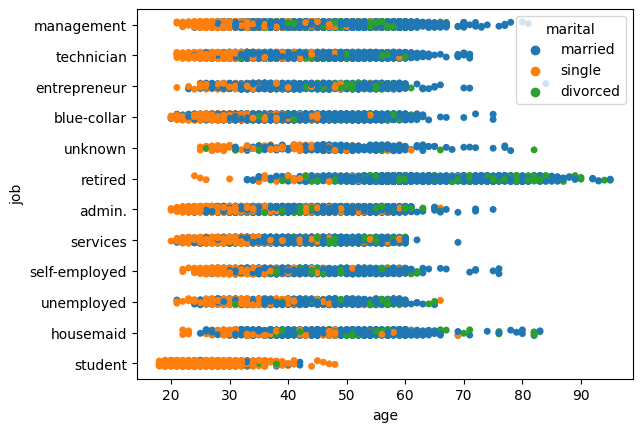

In [74]:
#stripplot for age vs job vs marital

sns.stripplot(data=df, y="job", x="age", hue="marital")

<AxesSubplot: xlabel='job', ylabel='age'>

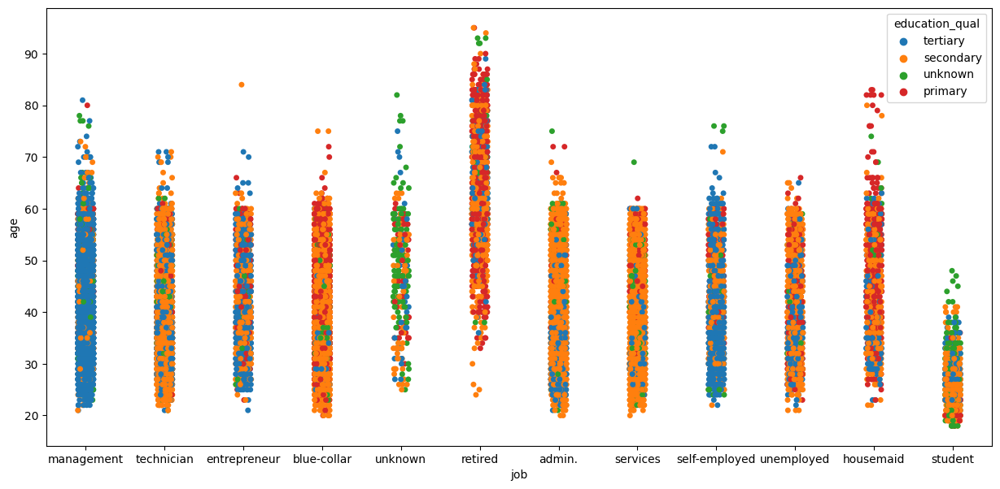

In [75]:
#stripplot for age vs job vs education qualification

plt.figure(figsize=(15,7))
sns.stripplot(data=df, x="job", y="age", hue="education_qual")

<AxesSubplot: xlabel='age', ylabel='job'>

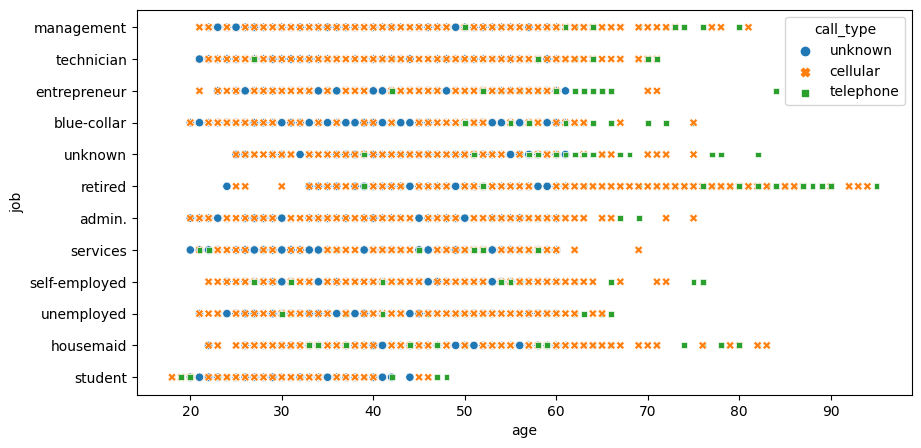

In [76]:
#catplot for age vs job vs calltype

plt.figure(figsize=(10,5))
sns.scatterplot(data=df, y="job", x="age", hue="call_type",style="call_type")

<AxesSubplot: xlabel='age', ylabel='dur'>

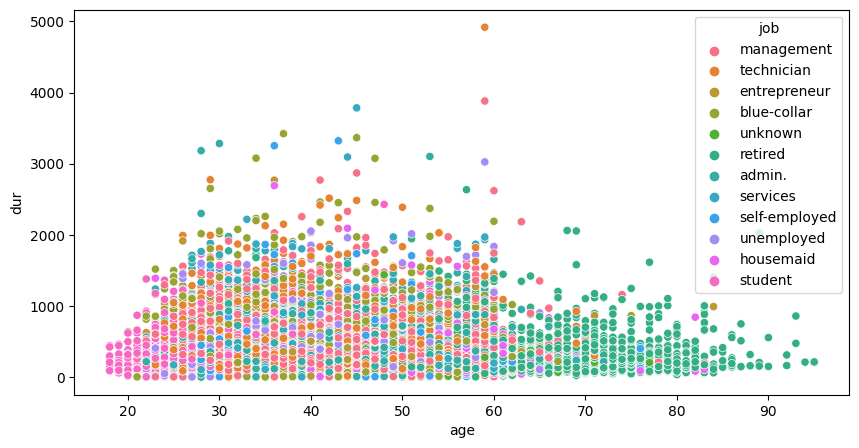

In [77]:
#scatter plot for age vs job vs duration features

plt.figure(figsize=(10,5))
sns.scatterplot(data=df, x="age", y="dur", hue="job")

<AxesSubplot: xlabel='age', ylabel='day'>

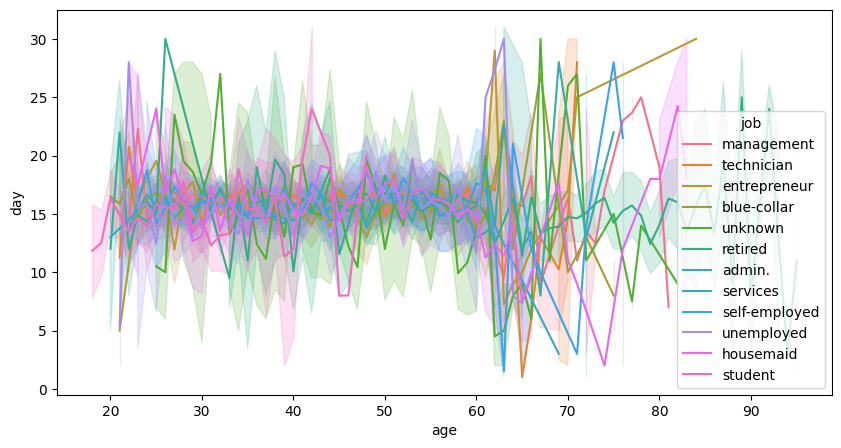

In [78]:
#relplot for age vs job vs day

plt.figure(figsize=(10,5))
sns.lineplot(
    data=df,
    x="age", y="day", hue="job"
)

<AxesSubplot: xlabel='age', ylabel='job'>

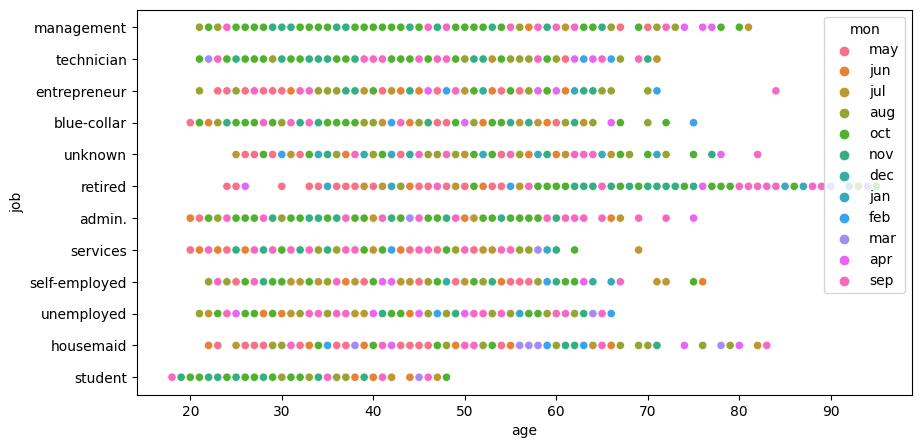

In [79]:
#scatterplot age vs job vs mon

plt.figure(figsize=(10,5))
sns.scatterplot(data=df,x="age",y="job",hue="mon")

<AxesSubplot: xlabel='job', ylabel='age'>

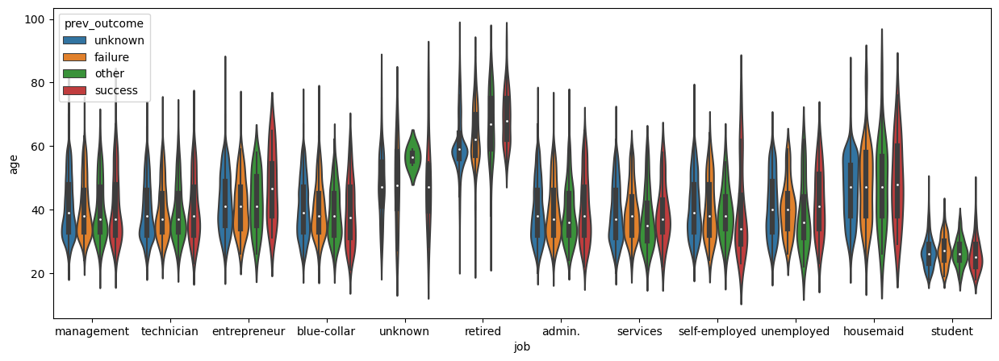

In [80]:
plt.figure(figsize=(15,5))
sns.violinplot(data=df, x="job", y="age", hue="prev_outcome",split=False)

<AxesSubplot: xlabel='job', ylabel='age'>

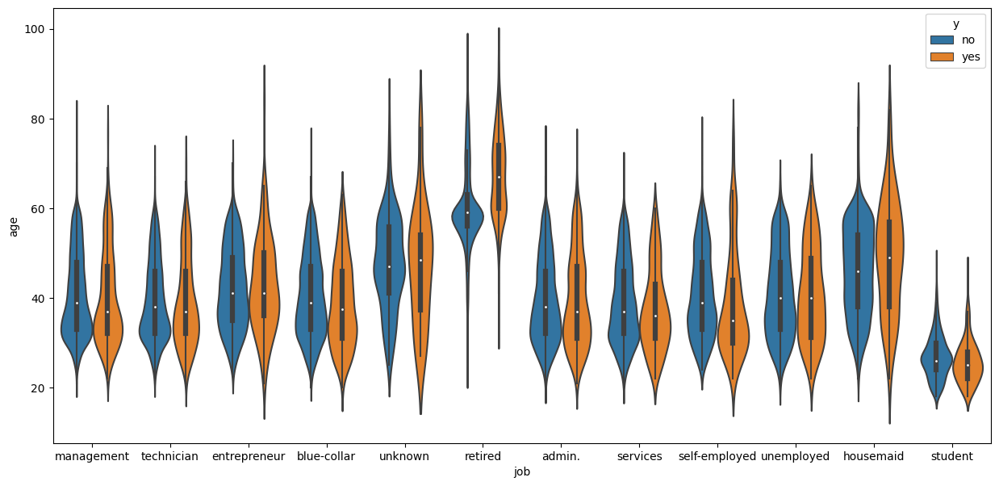

In [81]:
# violinplot for age vs job vs y
plt.figure(figsize=(15,7))
sns.violinplot(data=df, x="job", y="age", hue="y",split=False)

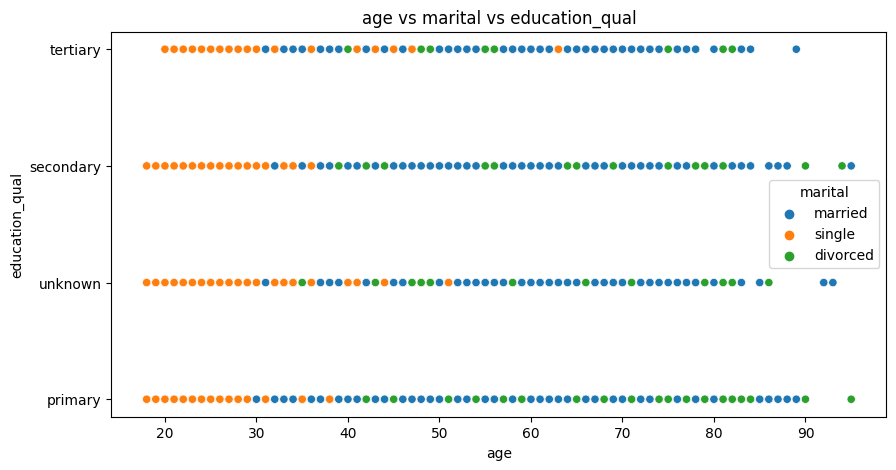

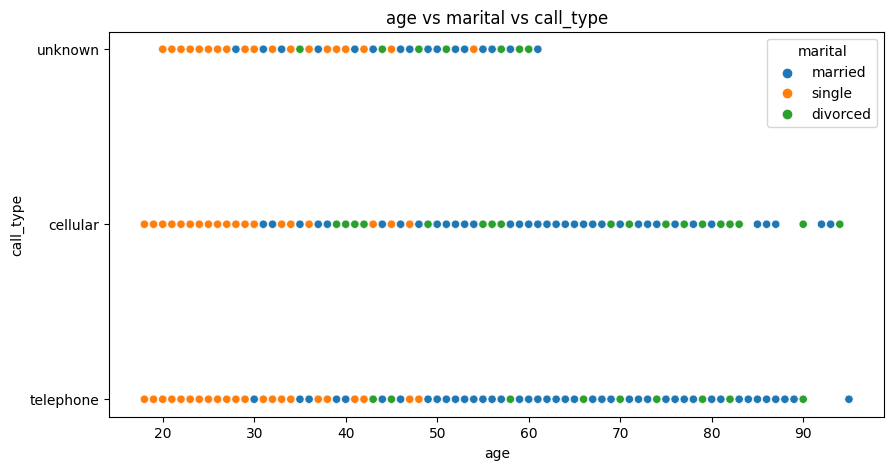

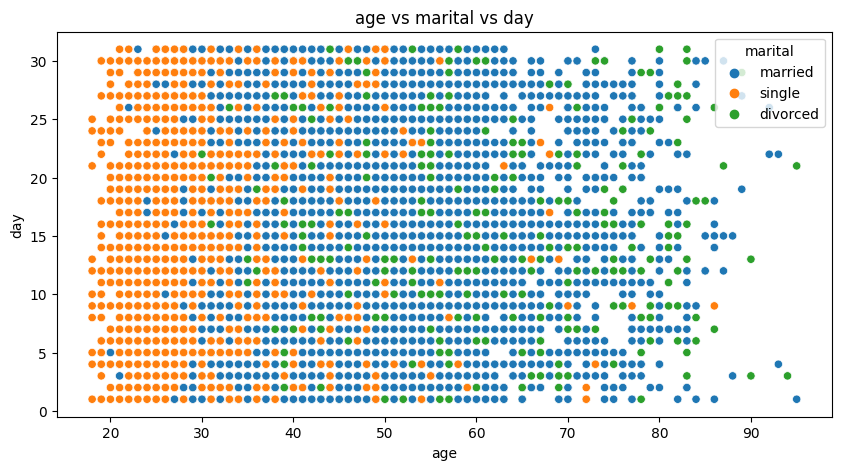

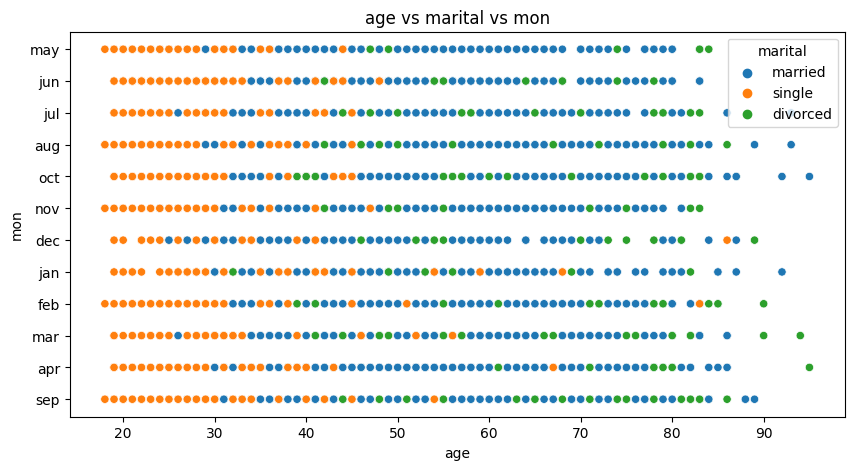

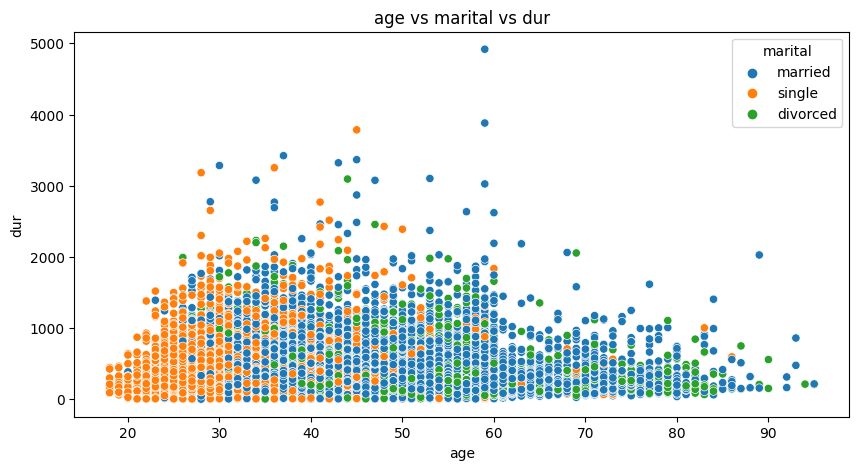

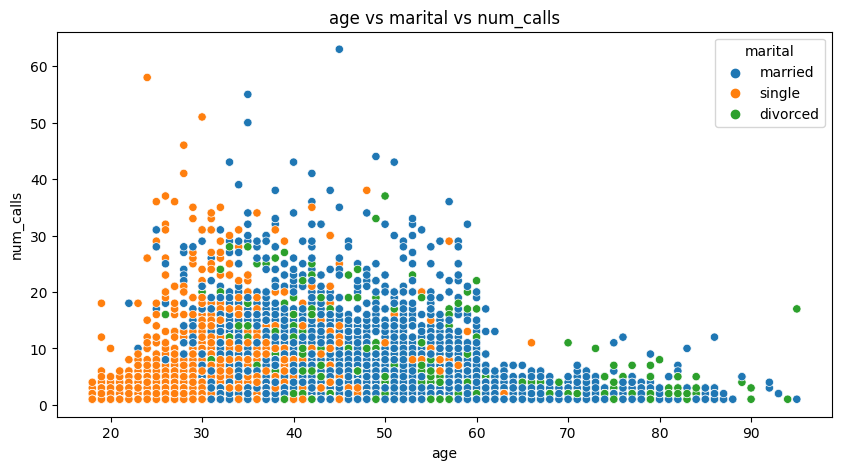

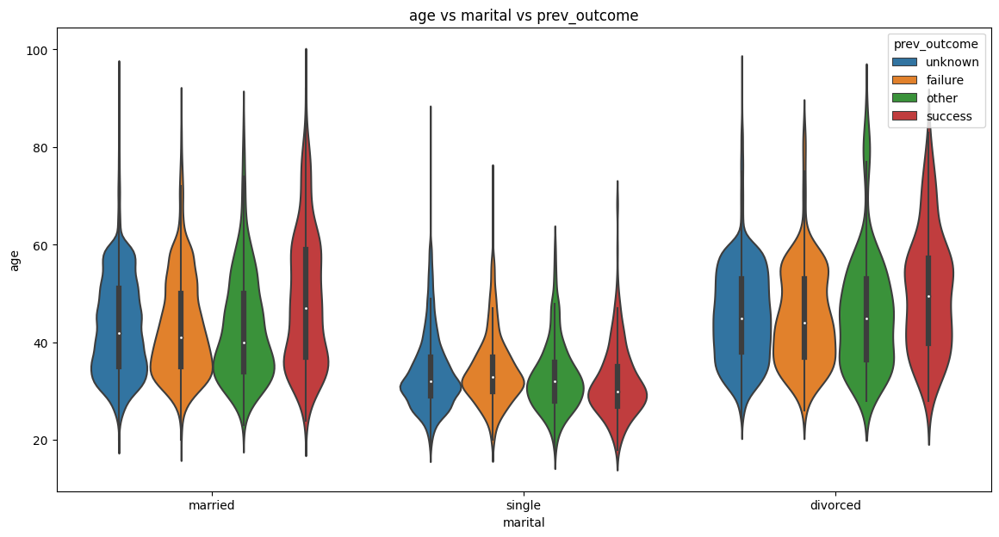

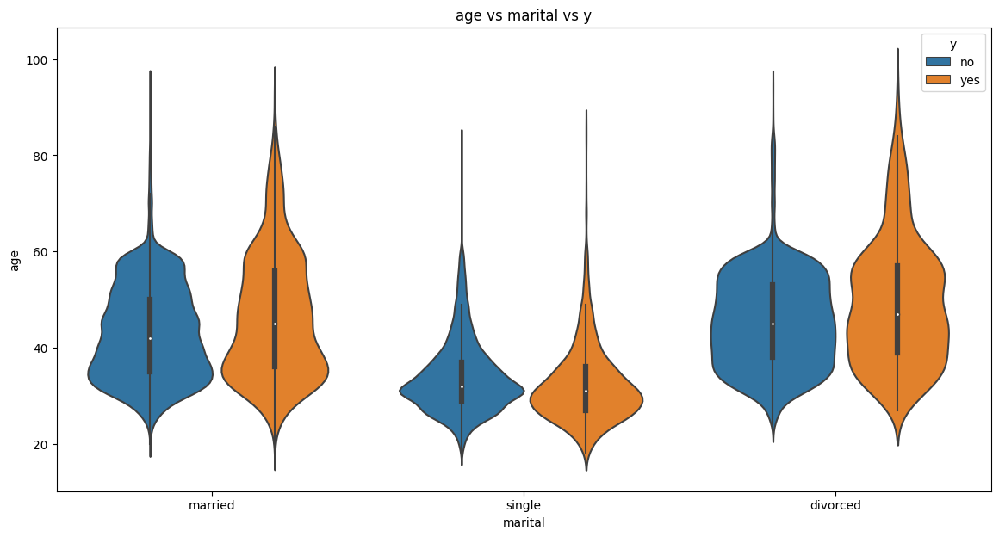

In [82]:
#scatter plot age vs marital vs['education_qual', 'call_type', 'day', 'mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['education_qual', 'call_type', 'day', 'mon',
          'dur', 'num_calls', 'prev_outcome', 'y']:
    if i =="prev_outcome" or i=="y":
        plt.figure(figsize=(14,7))
        plot=sns.violinplot(data=df, x="marital", y="age", hue=i,split=False)
        
        # Add title
        plot.set(title='age vs marital vs {}'.format(i))
        plt.show()
    else:
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="age",y=i,hue="marital")
        
        # Add title
        plot.set(title='age vs marital vs {}'.format(i))
        plt.show()

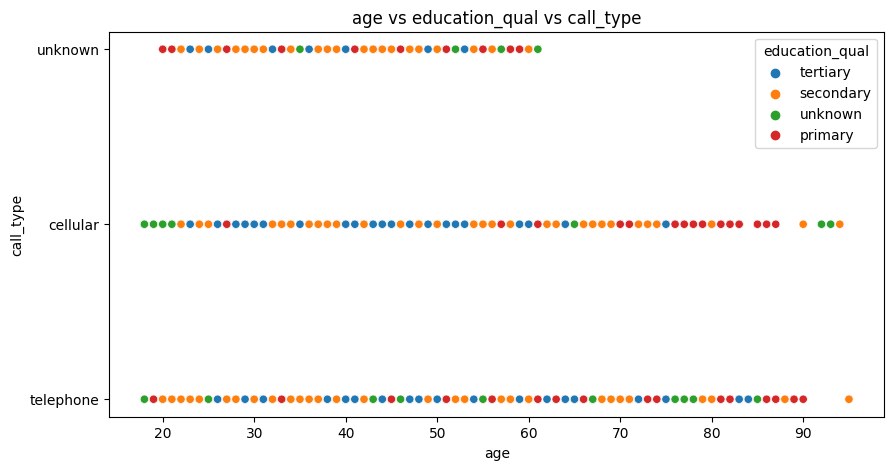

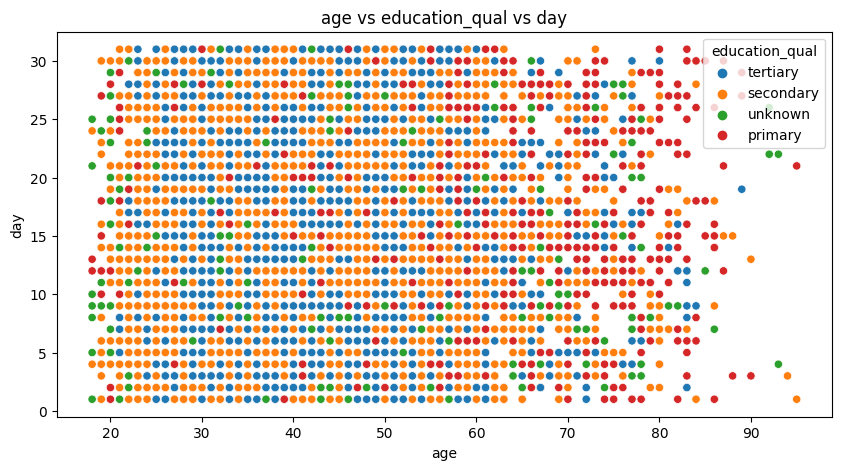

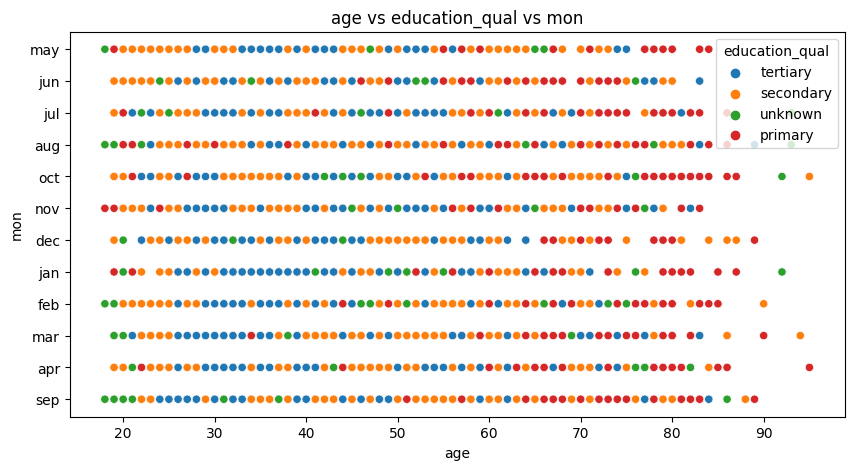

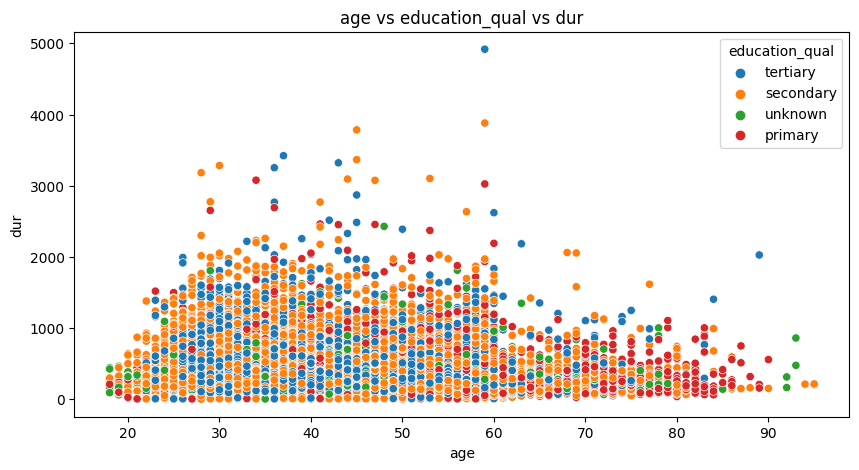

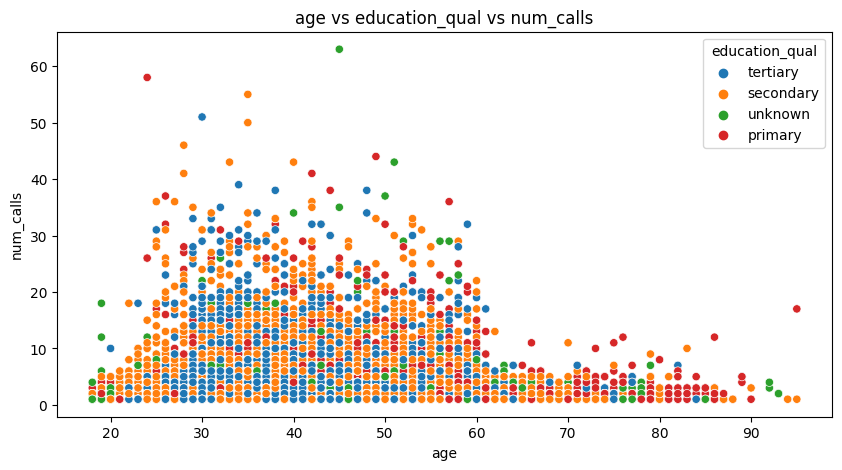

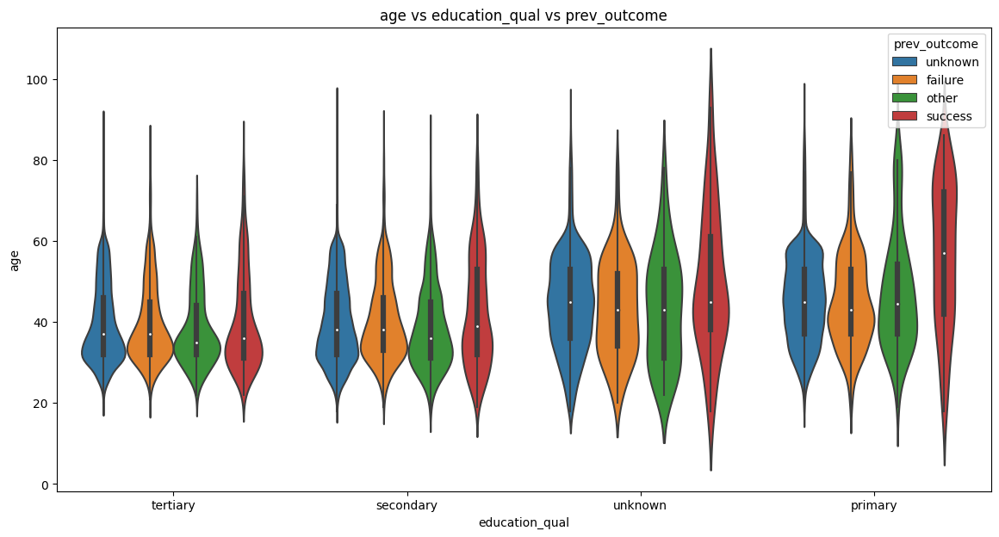

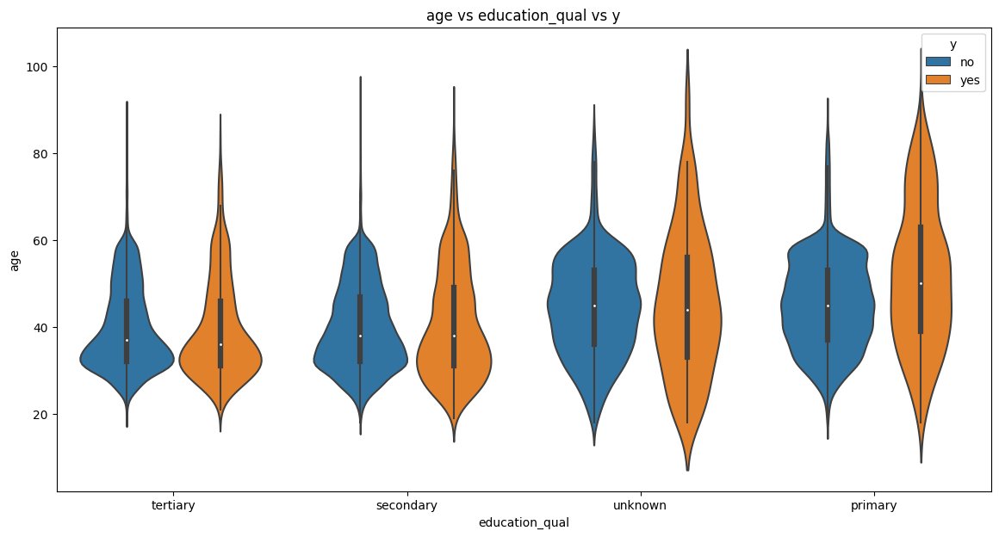

In [83]:
#scatter plot age vs education_qual vs['call_type', 'day', 'mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['call_type', 'day', 'mon',
          'dur', 'num_calls', 'prev_outcome', 'y']:
    if i =="prev_outcome" or i=="y":
        #violinplot
        
        plt.figure(figsize=(14,7))
        plot=sns.violinplot(data=df, x='education_qual', y="age", hue=i,split=False)
        
        # Add title
        
        plot.set(title='age vs education_qual vs {}'.format(i))
        plt.show()
    else:
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="age",y=i,hue='education_qual')
        
        # Add title
        
        plot.set(title='age vs education_qual vs {}'.format(i))
        plt.show()

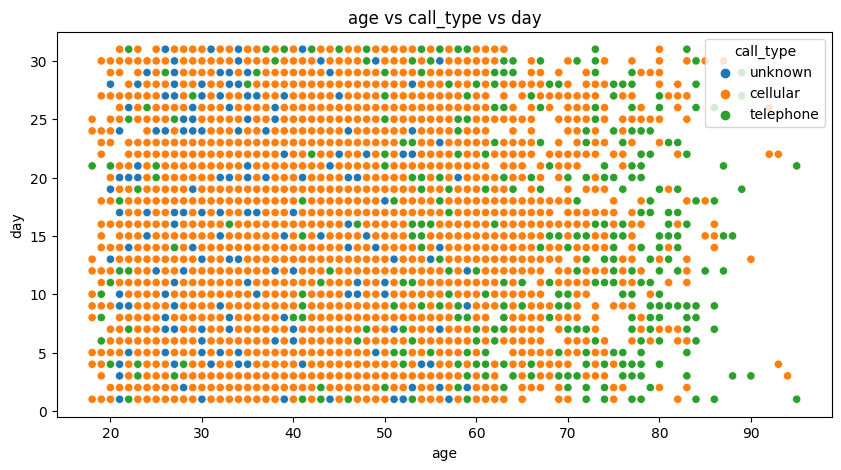

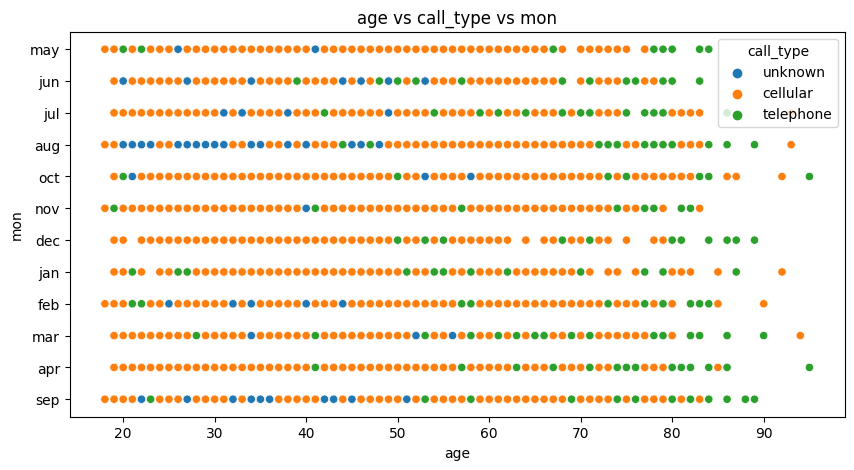

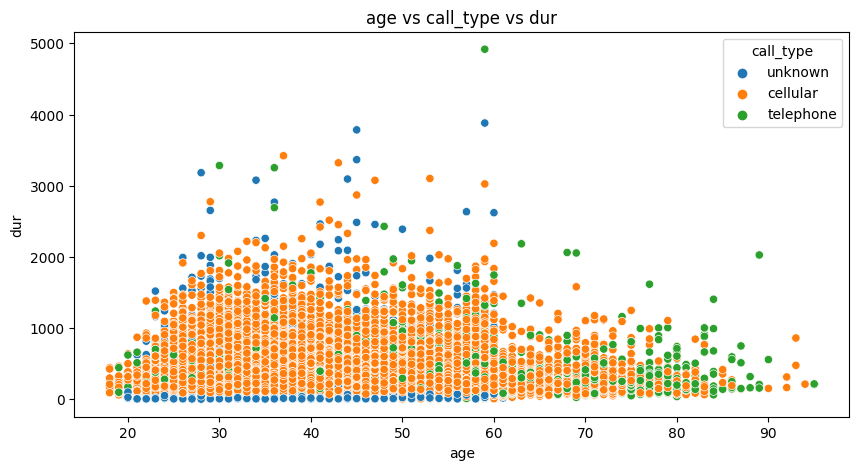

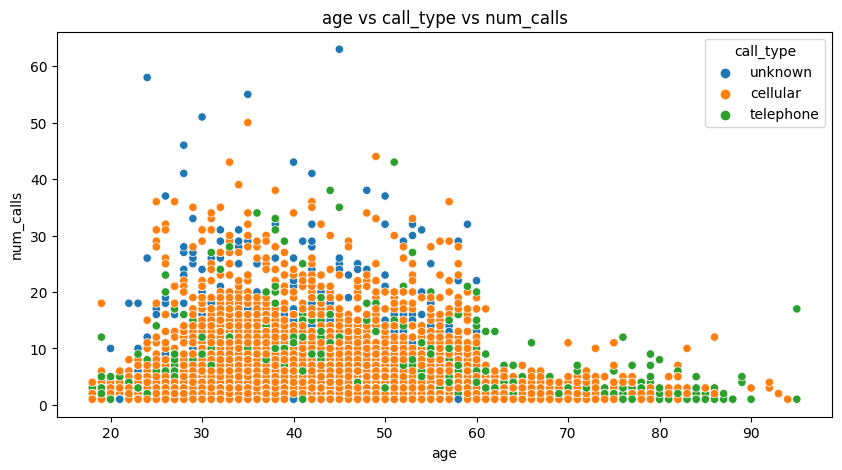

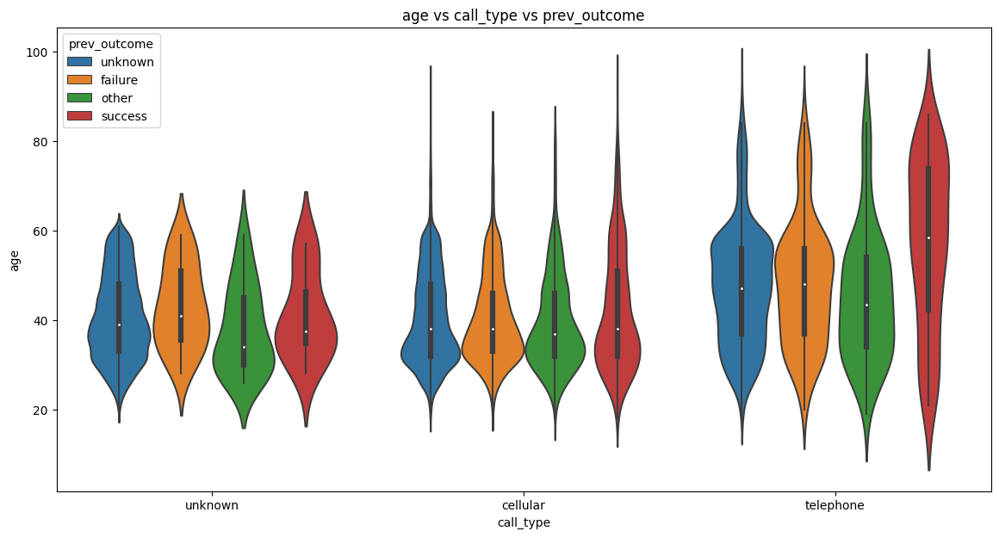

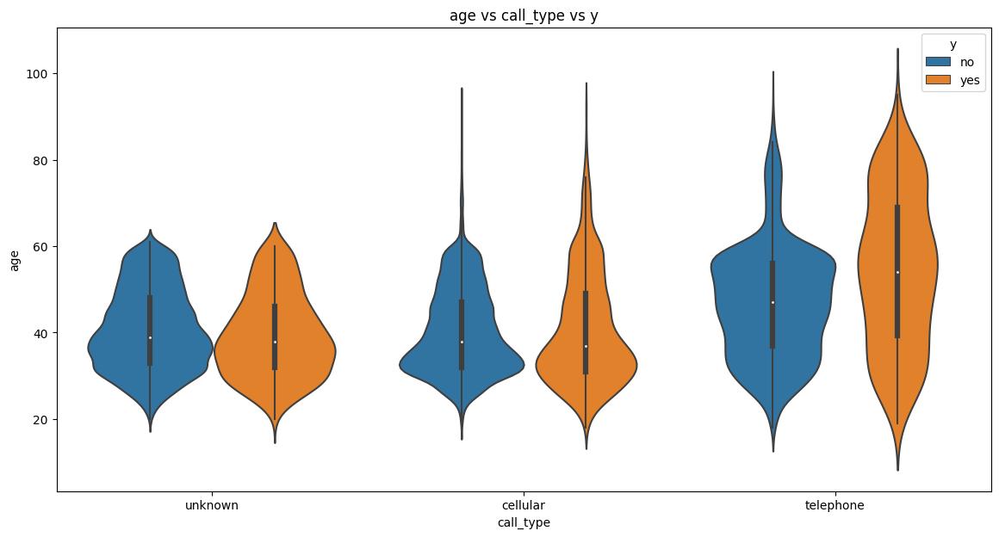

In [84]:
#scatter plot age vs call_type vs['day', 'mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['day', 'mon',
          'dur', 'num_calls', 'prev_outcome', 'y']:
    if i =="prev_outcome" or i=="y":
        #violinplot
        
        plt.figure(figsize=(14,7))
        plot=sns.violinplot(data=df, x='call_type', y="age", hue=i,split=False)
        
        # Add title
        
        plot.set(title='age vs call_type vs {}'.format(i))
        plt.show()
    else:
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="age",y=i,hue='call_type')
        
        # Add title
        
        plot.set(title='age vs call_type vs {}'.format(i))
        plt.show()

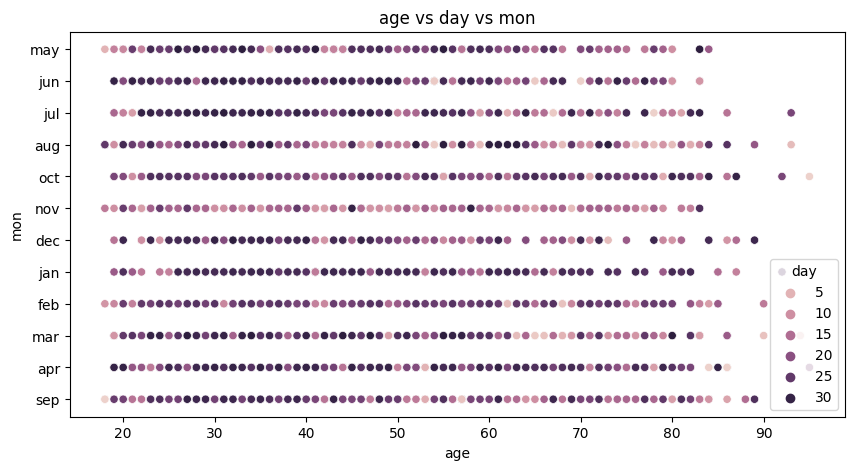

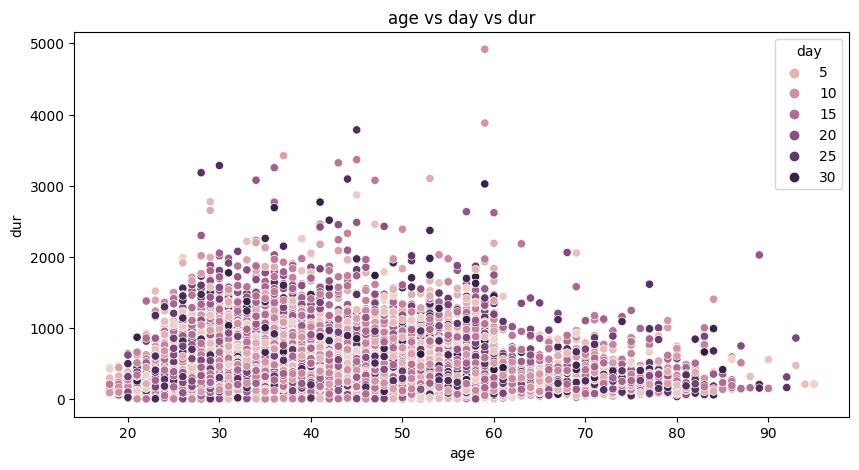

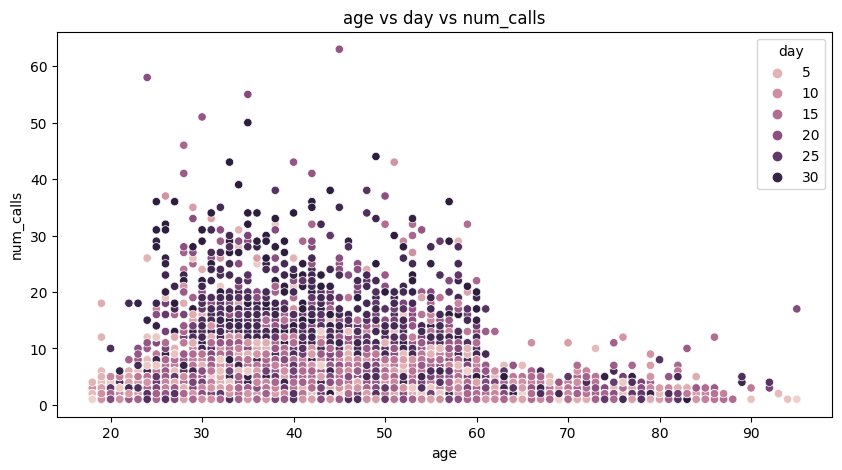

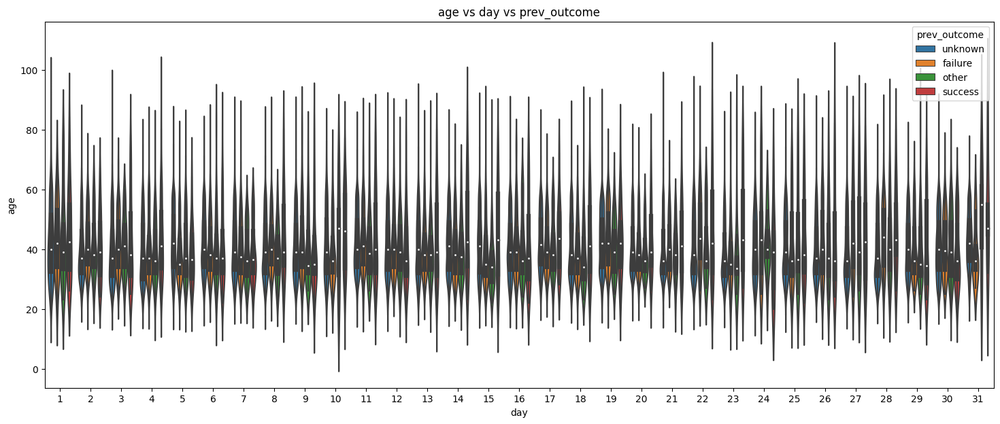

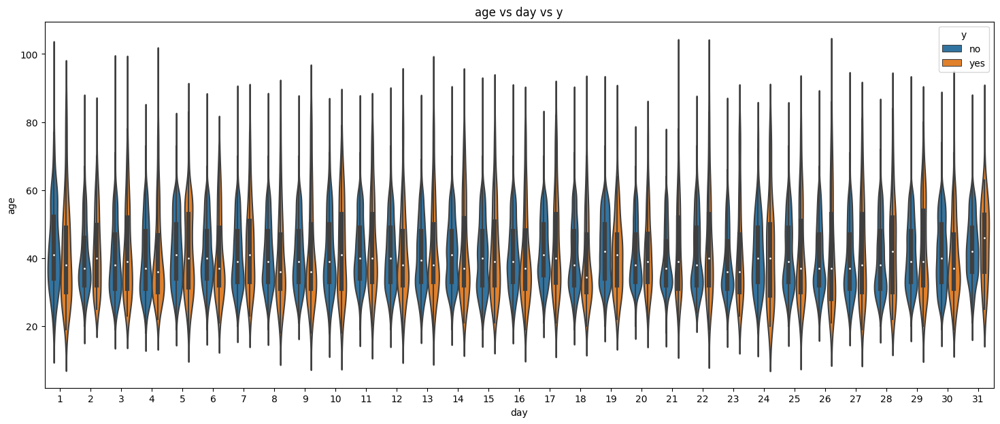

In [85]:
#scatter plot age vs day vs['mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['mon',
          'dur', 'num_calls', 'prev_outcome', 'y']:
    if i =="prev_outcome" or i=="y":
        #violinplot
        
        plt.figure(figsize=(18,7))
        plot=sns.violinplot(data=df, x='day', y="age", hue=i,split=False)
        
        # Add title
        
        plot.set(title='age vs day vs {}'.format(i))
        plt.show()
    else:
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="age",y=i,hue='day')
        
        # Add title
        
        plot.set(title='age vs day vs {}'.format(i))
        plt.show()

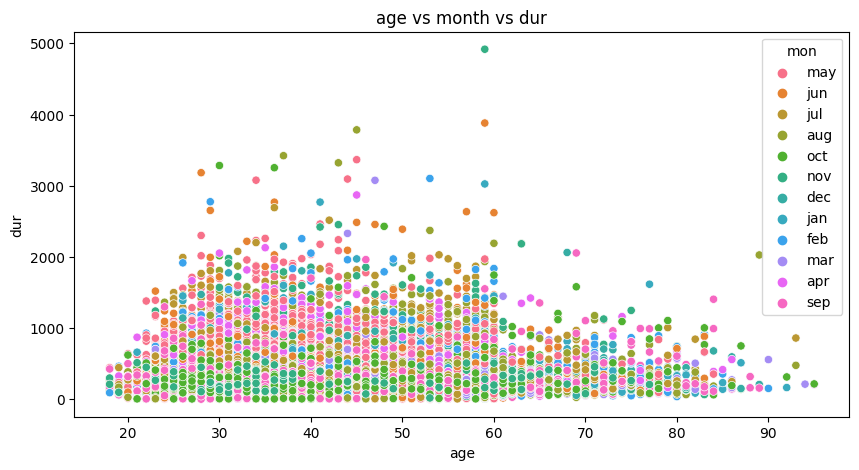

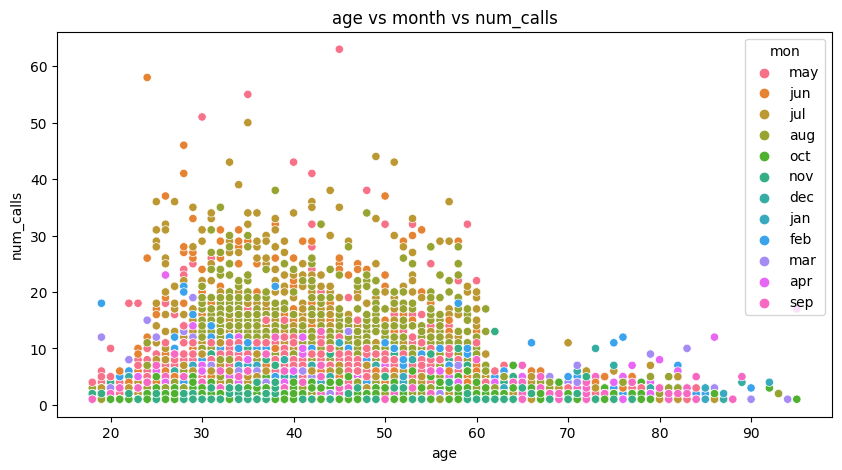

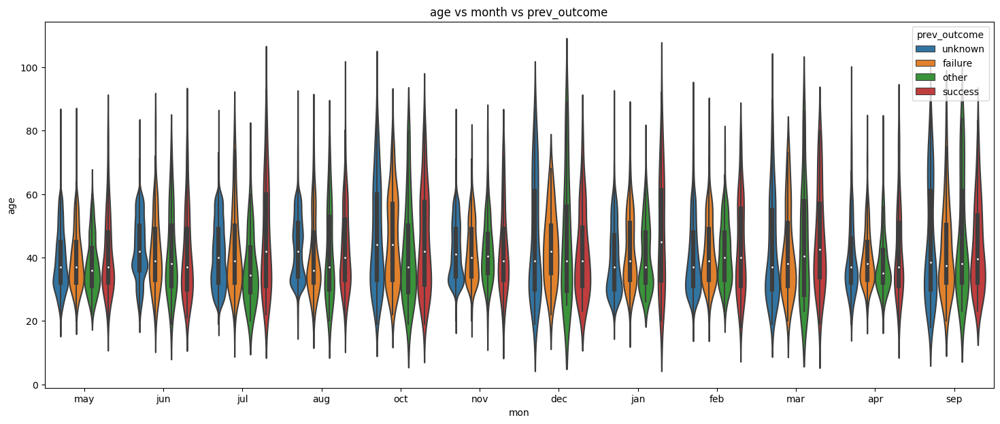

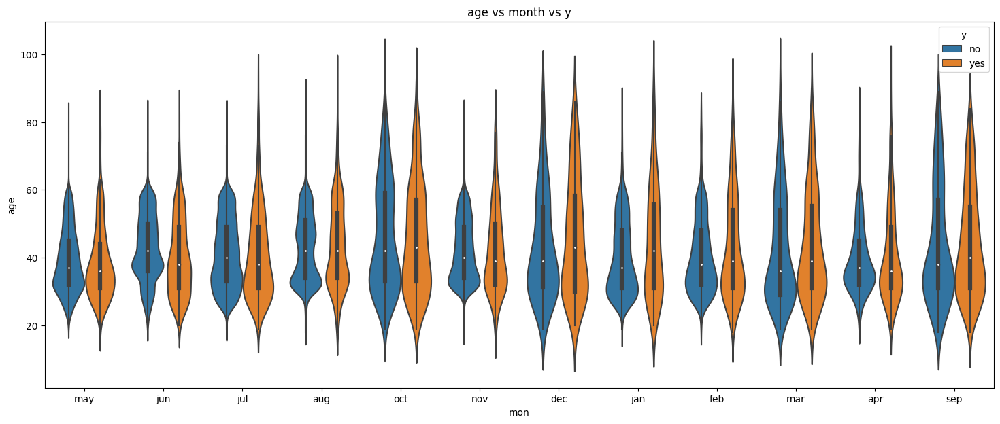

In [86]:
#scatter plot age vs mon vs['dur', 'num_calls', 'prev_outcome', 'y']

for i in ['dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="prev_outcome" or i=="y":
        #violinplot
        
        plt.figure(figsize=(18,7))
        plot=sns.violinplot(data=df, x='mon', y="age", hue=i,split=False)
        
        # Add title
        
        plot.set(title='age vs month vs {}'.format(i))
        plt.show()
        
    else:
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="age",y=i,hue='mon')
        
        # Add title
        
        plot.set(title='age vs month vs {}'.format(i))
        plt.show()

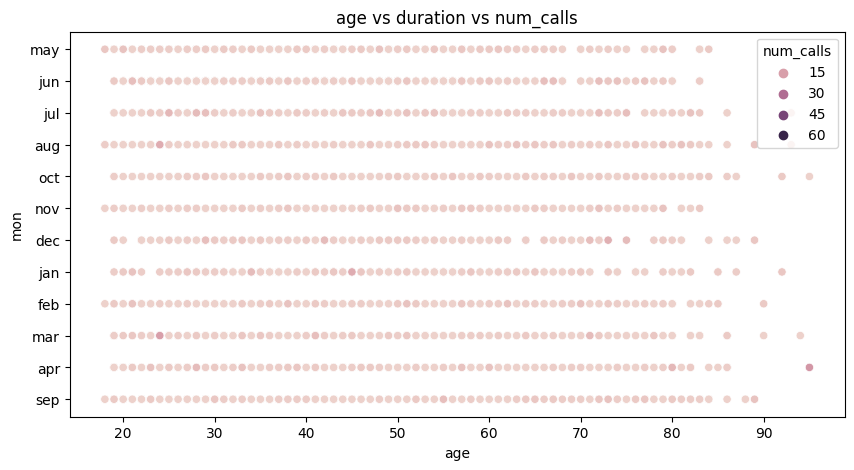

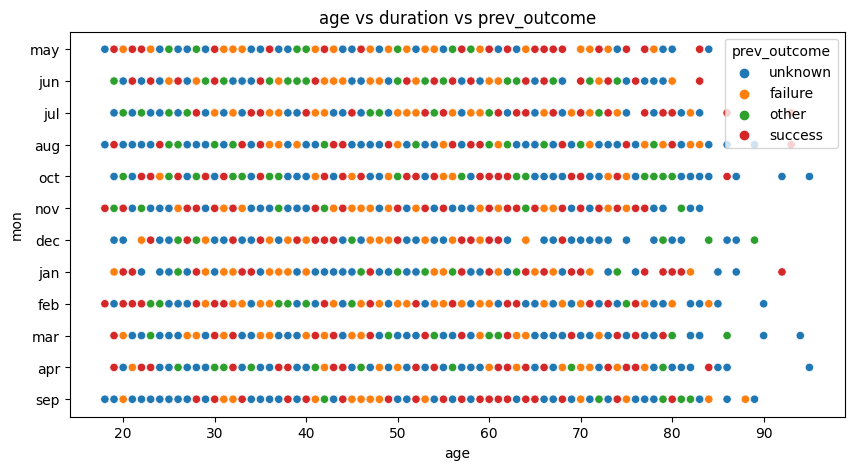

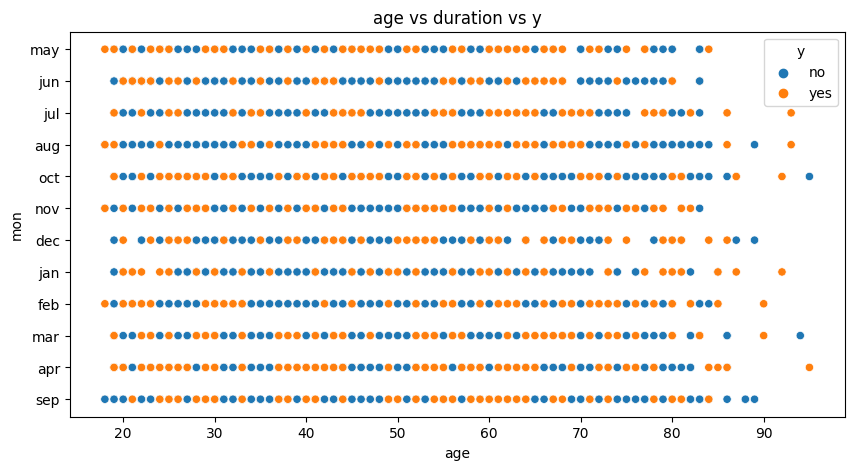

In [87]:
#scatter plot age vs dur vs['num_calls', 'prev_outcome', 'y']

for i in ['num_calls', 'prev_outcome', 'y']:
    
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="age",hue=i,y='mon')
        
        # Add title
        
        plot.set(title='age vs duration vs {}'.format(i))
        plt.show()

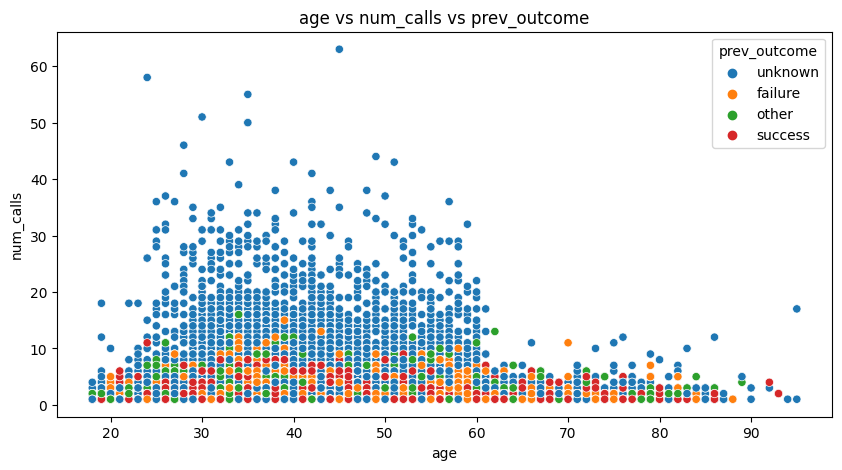

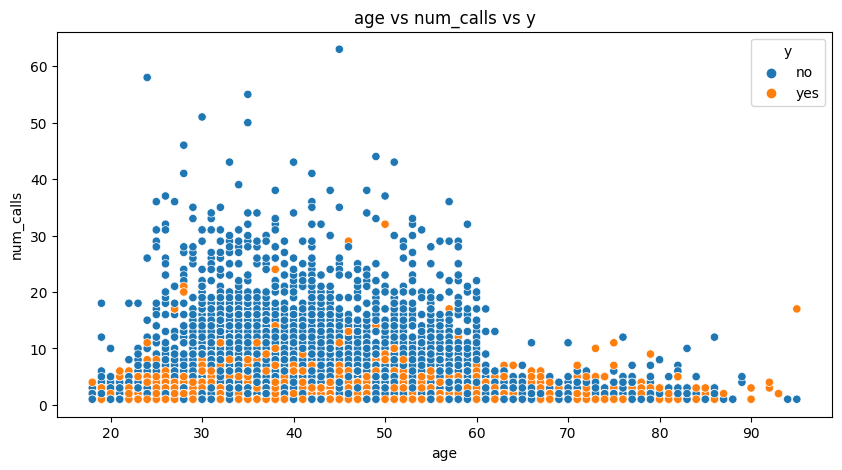

In [88]:
#scatter plot age vs num_calls vs['prev_outcome', 'y']

for i in ['prev_outcome', 'y']:
    
    
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="age",hue=i,y='num_calls')
        
        # Add title
        
        plot.set(title='age vs num_calls vs {}'.format(i))
        plt.show()

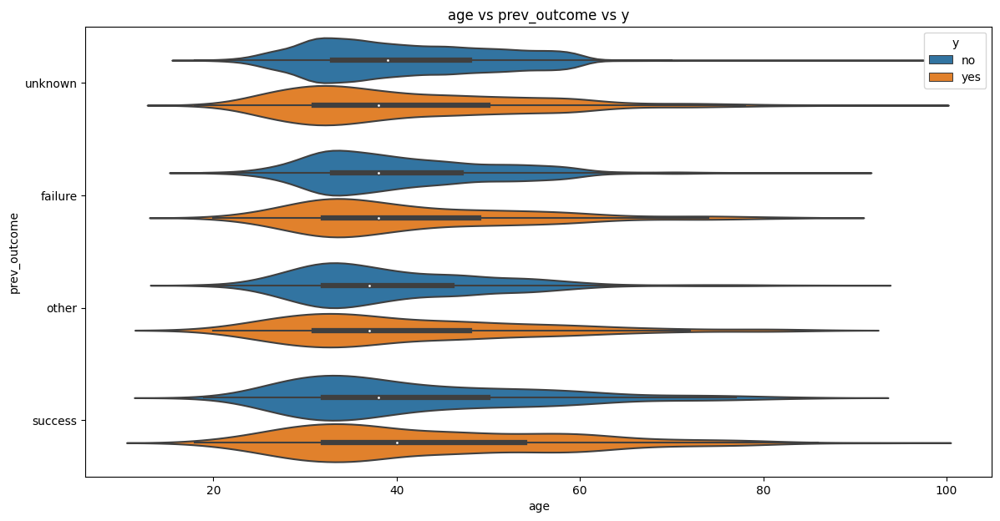

In [89]:
#violinplot age vs prev_outcome vs y

        
plt.figure(figsize=(14,7))
plot=sns.violinplot(data=df, x='age', y="prev_outcome", hue="y",split=False)
        
# Add title
        
plot.set(title='age vs prev_outcome vs y')
plt.show()

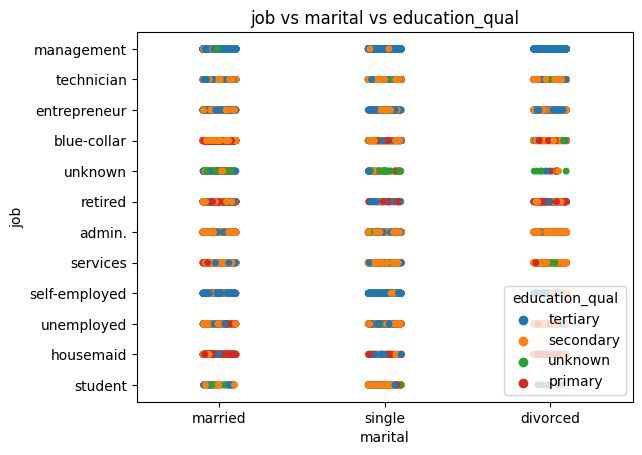

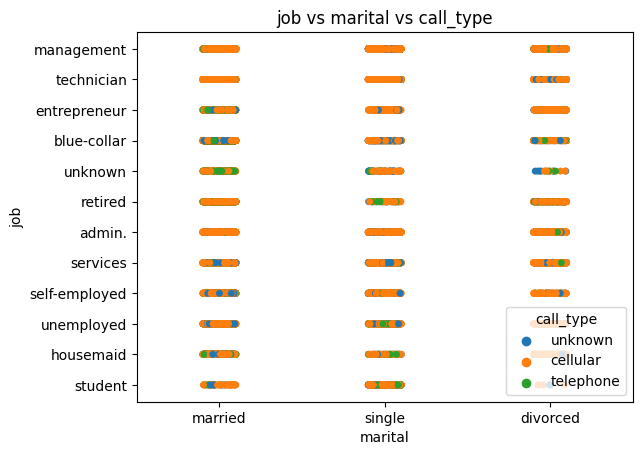

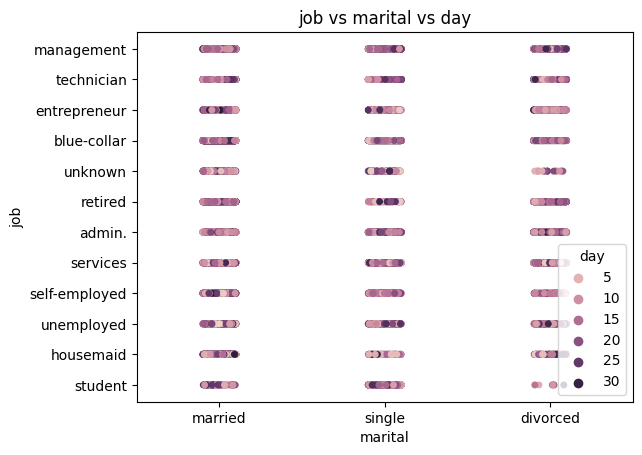

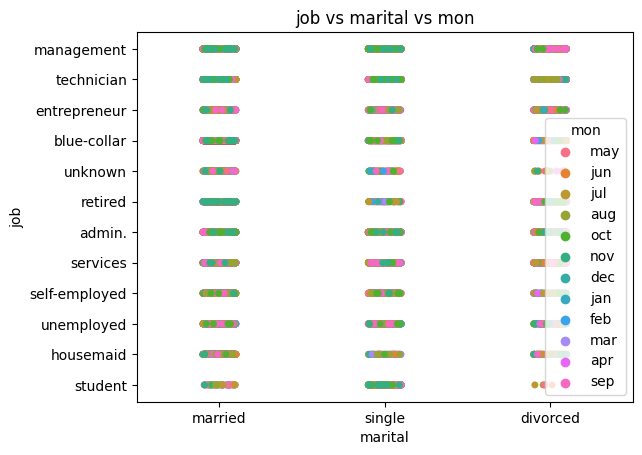

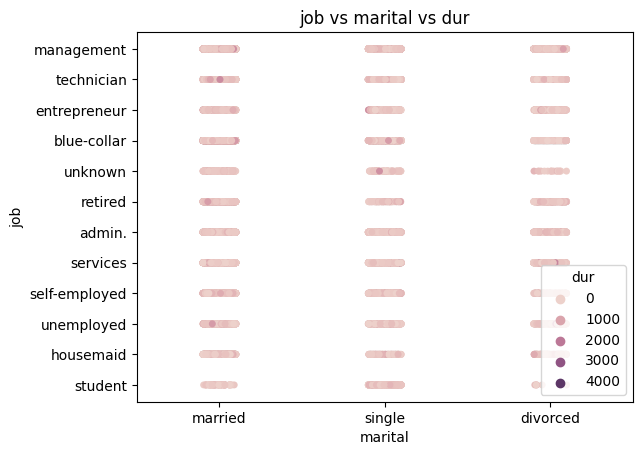

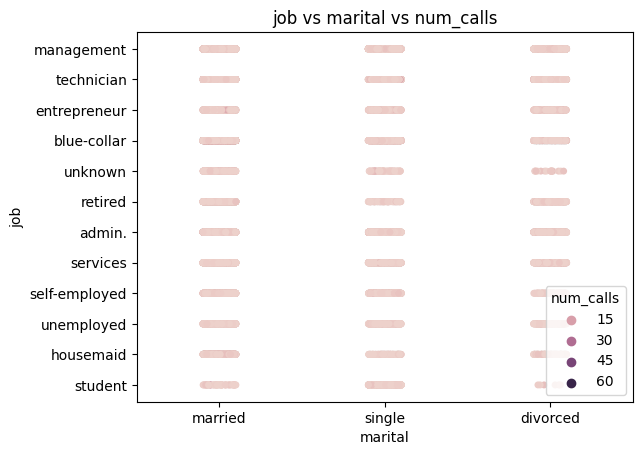

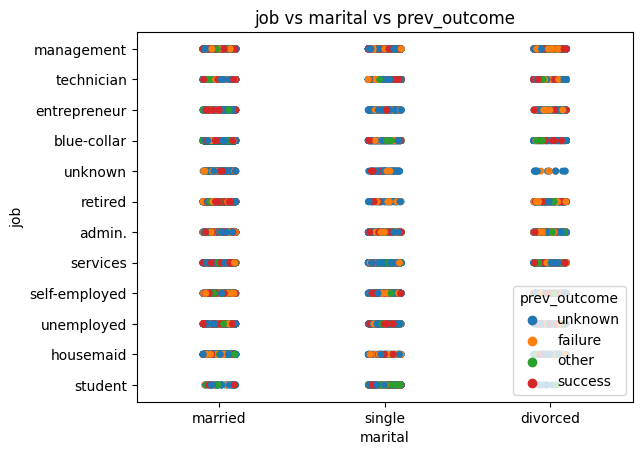

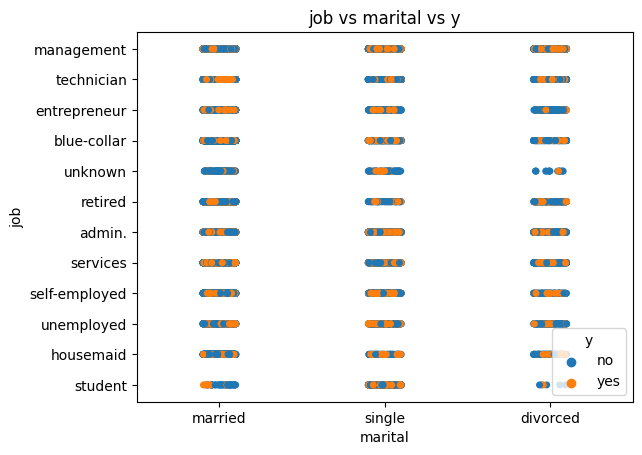

In [90]:
#scatter plot job vs marital vs['education_qual', 'call_type', 'day', 'mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['education_qual', 'call_type', 'day', 'mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i !="dur" or i!="num_calls":
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, y='job', x="marital", hue=i)
        
        # Add title
        
        plot.set(title='job vs marital vs {}'.format(i))
        plt.show()
        
    else:
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="job",y=i,hue='mon')
        
        # Add title
        
        plot.set(title='job vs marital vs {}'.format(i))
        plt.show()

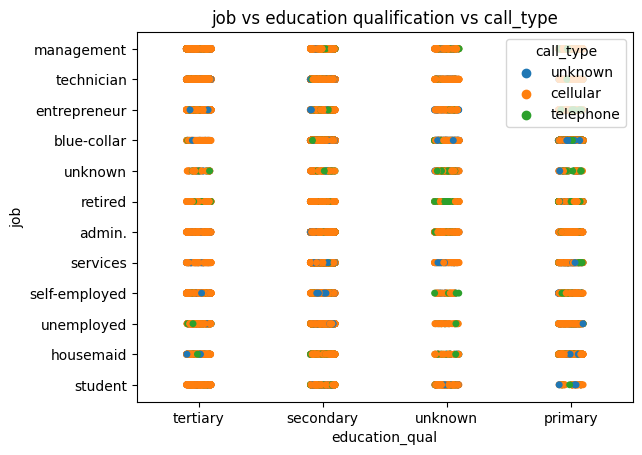

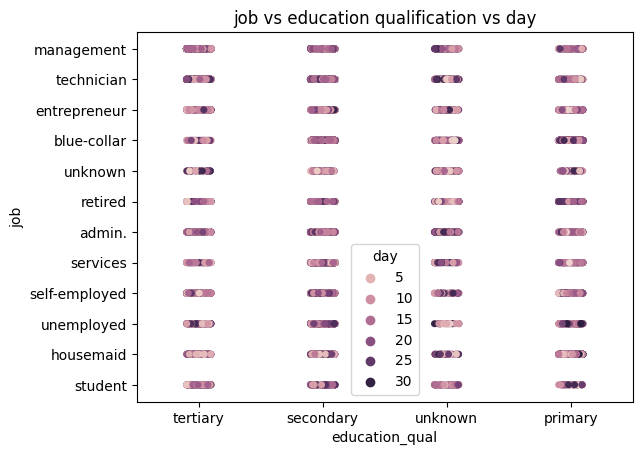

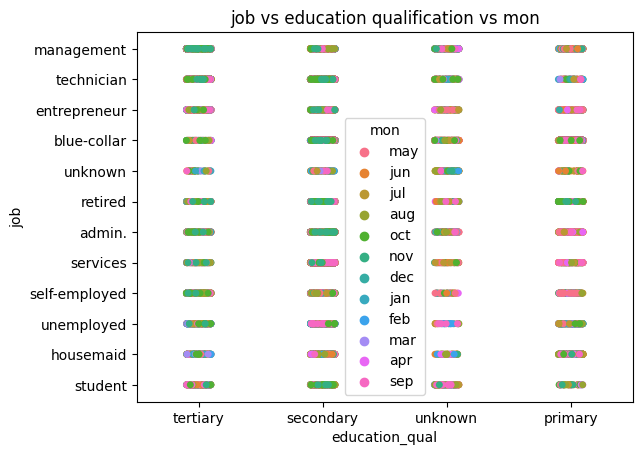

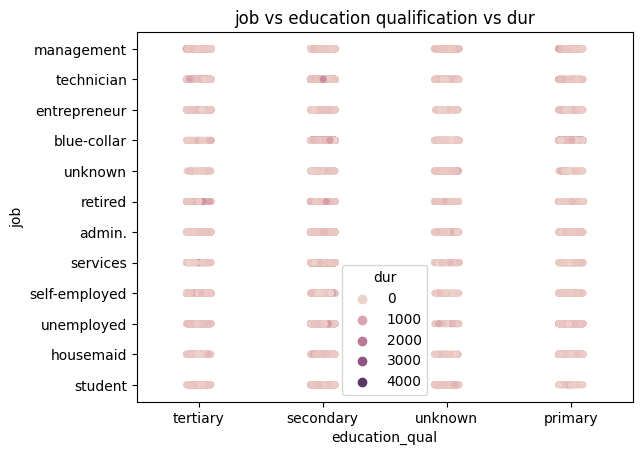

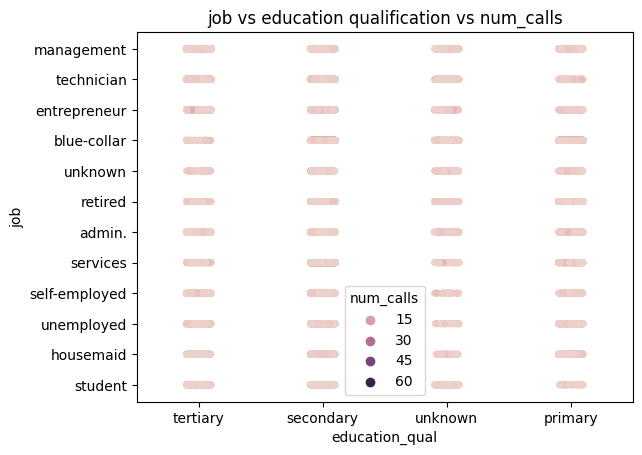

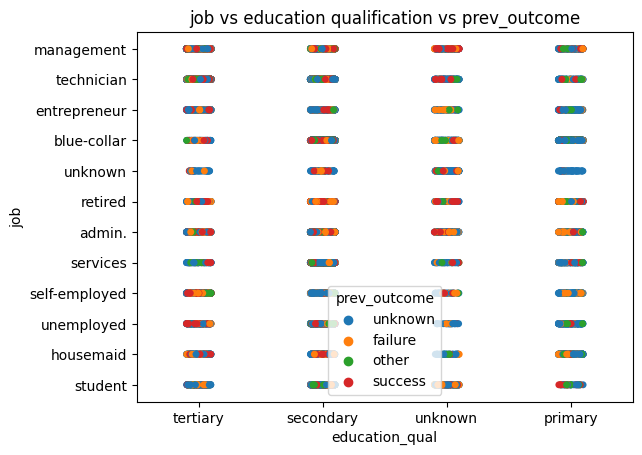

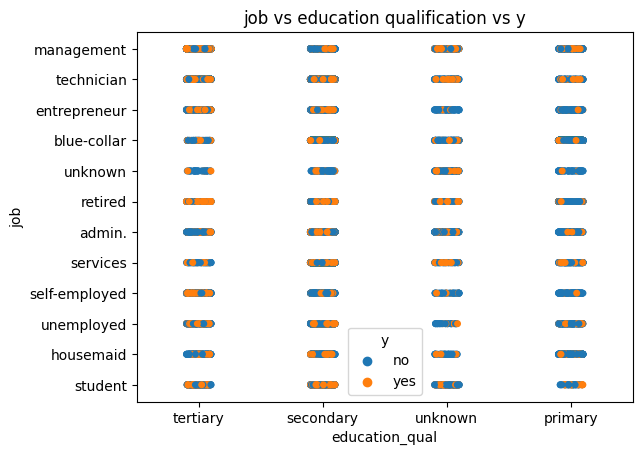

In [91]:
#scatter plot job vs education_qual vs['call_type', 'day', 'mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['call_type', 'day', 'mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i !="dur" or i!="num_calls":
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, y='job', x="education_qual", hue=i)
        
        # Add title
        
        plot.set(title='job vs education qualification vs {}'.format(i))
        plt.show()
        
    else:
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="job",y=i,hue='education_qual')
        
        # Add title
        
        plot.set(title='job vs education qualification vs {}'.format(i))
        plt.show()

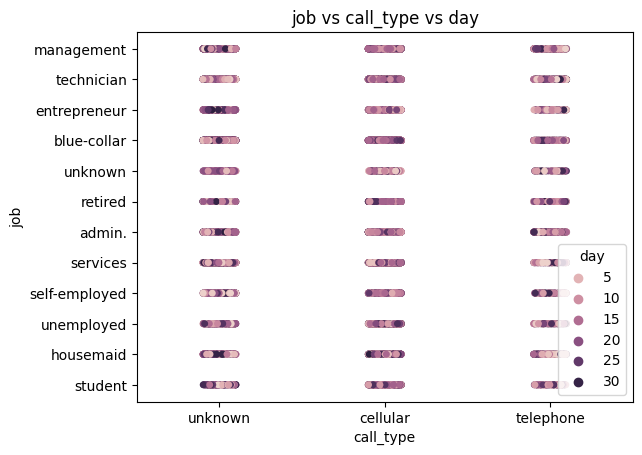

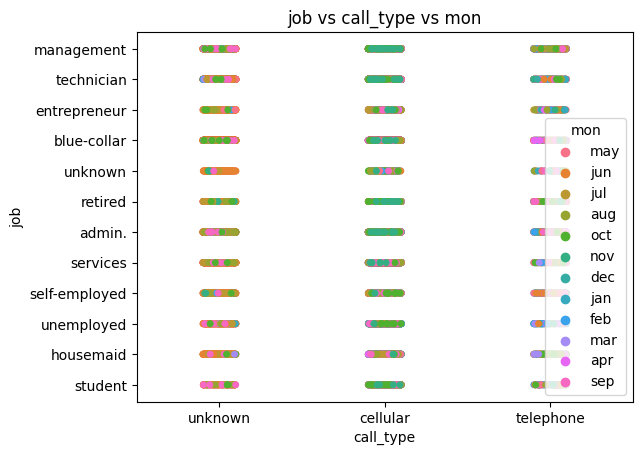

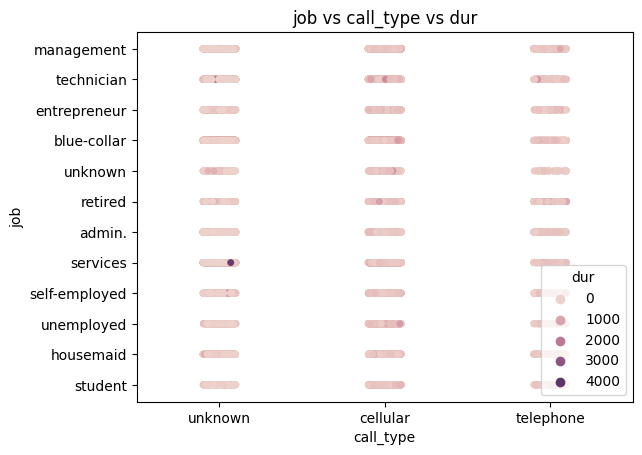

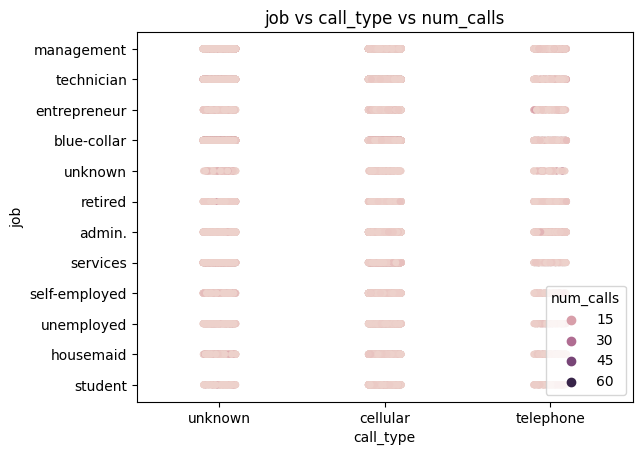

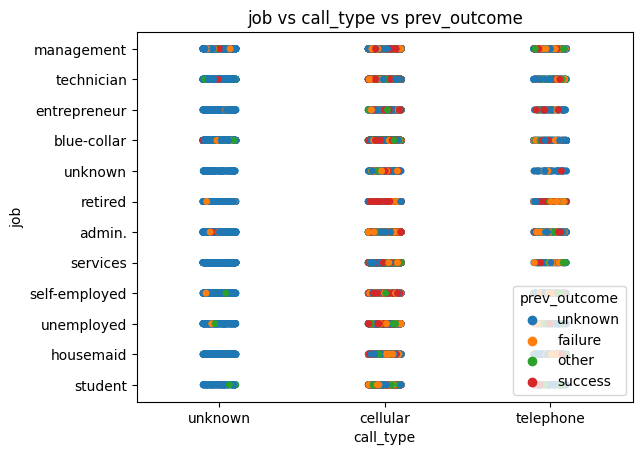

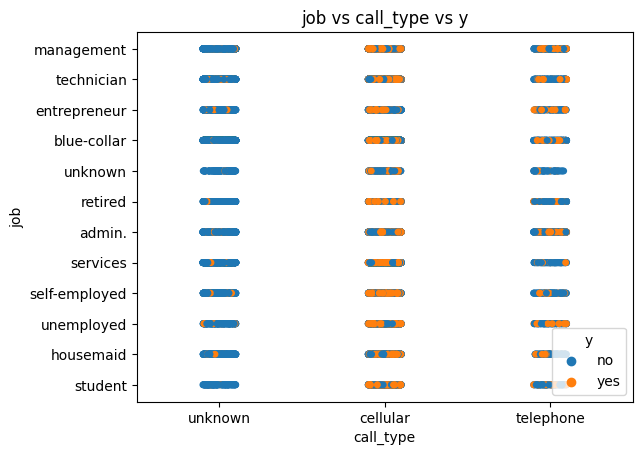

In [92]:
#scatter plot job vs call_type vs['day', 'mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['day', 'mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i !="dur" or i!="num_calls":
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, y='job', x="call_type", hue=i)
        
        # Add title
        
        plot.set(title='job vs call_type vs {}'.format(i))
        plt.show()
        
    else:
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="job",y=i,hue='call_type')
        
        # Add title
        
        plot.set(title='job vs call_type vs {}'.format(i))
        plt.show()

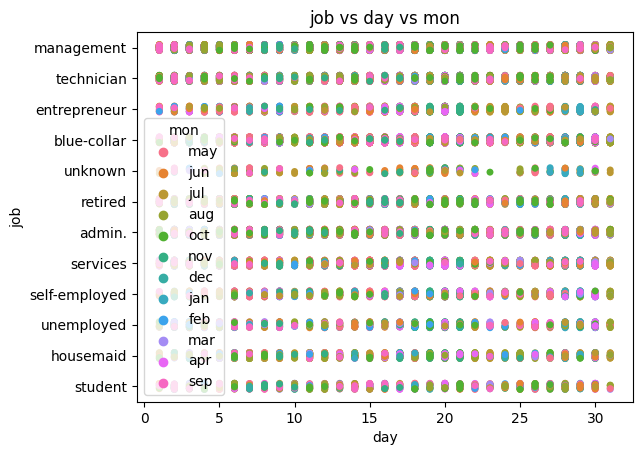

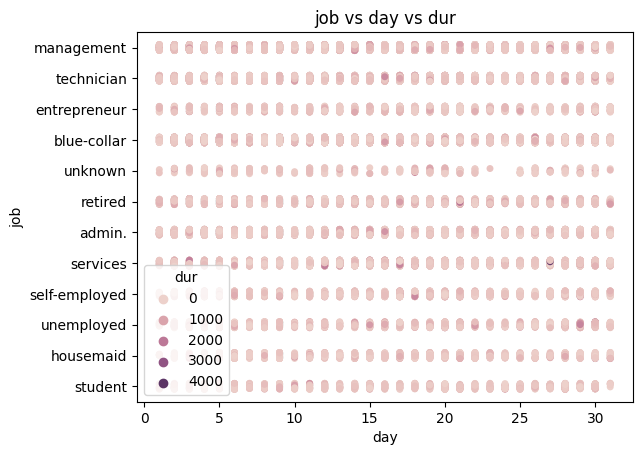

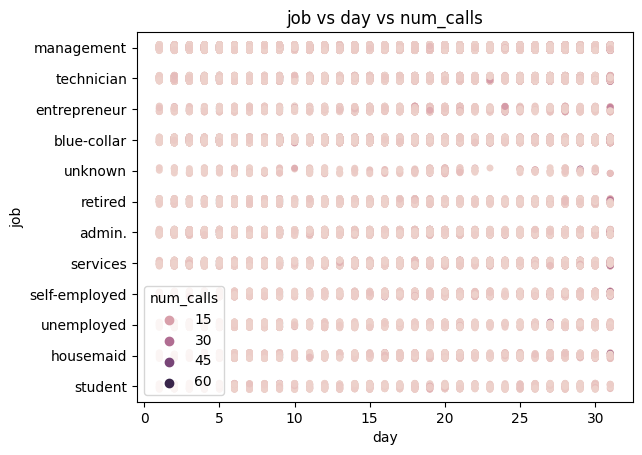

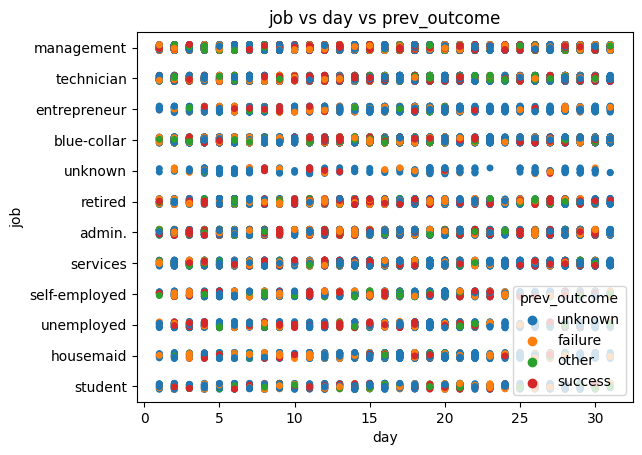

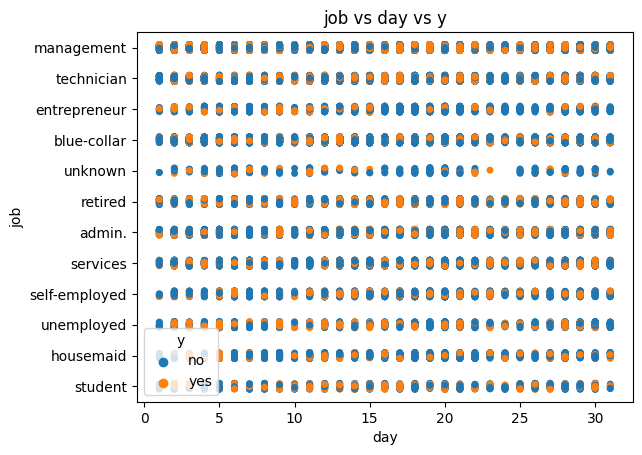

In [93]:
#scatter plot job vs day vs['mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i !="dur" or i!="num_calls":
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, y='job', x="day", hue=i)
        
        # Add title
        
        plot.set(title='job vs day vs {}'.format(i))
        plt.show()
        
    else:
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="job",y=i,hue='day')
        
        # Add title
        
        plot.set(title='job vs day vs {}'.format(i))
        plt.show()

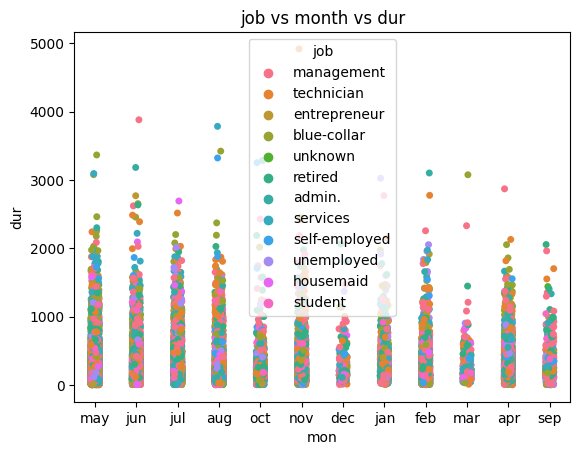

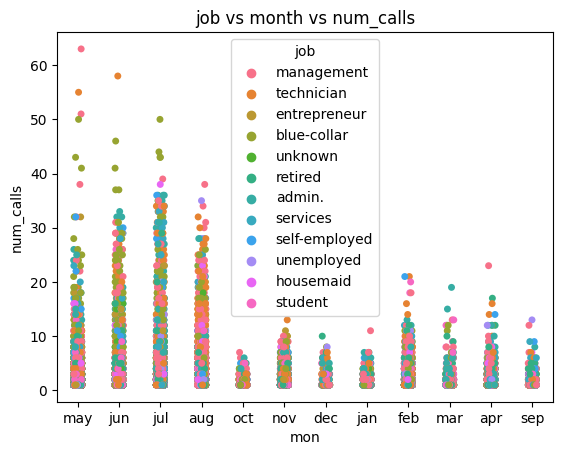

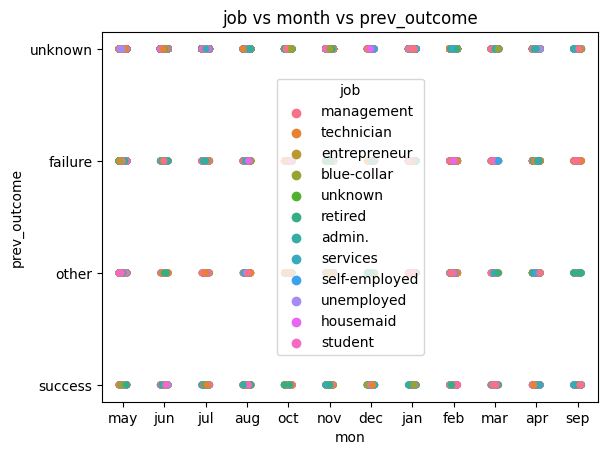

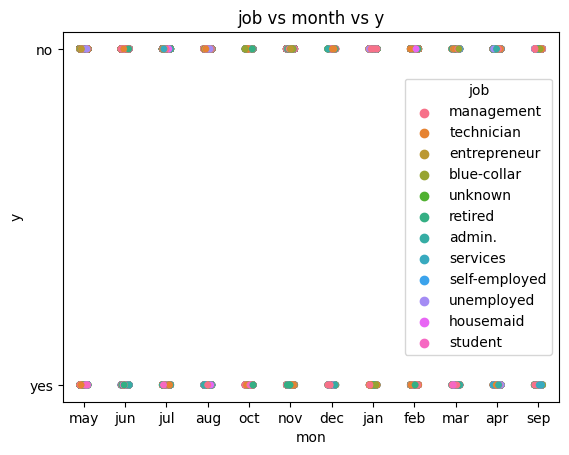

In [94]:
#scatter plot job vs mon vs['dur', 'num_calls', 'prev_outcome', 'y']

for i in ['dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i !="dur" or i!="num_calls":
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, hue='job', x="mon", y=i)
        
        # Add title
        
        plot.set(title='job vs month vs {}'.format(i))
        plt.show()
        
    else:
        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="job",hue=i,y='mon')
        
        # Add title
        
        plot.set(title='job vs month vs {}'.format(i))
        plt.show()

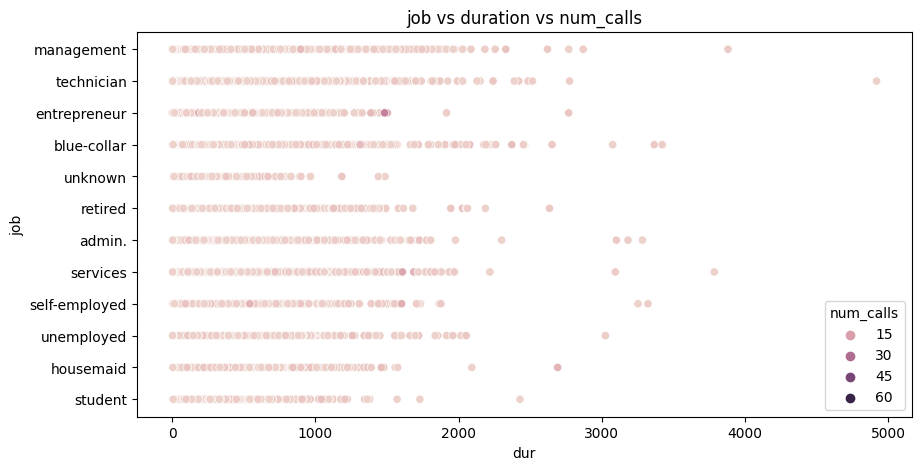

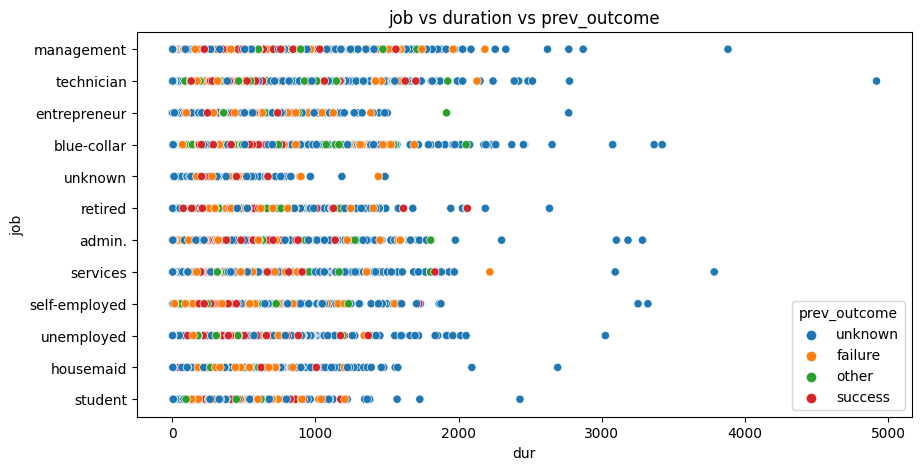

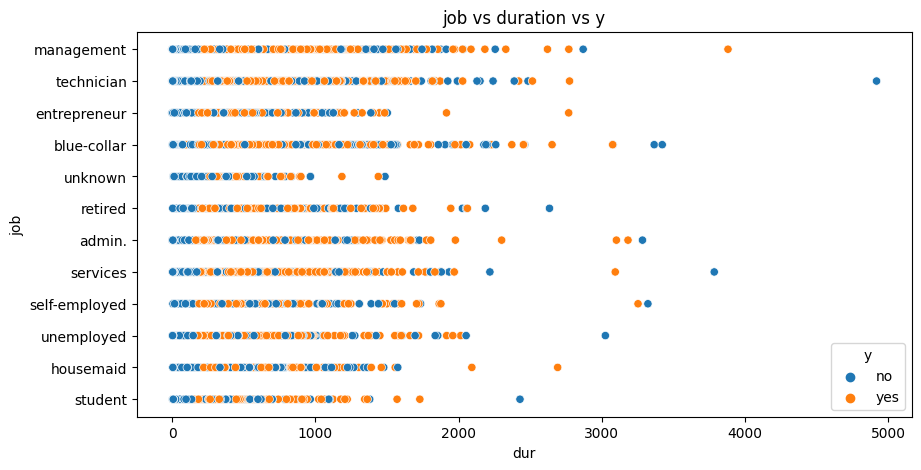

In [95]:
#scatter plot job vs duration vs['num_calls', 'prev_outcome', 'y']

for i in ['num_calls', 'prev_outcome', 'y']:
    

        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,y="job",hue=i,x='dur')
        
        # Add title
        
        plot.set(title='job vs duration vs {}'.format(i))
        plt.show()

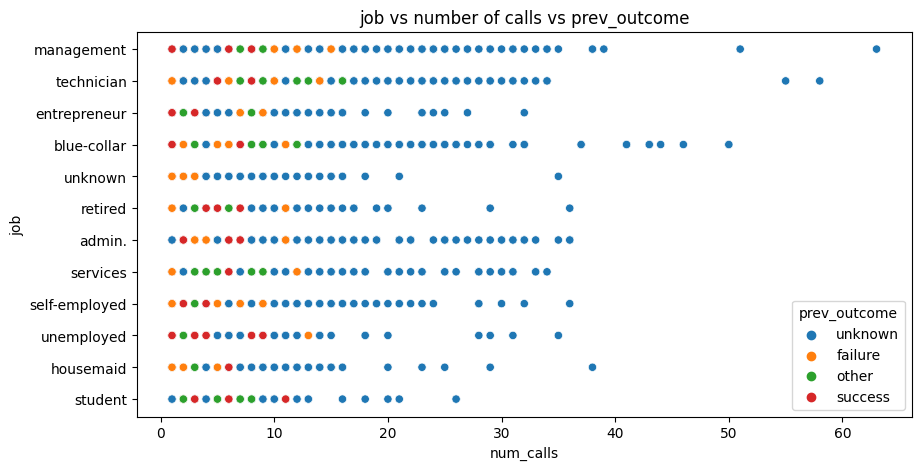

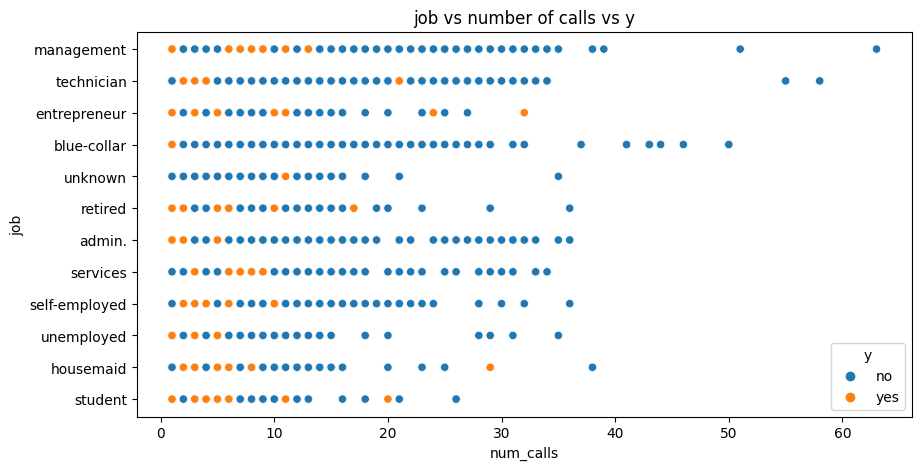

In [96]:
#scatter plot job vs num_calls vs['prev_outcome', 'y']

for i in ['prev_outcome', 'y']:
    

        #scatterplot
        
        plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,y="job",hue=i,x='num_calls')
        
        # Add title
        
        plot.set(title='job vs number of calls vs {}'.format(i))
        plt.show()

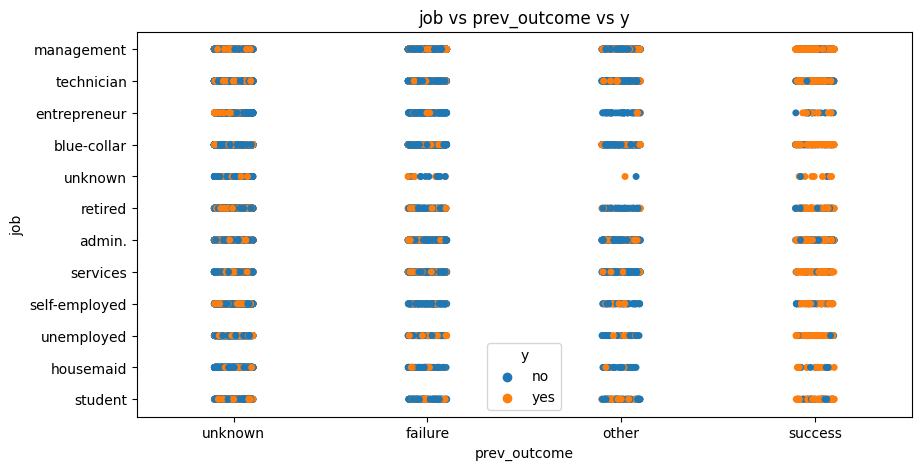

In [97]:
#stripplot for job vs prev_outcome vs y
plt.figure(figsize=(10,5))
plot=sns.stripplot(data=df,y="job",hue="y",x='prev_outcome')
        
# Add title
        
plot.set(title='job vs prev_outcome vs y')
plt.show()

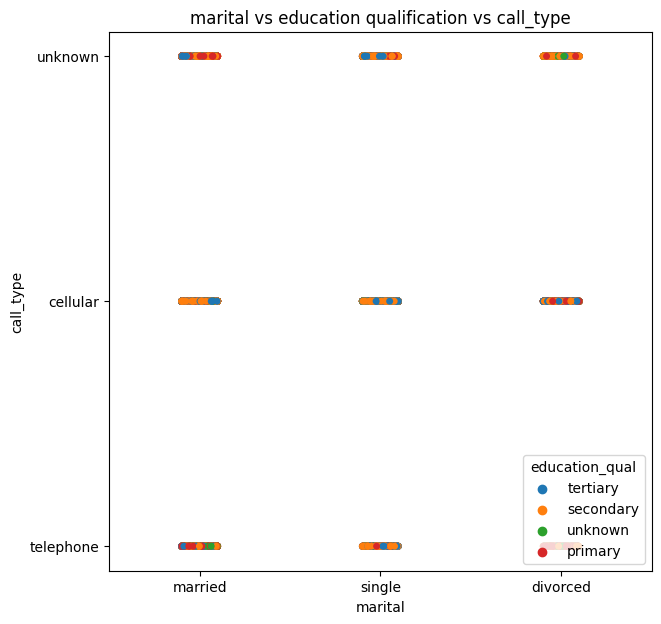

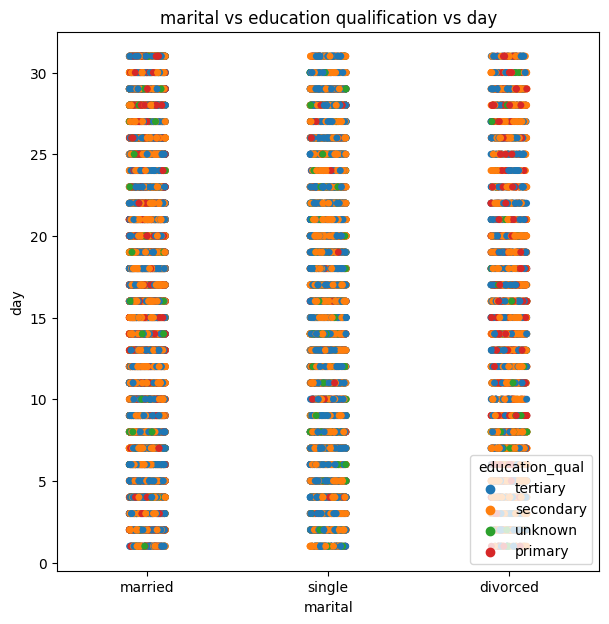

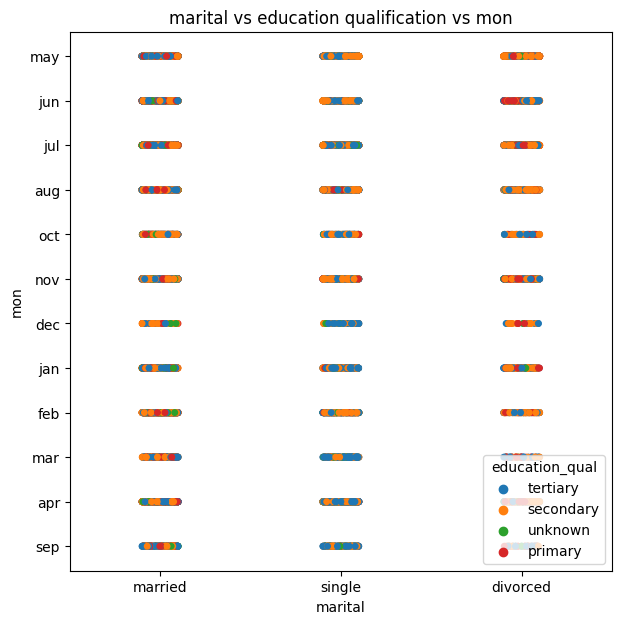

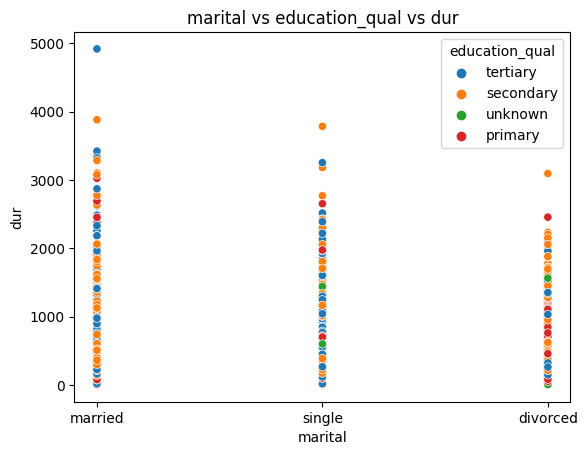

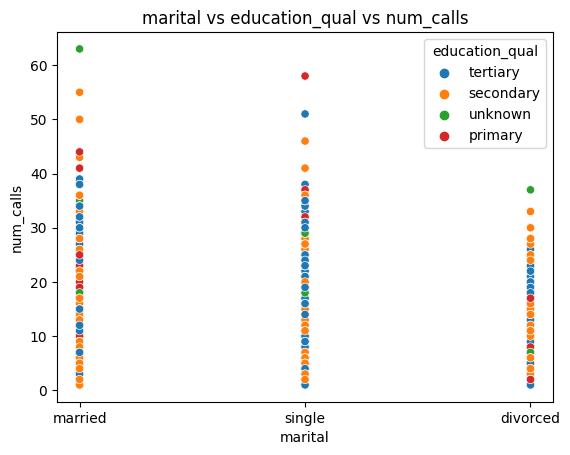

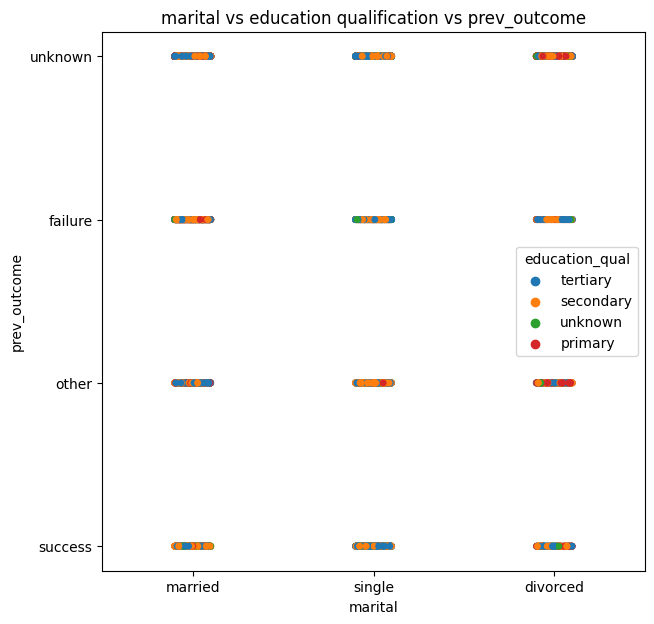

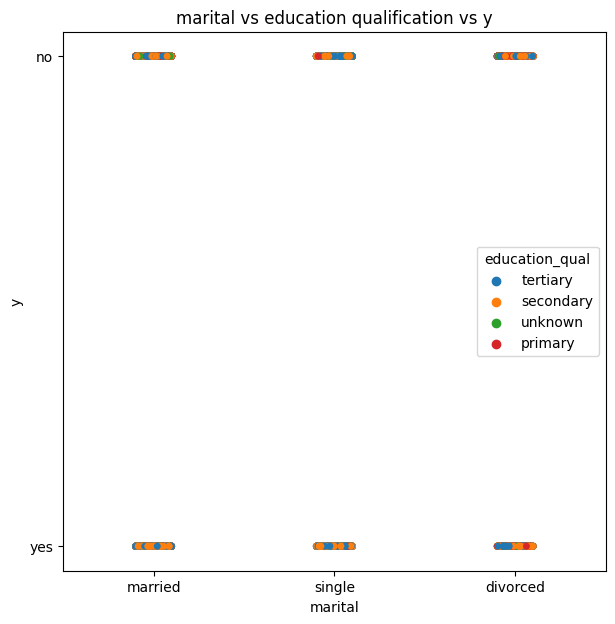

In [98]:
#scatter plot marital vs educaton_qual vs['call_type', 'day', 'mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['call_type', 'day', 'mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="marital",y=i,hue='education_qual')
        
        # Add title
        
        plot.set(title='marital vs education_qual vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='marital', hue="education_qual", y=i)
        
        # Add title
        
        plot.set(title='marital vs education qualification vs {}'.format(i))
        plt.show()
        

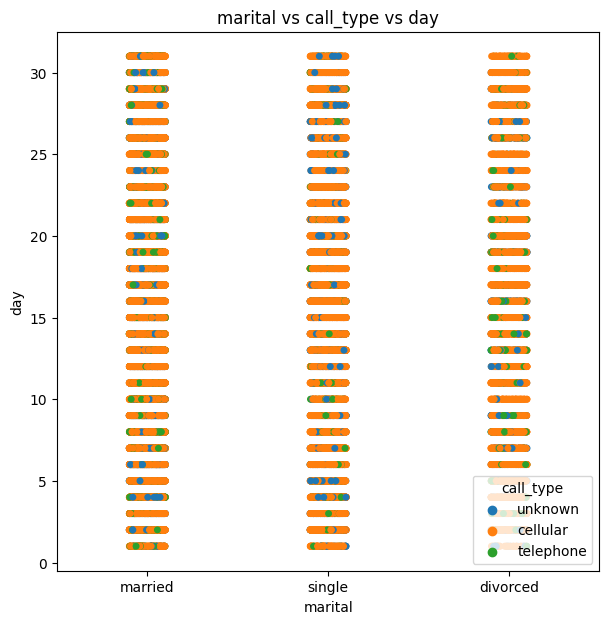

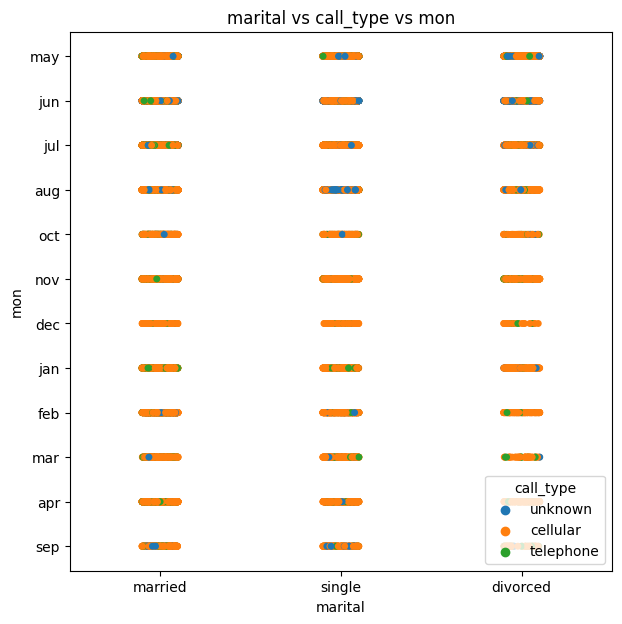

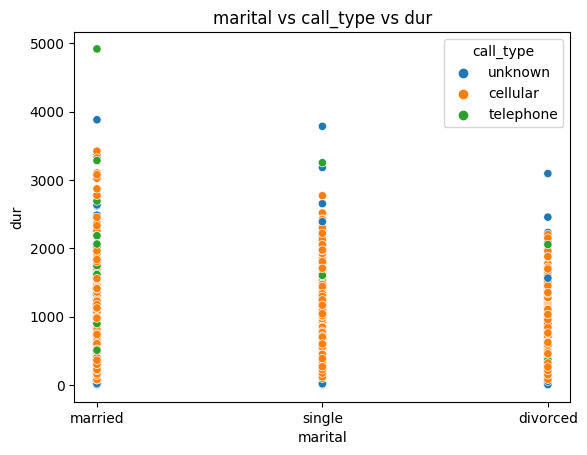

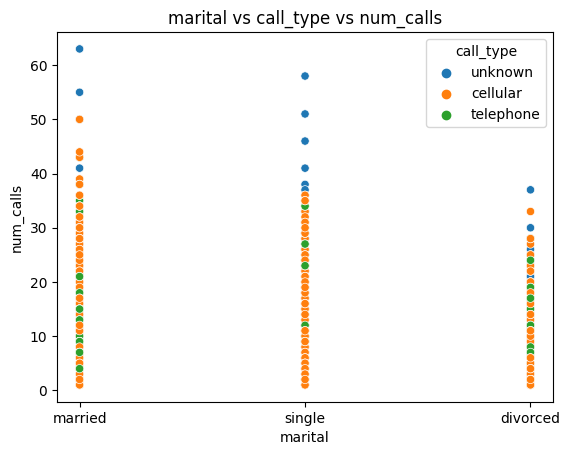

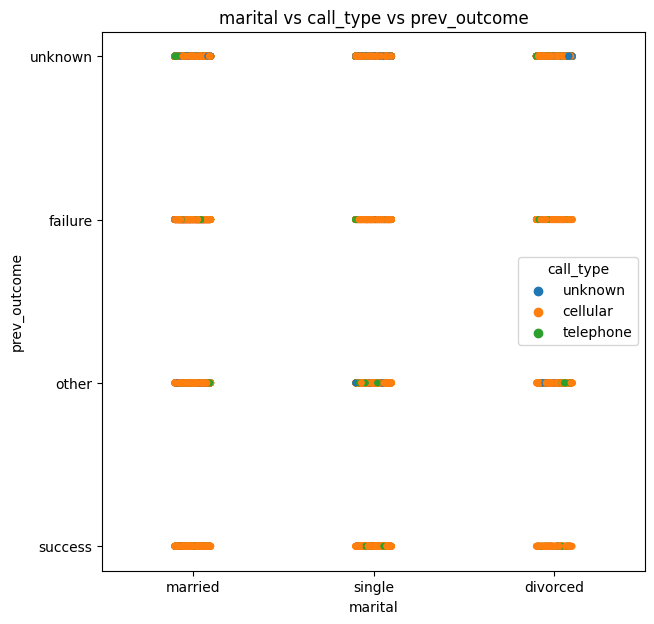

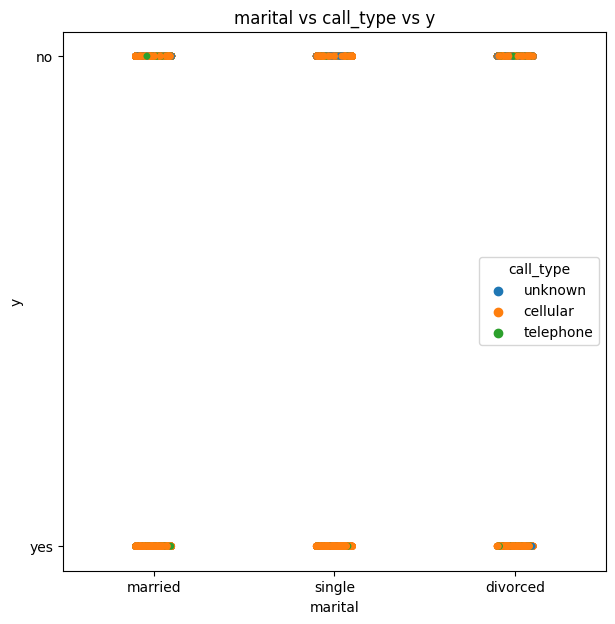

In [99]:
#scatter plot marital vs call_type vs['day', 'mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['day', 'mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="marital",y=i,hue='call_type')
        
        # Add title
        
        plot.set(title='marital vs call_type vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='marital', hue='call_type', y=i)
        
        # Add title
        
        plot.set(title='marital vs call_type vs {}'.format(i))
        plt.show()


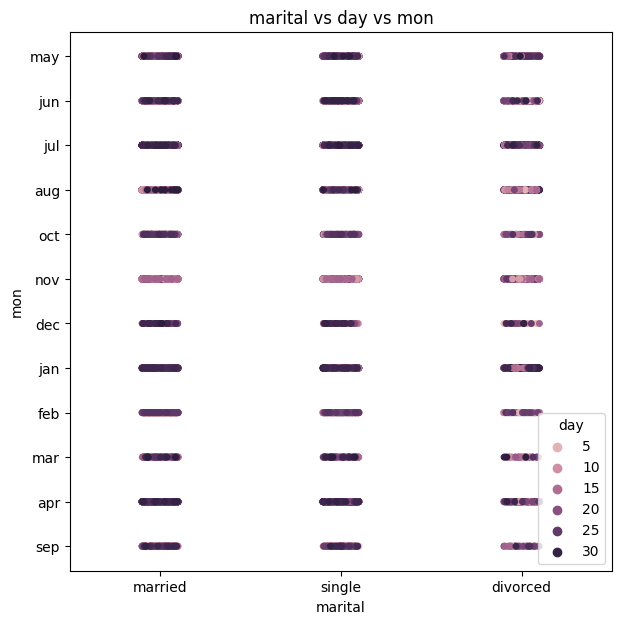

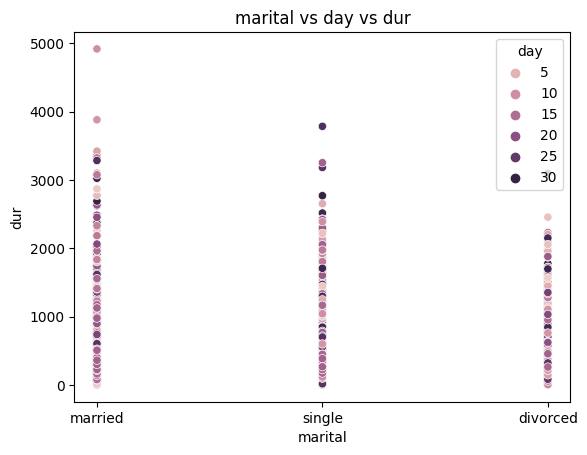

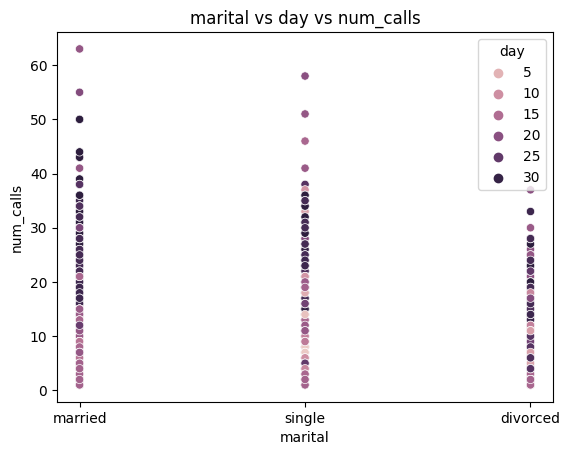

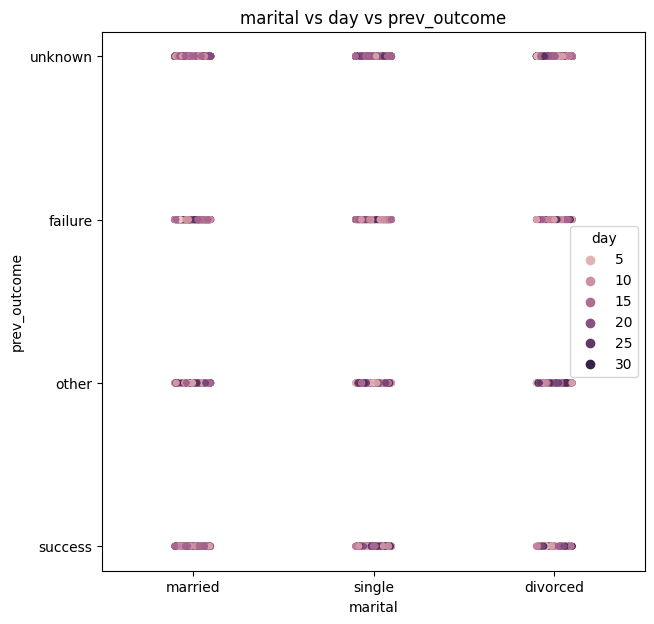

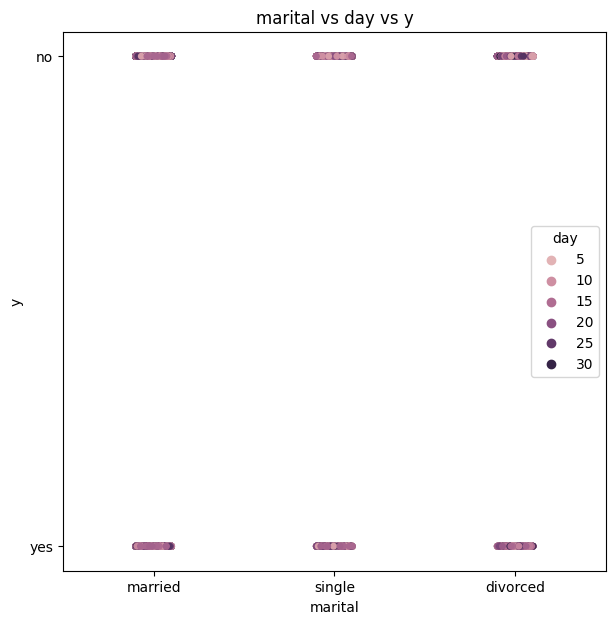

In [100]:
#scatter plot marital vs day vs['mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="marital",y=i,hue='day')
        
        # Add title
        
        plot.set(title='marital vs day vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='marital', hue='day', y=i)
        
        # Add title
        
        plot.set(title='marital vs day vs {}'.format(i))
        plt.show()


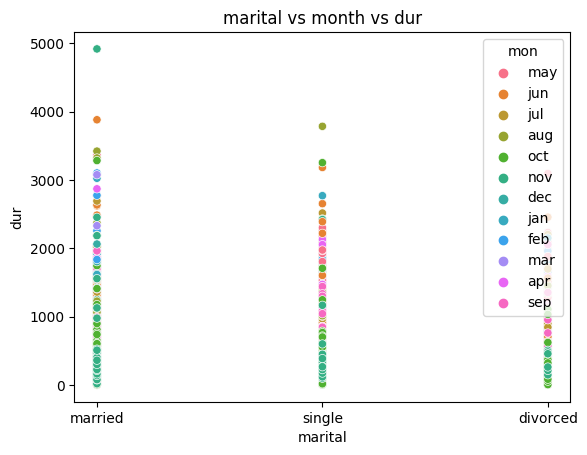

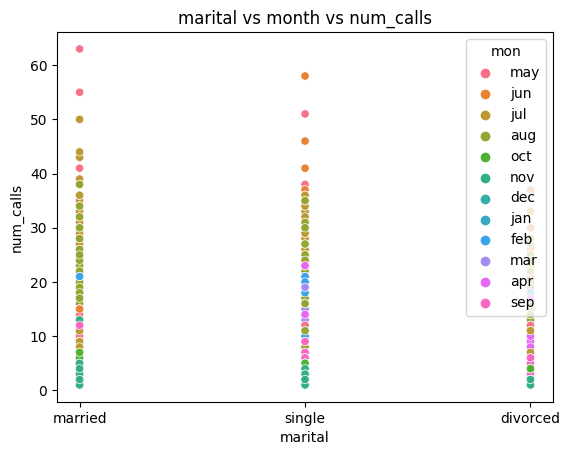

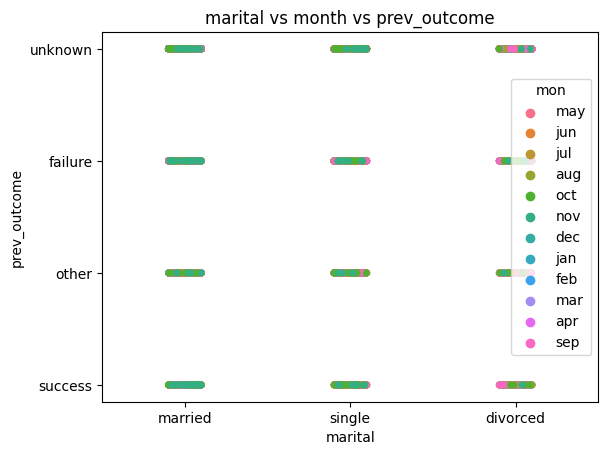

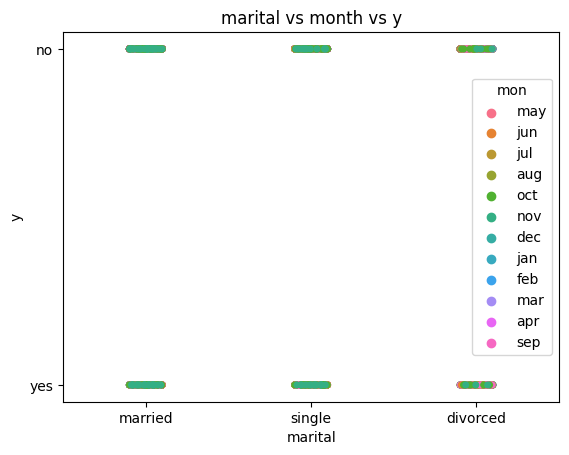

In [101]:
#scatter plot marital vs month vs['dur', 'num_calls', 'prev_outcome', 'y']

for i in ['dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="marital",y=i,hue='mon')
        
        # Add title
        
        plot.set(title='marital vs month vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='marital', hue='mon', y=i)
        
        # Add title
        
        plot.set(title='marital vs month vs {}'.format(i))
        plt.show()


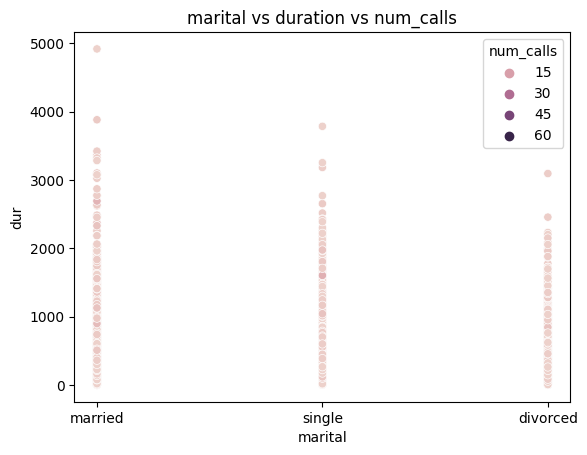

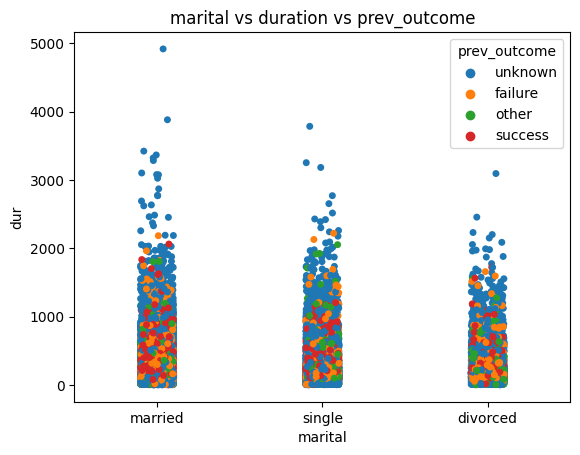

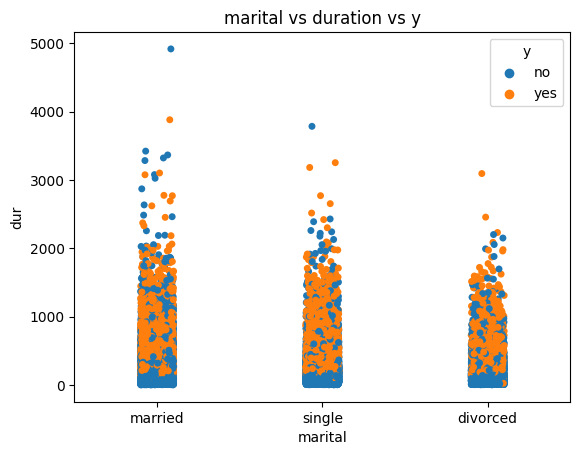

In [102]:
#scatter plot marital vs duration vs['num_calls', 'prev_outcome', 'y']

for i in ['num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="marital",hue=i,y='dur')
        
        # Add title
        
        plot.set(title='marital vs duration vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='marital', hue=i, y='dur')
        
        # Add title
        
        plot.set(title='marital vs duration vs {}'.format(i))
        plt.show()


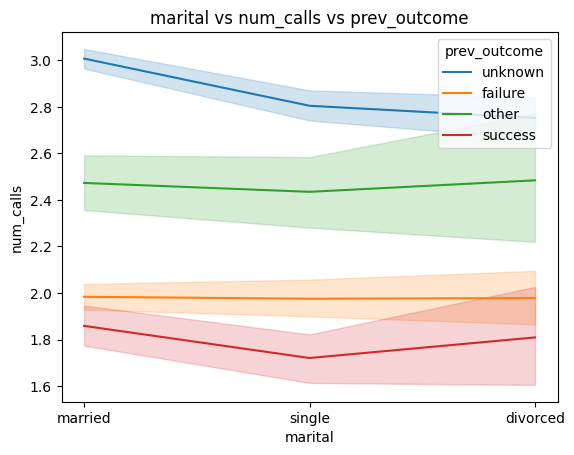

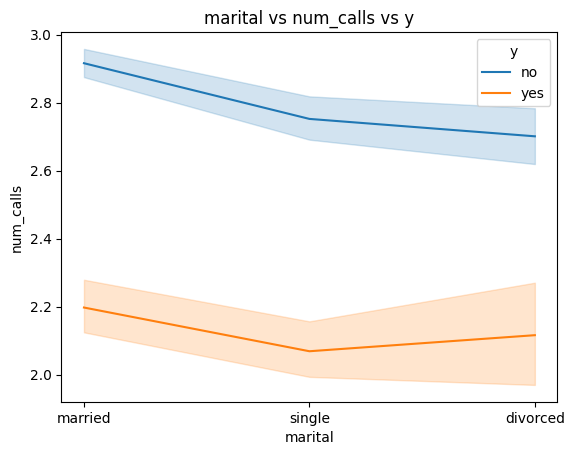

In [103]:
#scatter plot marital vs num_calls vs['prev_outcome', 'y']

for i in ['prev_outcome', 'y']:
    
    #lineplot
        
    #plt.figure(figsize=(10,5))
    plot=sns.lineplot(data=df,x="marital",hue=i,y='num_calls')
        
    # Add title
        
    plot.set(title='marital vs num_calls vs {}'.format(i))
    plt.show()

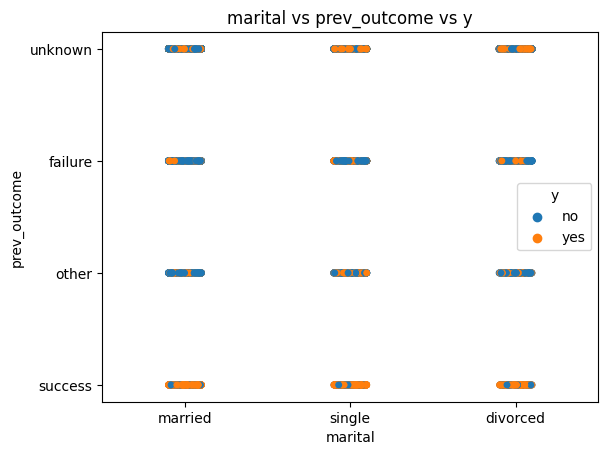

In [104]:
#line plot marital vs prev_outcome vs y

#lineplot
        
#plt.figure(figsize=(10,5))
plot=sns.stripplot(data=df,x="marital",hue='y',y='prev_outcome')
        
# Add title
        
plot.set(title='marital vs prev_outcome vs y')
plt.show()

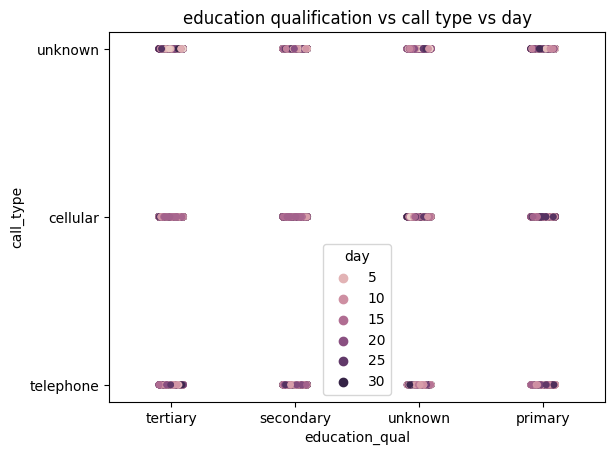

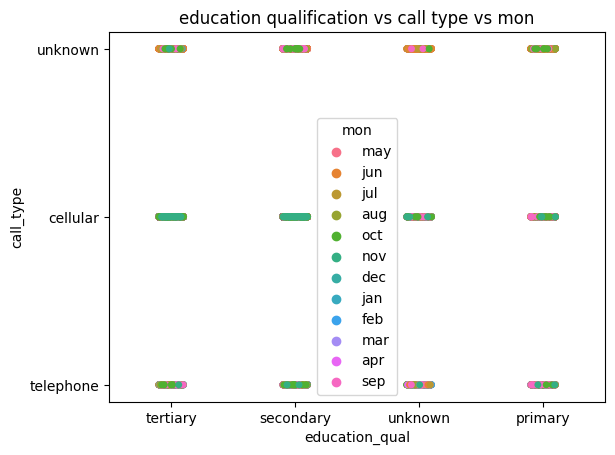

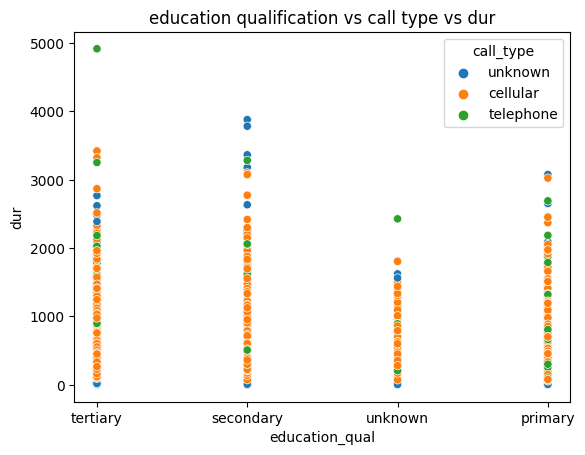

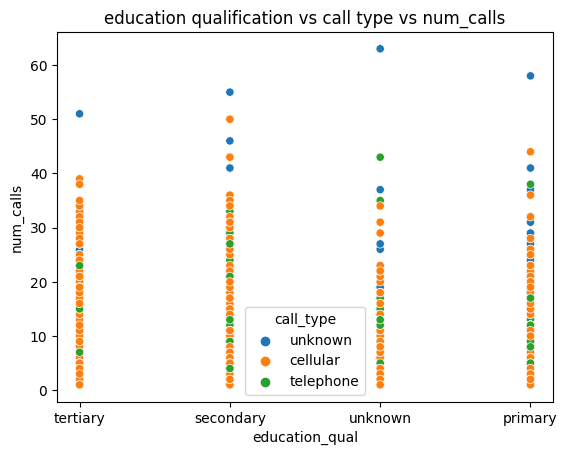

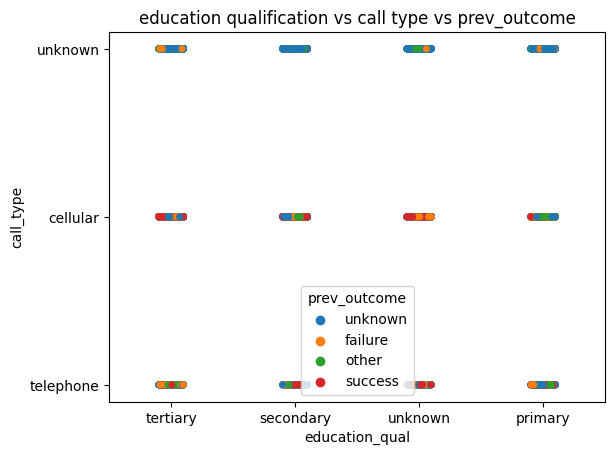

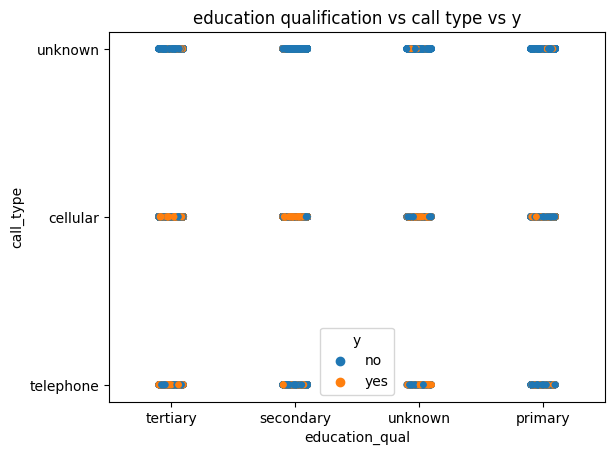

In [105]:
#scatter plot education_qual vs call_type vs['day', 'mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['day', 'mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="education_qual",y=i,hue='call_type')
        
        # Add title
        
        plot.set(title='education qualification vs call type vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='education_qual', hue=i, y='call_type')
        
        # Add title
        
        plot.set(title='education qualification vs call type vs {}'.format(i))
        plt.show()

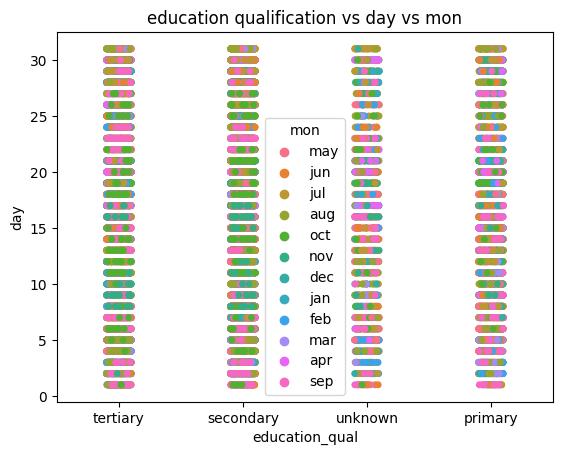

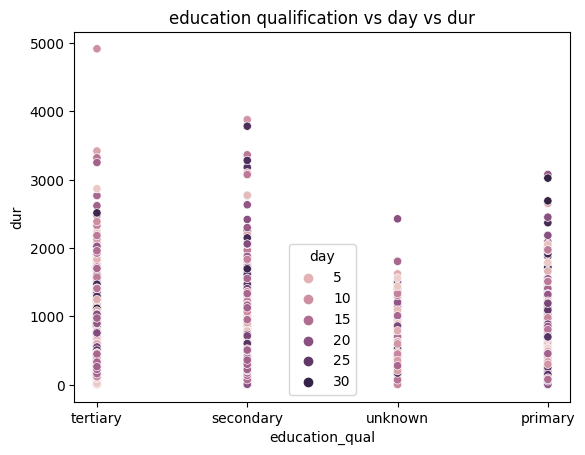

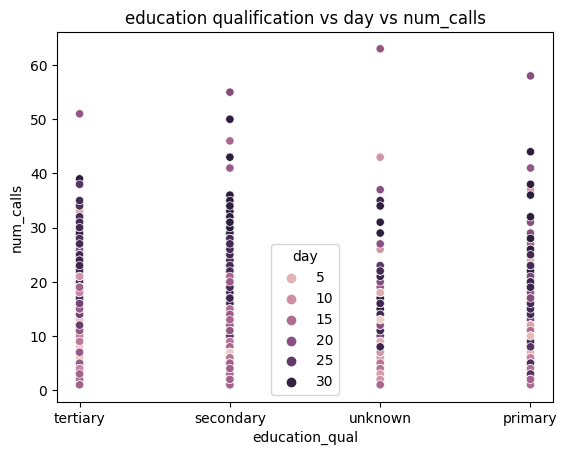

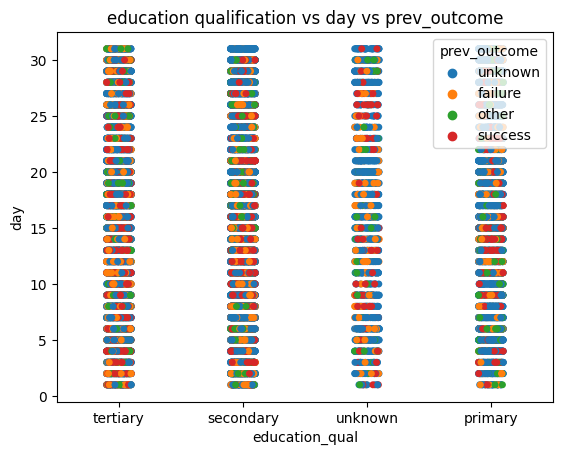

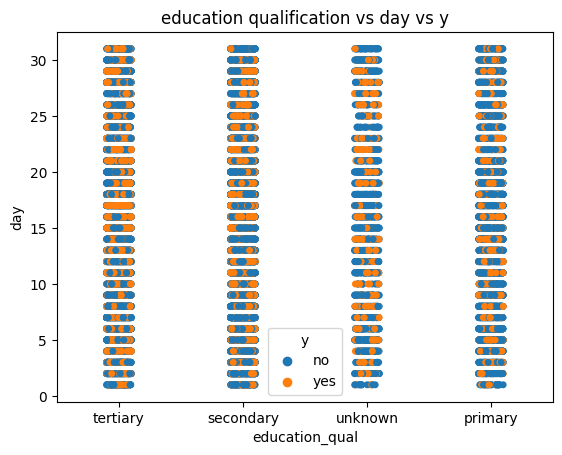

In [106]:
#scatter plot education_qual vs day vs['mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="education_qual",y=i,hue='day')
        
        # Add title
        
        plot.set(title='education qualification vs day vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='education_qual', hue=i, y='day')
        
        # Add title
        
        plot.set(title='education qualification vs day vs {}'.format(i))
        plt.show()

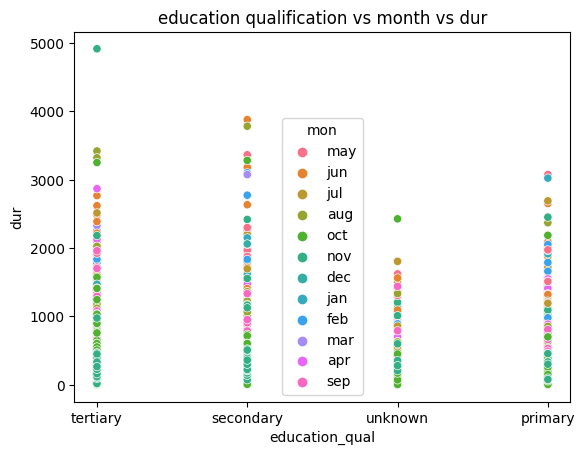

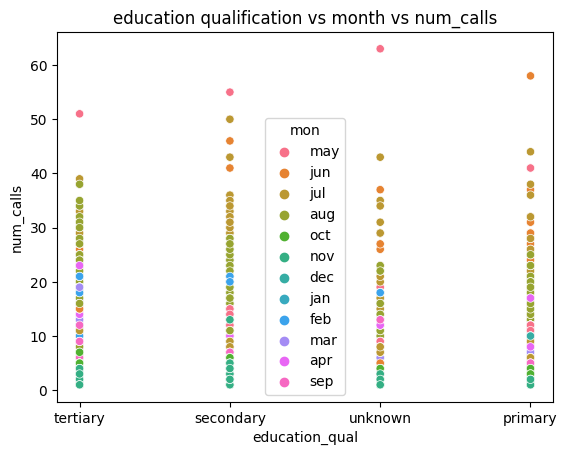

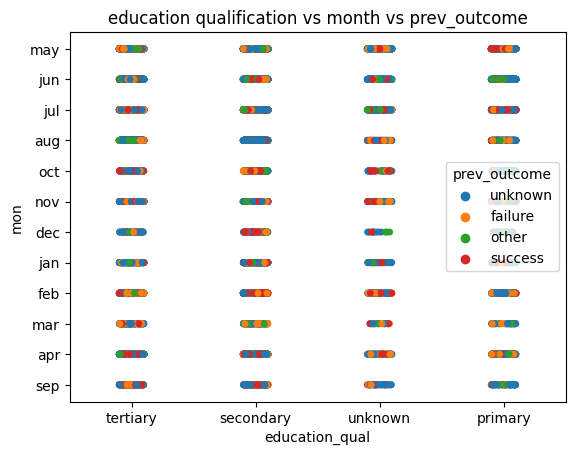

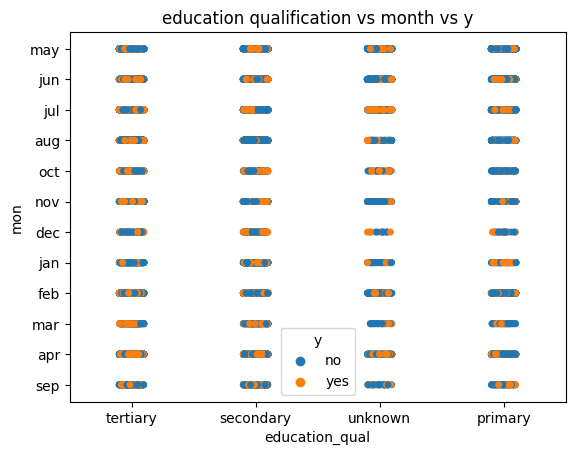

In [107]:
#scatter plot education_qual vs month vs['dur', 'num_calls', 'prev_outcome', 'y']

for i in ['dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="education_qual",y=i,hue='mon')
        
        # Add title
        
        plot.set(title='education qualification vs month vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='education_qual', hue=i, y='mon')
        
        # Add title
        
        plot.set(title='education qualification vs month vs {}'.format(i))
        plt.show()

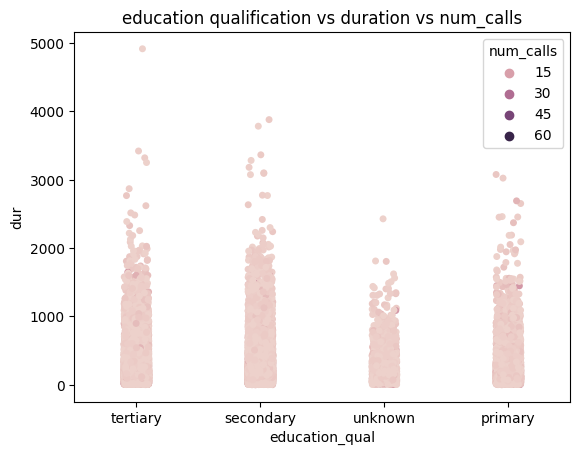

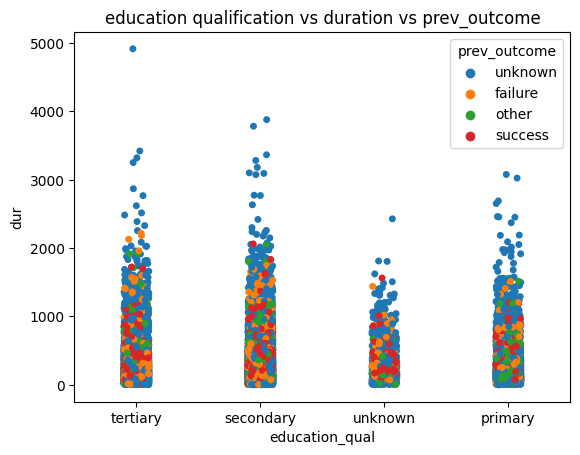

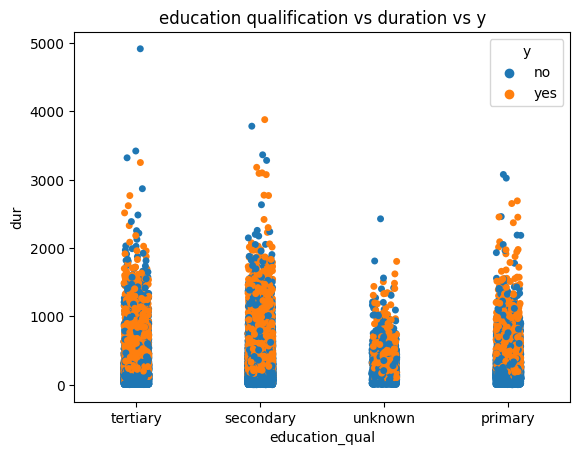

In [108]:
#scatter plot education_qual vs duration vs['dur', 'num_calls', 'prev_outcome', 'y']

for i in ['num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.stripplot(data=df,x="education_qual",hue=i,y='dur')
        
        # Add title
        
        plot.set(title='education qualification vs duration vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='education_qual', hue=i, y='dur')
        
        # Add title
        
        plot.set(title='education qualification vs duration vs {}'.format(i))
        plt.show()

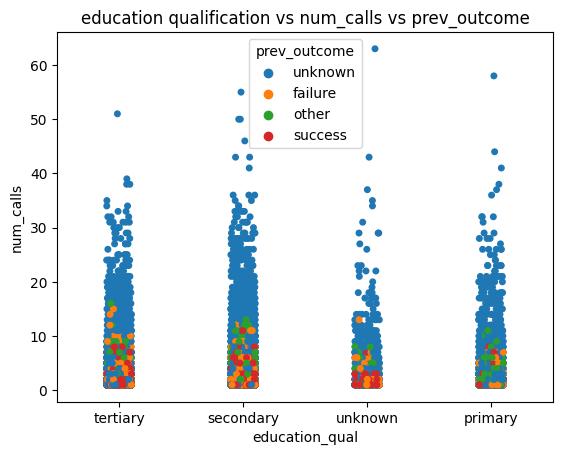

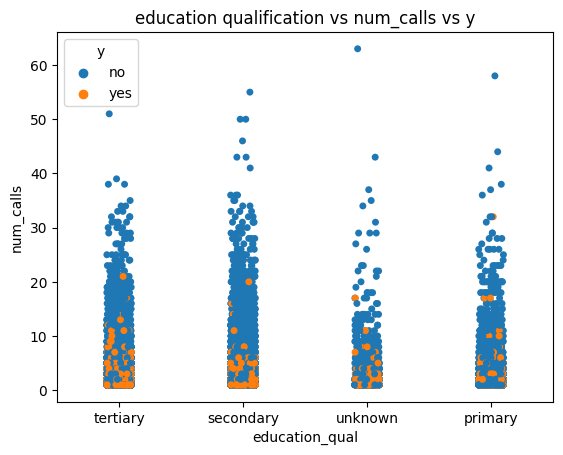

In [109]:
#scatter plot education_qual vs num_calls vs['prev_outcome', 'y']

for i in ['prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df,x="education_qual",hue=i,y='num_calls')
        
        # Add title
        
        plot.set(title='education qualification vs num_cals vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='education_qual', hue=i, y='num_calls')
        
        # Add title
        
        plot.set(title='education qualification vs num_calls vs {}'.format(i))
        plt.show()

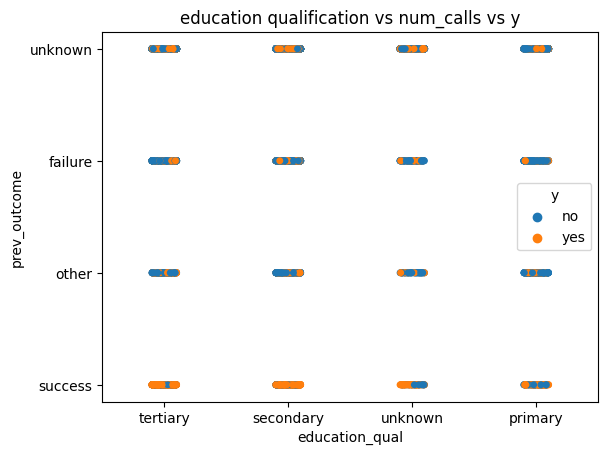

In [110]:
#scatter plot education_qual vs prev_outcome vs y

for i in ['y']:
    
    #srtip plot
        
    #plt.figure(figsize=(7,7))
    plot=sns.stripplot(data=df, x='education_qual', hue=i, y='prev_outcome')
        
    # Add title
        
    plot.set(title='education qualification vs num_calls vs {}'.format(i))
    plt.show()

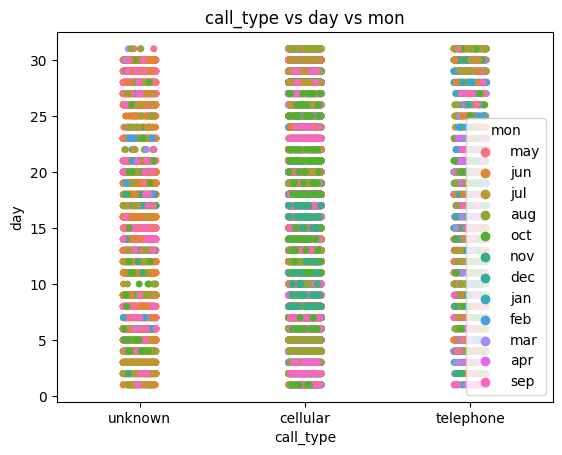

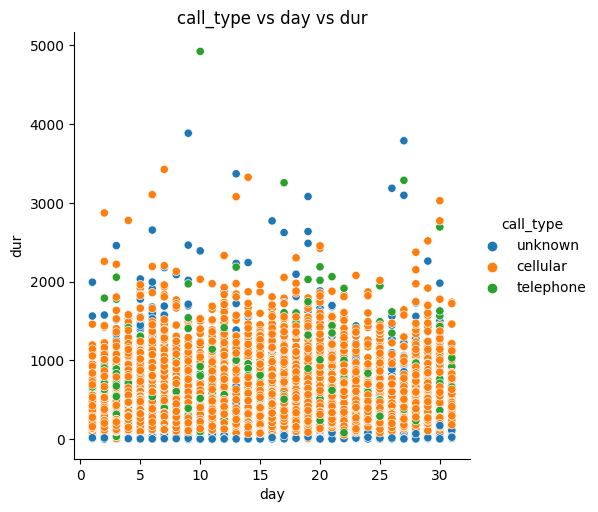

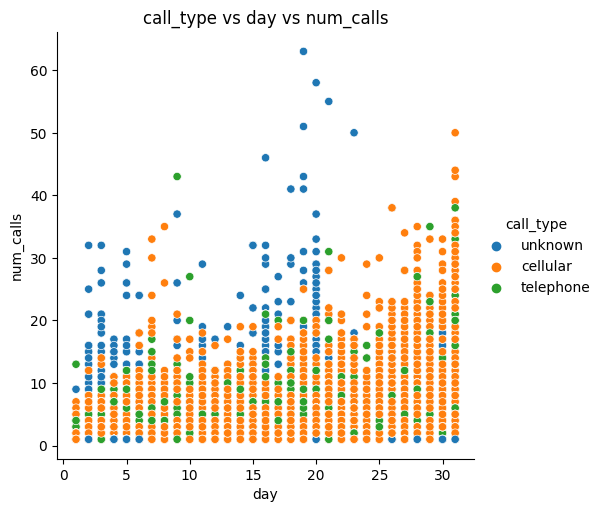

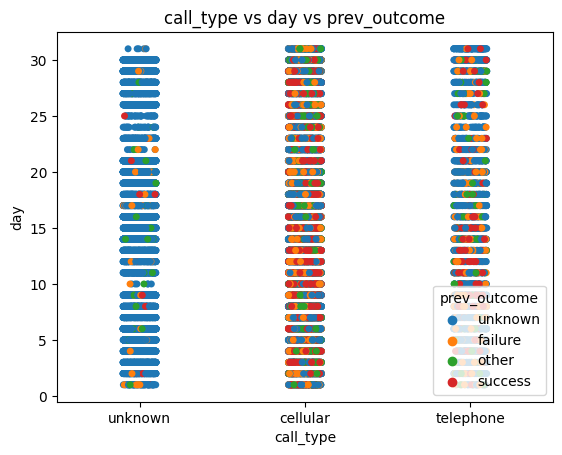

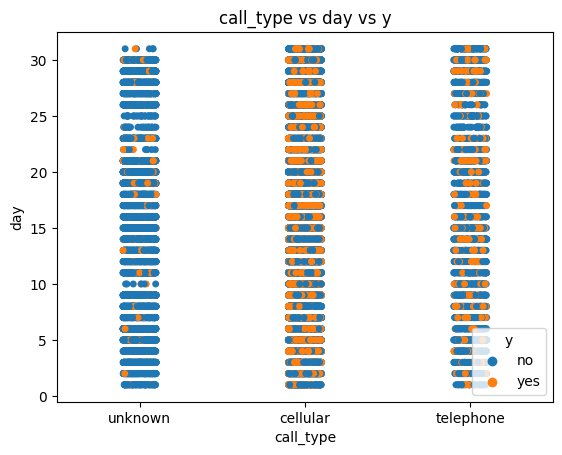

In [111]:
#scatter plot call_type vs day vs['mon','dur', 'num_calls', 'prev_outcome', 'y']

for i in ['mon',
       'dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.relplot(data=df, x="day", y=i, hue="call_type")
        
        # Add title
        
        plot.set(title='call_type vs day vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='call_type', hue=i, y='day')
        
        # Add title
        
        plot.set(title='call_type vs day vs {}'.format(i))
        plt.show()

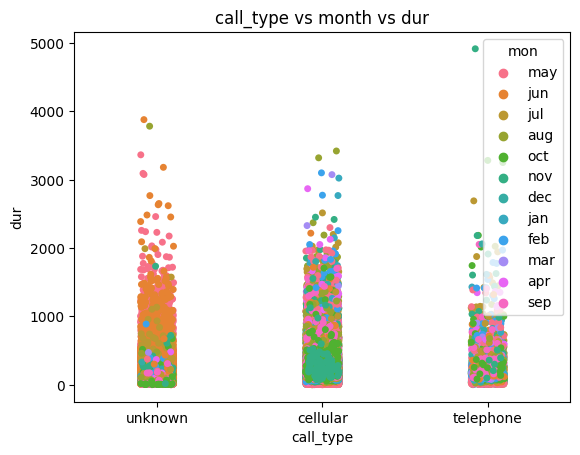

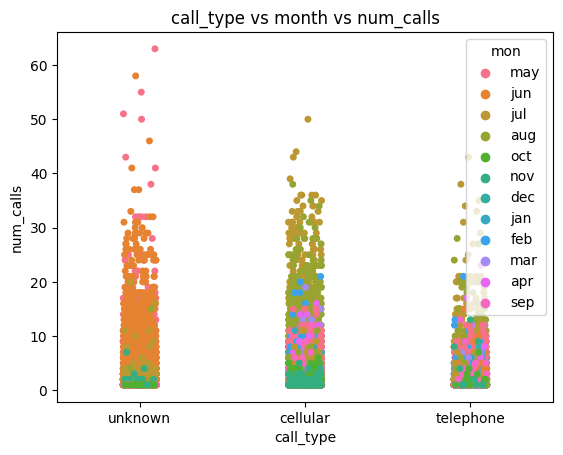

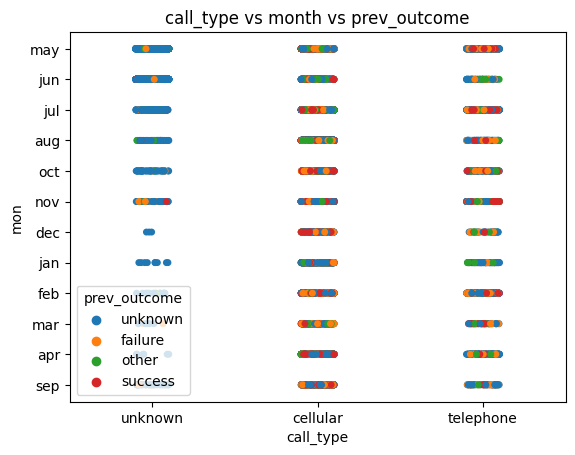

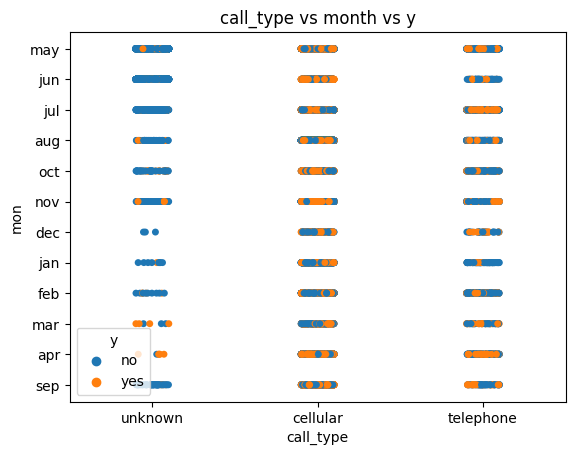

In [112]:
#strip plot call_type vs month vs['dur', 'num_calls', 'prev_outcome', 'y']

for i in ['dur', 'num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #stripplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.stripplot(data=df, x="call_type", y=i, hue="mon")
        
        # Add title
        
        plot.set(title='call_type vs month vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='call_type', hue=i, y='mon')
        
        # Add title
        
        plot.set(title='call_type vs month vs {}'.format(i))
        plt.show()

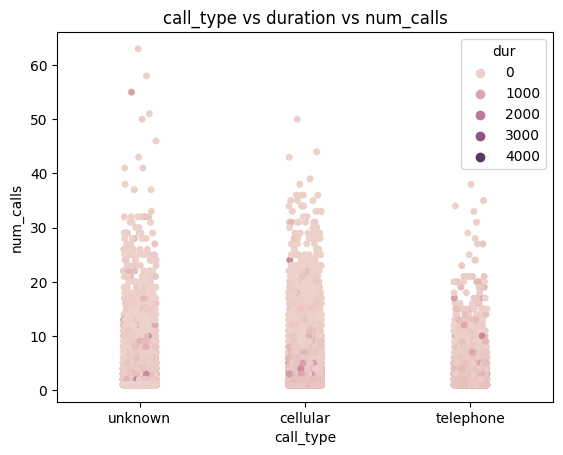

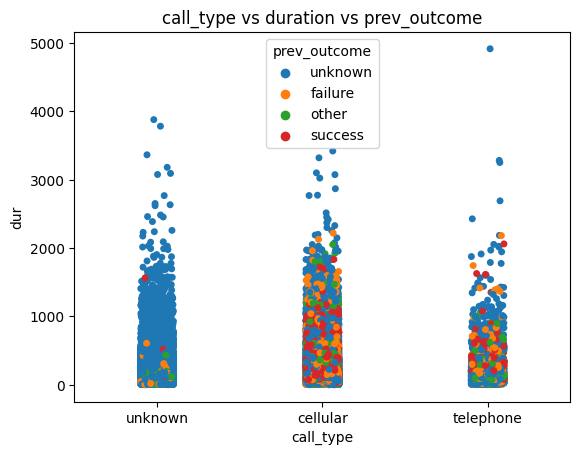

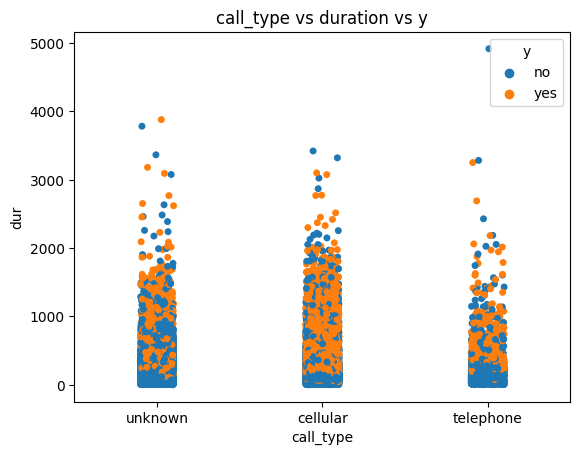

In [113]:
#strip plot call_type vs duration vs['num_calls', 'prev_outcome', 'y']

for i in ['num_calls', 'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #stripplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.stripplot(data=df, x="call_type", y=i, hue="dur")
        
        # Add title
        
        plot.set(title='call_type vs duration vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='call_type', hue=i, y='dur')
        
        # Add title
        
        plot.set(title='call_type vs duration vs {}'.format(i))
        plt.show()

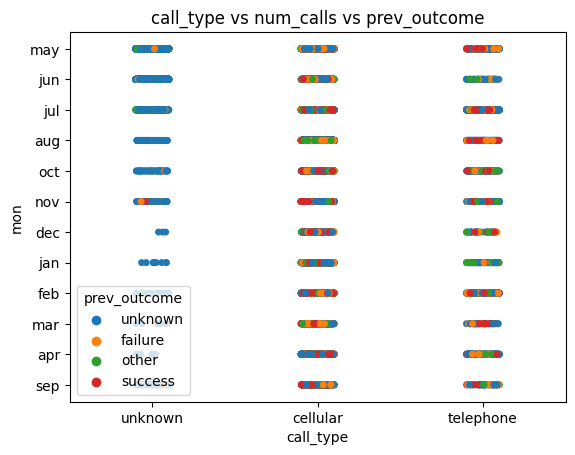

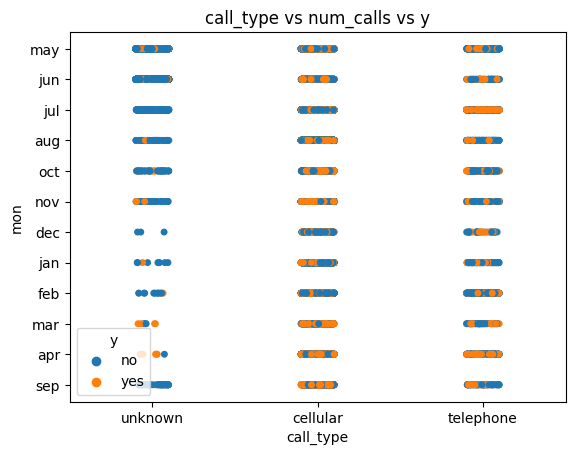

In [114]:
#strip plot call_type vs num_calls vs['prev_outcome', 'y']

for i in ['prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df, hue="call_type", y=i, x="num_calls")
        
        # Add title
        
        plot.set(title='call_type vs num_calls vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='call_type', hue=i, y='mon')
        
        # Add title
        
        plot.set(title='call_type vs num_calls vs {}'.format(i))
        plt.show()

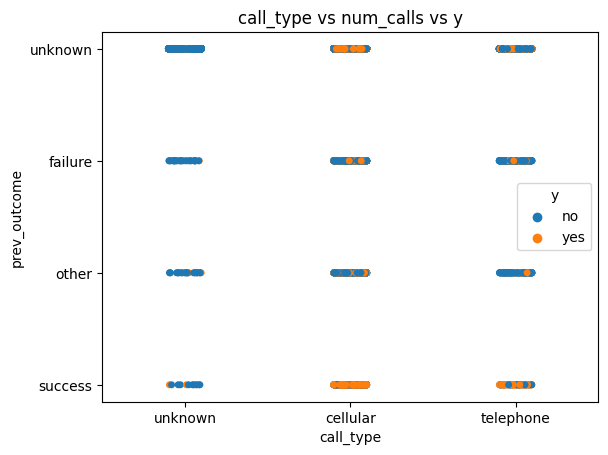

In [115]:
#strip plot call_type vs prev_outcome vs y

#stripplot
        
#plt.figure(figsize=(7,7))
plot=sns.stripplot(data=df, x='call_type', hue="y", y='prev_outcome')
        
# Add title
        
plot.set(title='call_type vs num_calls vs {}'.format(i))
plt.show()

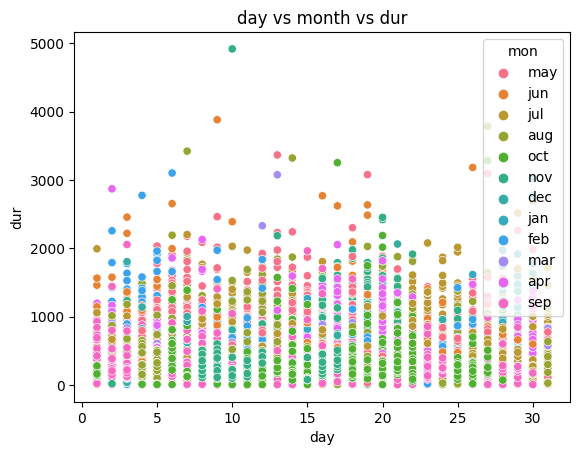

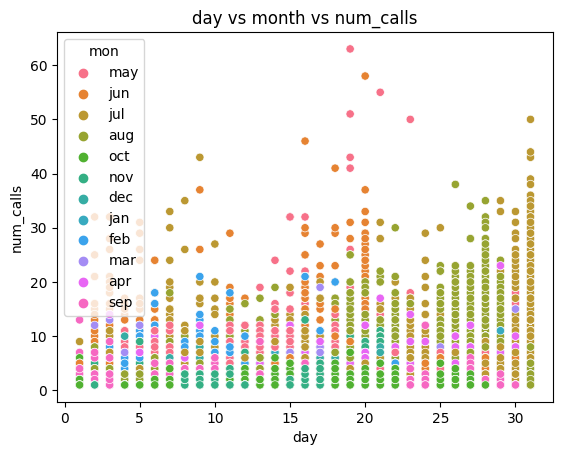

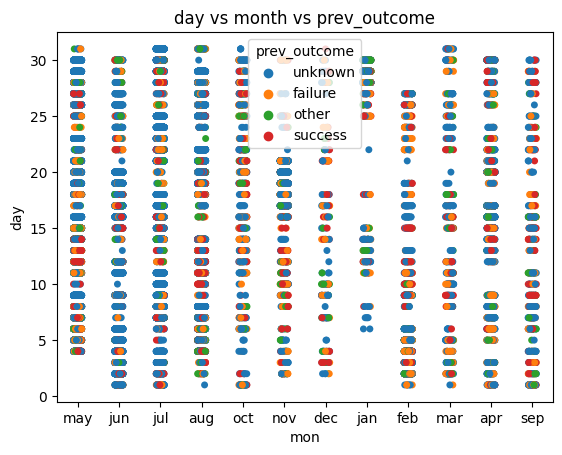

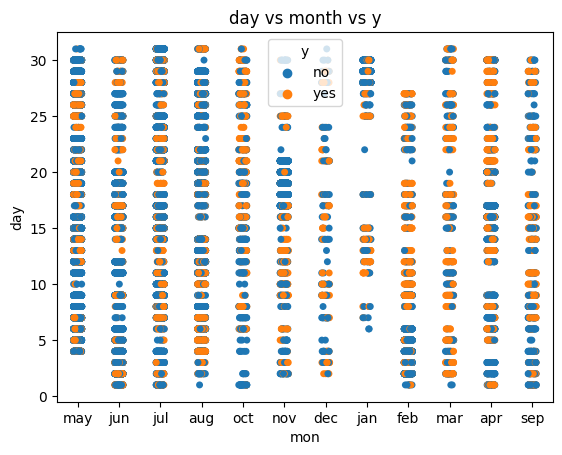

In [116]:
#strip plot day vs month vs['dur', 'num_calls', 'prev_outcome', 'y']

for i in ["dur","num_calls",'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df, hue="mon", y=i, x="day")
        
        # Add title
        
        plot.set(title='day vs month vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='mon', hue=i, y='day')
        
        # Add title
        
        plot.set(title='day vs month vs {}'.format(i))
        plt.show()

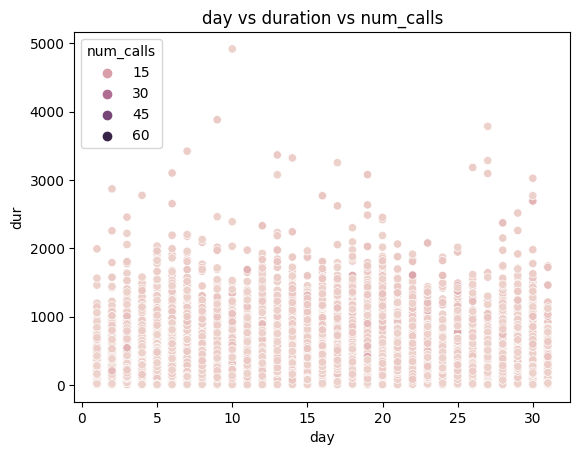

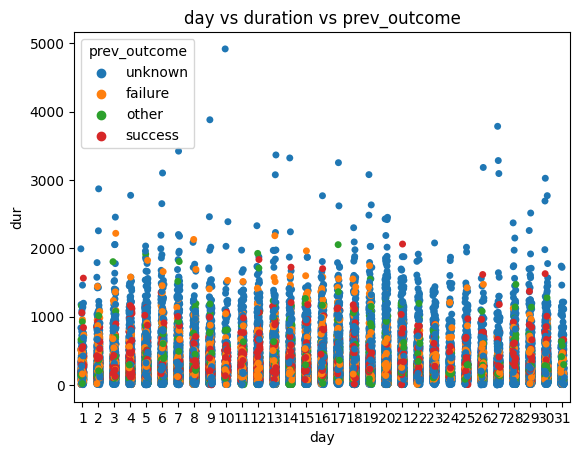

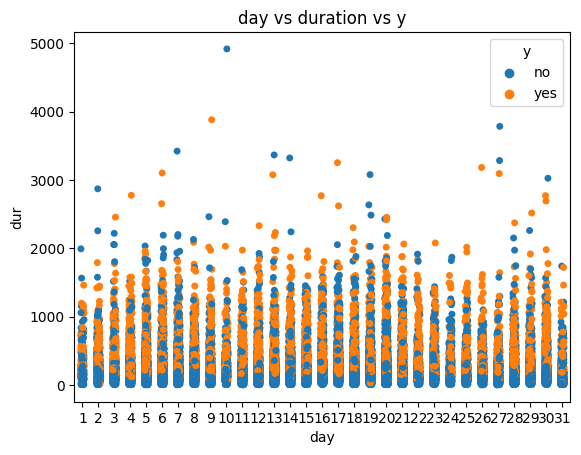

In [117]:
#strip plot day vs duration vs['num_calls', 'prev_outcome', 'y']

for i in ["num_calls",'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df, y="dur", hue=i, x="day")
        
        # Add title
        
        plot.set(title='day vs duration vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, y='dur', hue=i, x='day')
        
        # Add title
        
        plot.set(title='day vs duration vs {}'.format(i))
        plt.show()

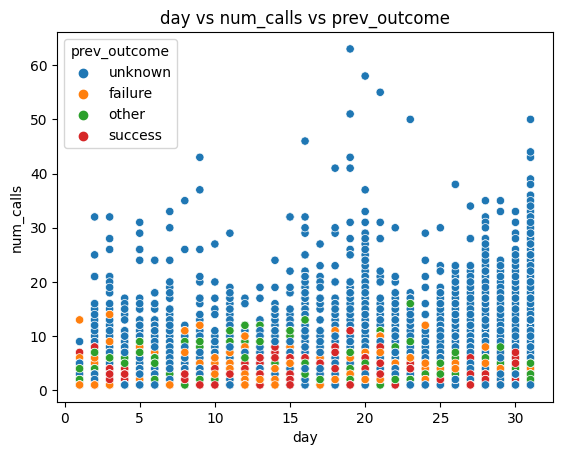

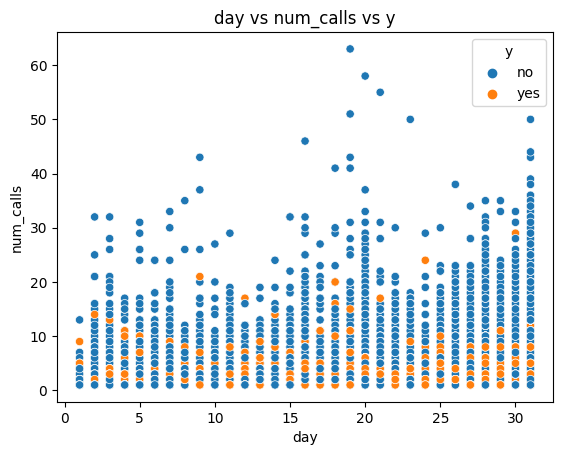

In [118]:
#strip plot day vs num_calls vs['prev_outcome', 'y']

for i in ['prev_outcome', 'y']:
    

        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.scatterplot(data=df, y='num_calls', hue=i, x='day')
        
        # Add title
        
        plot.set(title='day vs num_calls vs {}'.format(i))
        plt.show()

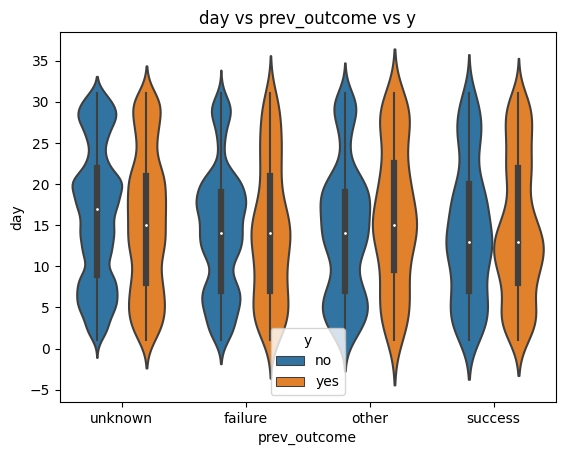

In [119]:
#violin plot day vs prev_outcome vs y

        
#plt.figure(figsize=(7,7))
plot=sns.violinplot(data=df, x='prev_outcome', hue="y", y='day')
        
# Add title
        
plot.set(title='day vs prev_outcome vs y')
plt.show()

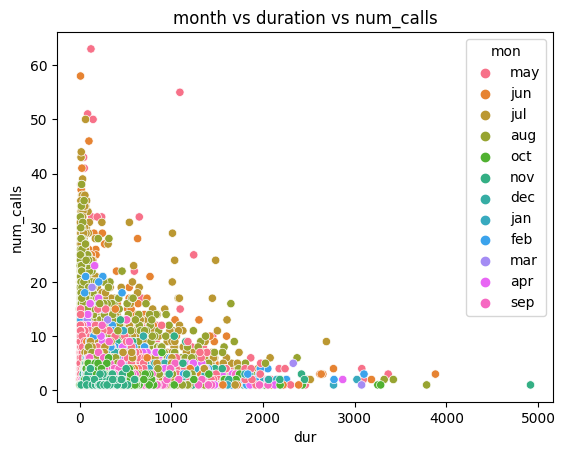

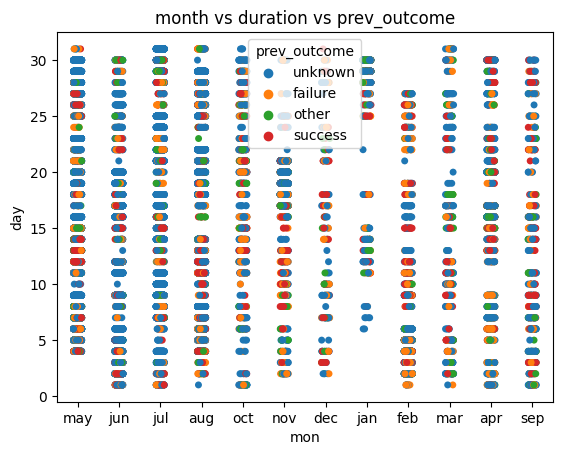

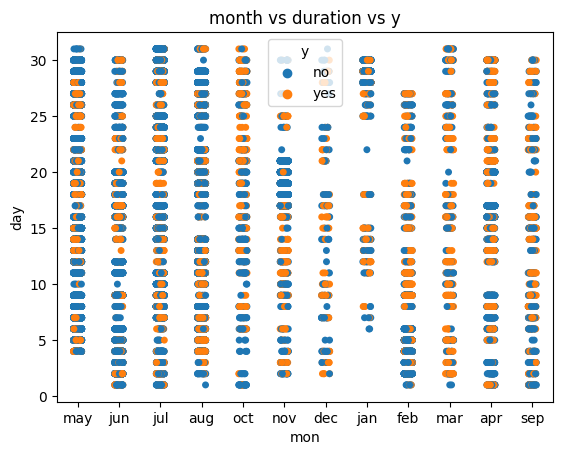

In [120]:
#strip plot month vs duration vs['num_calls', 'prev_outcome', 'y'],]

for i in ["num_calls",'prev_outcome', 'y']:
    
    if i =="dur" or i=="num_calls":
         #scatterplot
        
        #plt.figure(figsize=(10,5))
        plot=sns.scatterplot(data=df, hue="mon", y=i, x="dur")
        
        # Add title
        
        plot.set(title='month vs duration vs {}'.format(i))
        plt.show()

    else:
        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='mon', hue=i, y='day')
        
        # Add title
        
        plot.set(title='month vs duration vs {}'.format(i))
        plt.show()

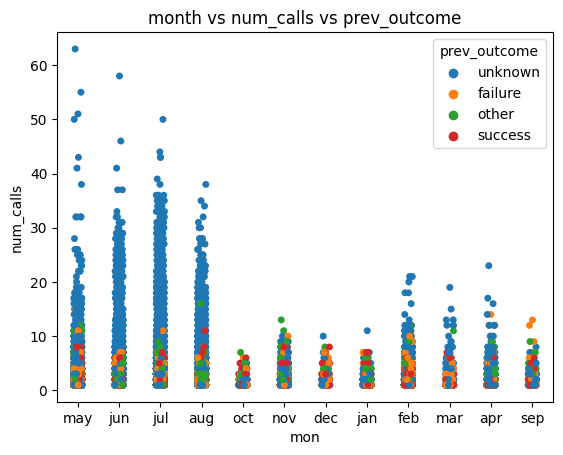

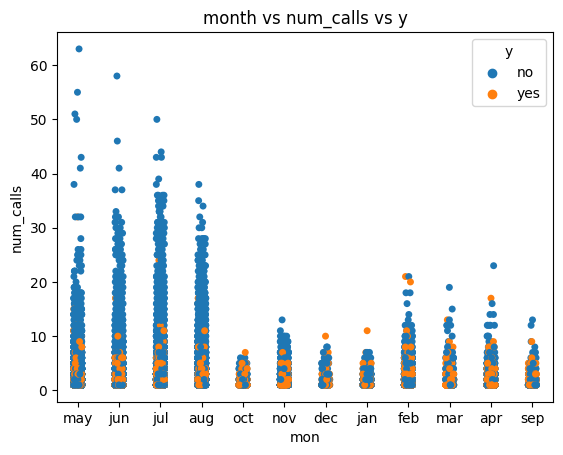

In [121]:
#strip plot month vs num_calls vs['prev_outcome', 'y'],]

for i in ['prev_outcome', 'y']:

        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.stripplot(data=df, x='mon', hue=i, y='num_calls')
        
        # Add title
        
        plot.set(title='month vs num_calls vs {}'.format(i))
        plt.show()

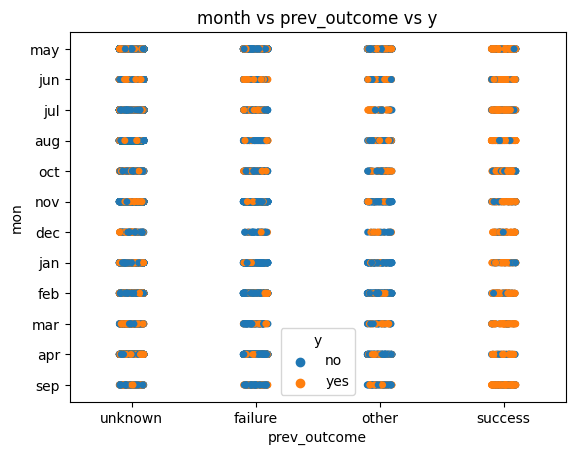

In [122]:
#strip plot month vs prev_outcome vs y



#srtip plot
        
#plt.figure(figsize=(7,7))
plot=sns.stripplot(data=df, y='mon', hue="y", x='prev_outcome')
        
# Add title
        
plot.set(title='month vs prev_outcome vs y')
plt.show()

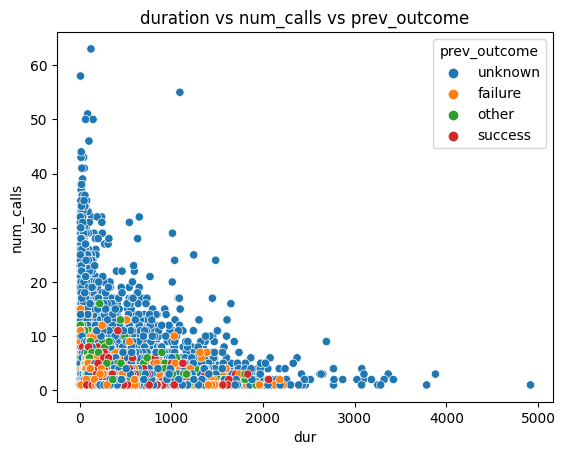

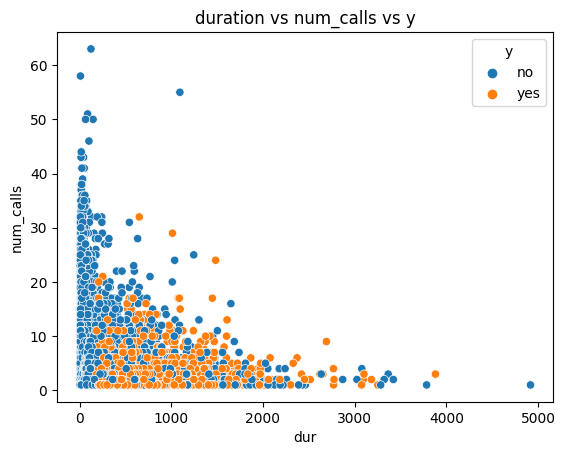

In [123]:
#strip plot duration vs num_calls vs ['prev_outcome', 'y']

for i in ['prev_outcome', 'y']:

        #srtip plot
        
        #plt.figure(figsize=(7,7))
        plot=sns.scatterplot(data=df, x='dur', hue=i, y='num_calls')
        
        # Add title
        
        plot.set(title='duration vs num_calls vs {}'.format(i))
        plt.show()

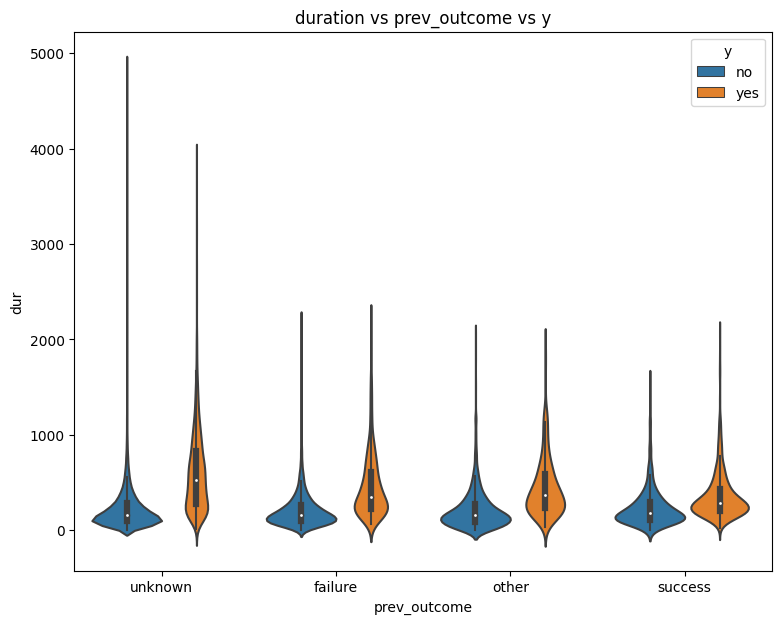

In [124]:
#violin plot duration vs prev_outcome vs y


#violin plot
        
plt.figure(figsize=(9,7))
plot=sns.violinplot(data=df, y='dur', hue='y', x='prev_outcome')
        
# Add title
        
plot.set(title='duration vs prev_outcome vs y')
plt.show()

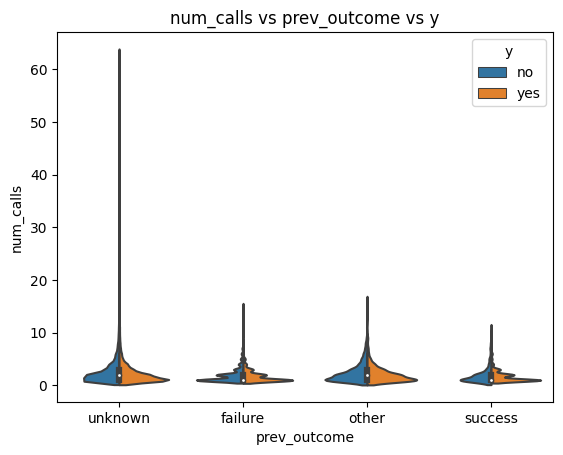

In [125]:
#violin plot num_calls vs prev_outcome vs y


#violin plot
        
#plt.figure(figsize=(8,7))
plot=sns.violinplot(data=df, y='num_calls', hue='y', x='prev_outcome',split=True)
        
# Add title
        
plot.set(title='num_calls vs prev_outcome vs y')
plt.show()

## Observation

1. The starting age for almost retired individuals is 35 years old. In almost every job category, the highest age is between 60 and 70 years old. In the student category, 9% of people are married. The maximum number of individuals who have completed tertiary education work in management or are self-employed at the starting age of 25-30. Retired individuals are mostly in housemaid or blue-collar positions with a primary education qualification. Telephone calls are made in very low numbers. The majority of these calls are connected with retired persons, entrepreneurs, and unknown job persons. The duration of talking is higher for people between the ages of 25 and 55. Blue-collar workers, entrepreneurs, and management personnel are mostly occupied in this area.


2. People between the ages of 25-50 receive term insurance-related calls 13-18 times a day for all job categories. Entrepreneurs, management, students, and unemployed individuals tend to accept term insurance at the beginning of age 25. Married individuals tend to take term insurance at the age of 35. Divorced persons reject term insurance at the age of 30-60. People who have completed tertiary education tend to take insurance at the age of 30-35.


3. Unknown call types mostly occur between the ages of 25-35 in the months of August and September. Many 30-year-old people reject insurance after a successful stage in prev_outcome. Management, admin, and service personnel take more time to take term insurance. Married persons tend to receive an average of 4 calls before taking insurance. Unknown qualification type people are all connected with cellular call types.


4. The months of May, September, November, and July mostly connect with people via cellular calls. In December, only 'unknown' call types are made, and most people reject taking term insurance. People who get 'success' results in prev_outcome on day 12-15 tend to reject term insurance. Fewer calls are made in October, December, September, and July. In December, very few people take insurance.


5. People who are at the 'failure' stage of prev_outcome mostly convert to taking term insurance in June and July. Less than 15 calls are made to take insurance, and every call duration is covered within the range of 200-1600 seconds.

# Outliers and removal

<AxesSubplot: xlabel='age'>

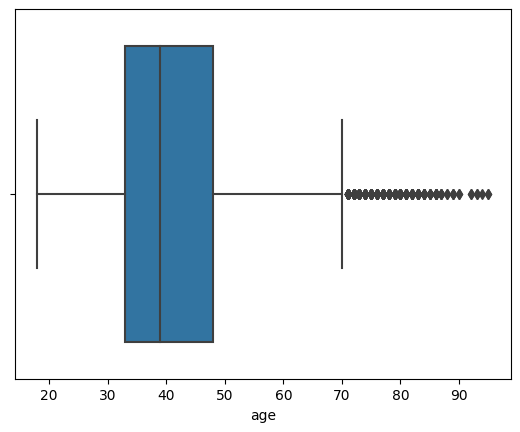

In [126]:
#BOX plot for age 

sns.boxplot(data=df, x="age")

In [127]:
IQR=df["age"].quantile(0.75)-df["age"].quantile(0.25)
upper_thresh=df["age"].quantile(0.75)+ 1.5 * IQR
upper_thresh

70.5

In [128]:
#outlier removing

df['age']=df["age"].apply(lambda x: upper_thresh if x > upper_thresh else x)

<AxesSubplot: xlabel='age'>

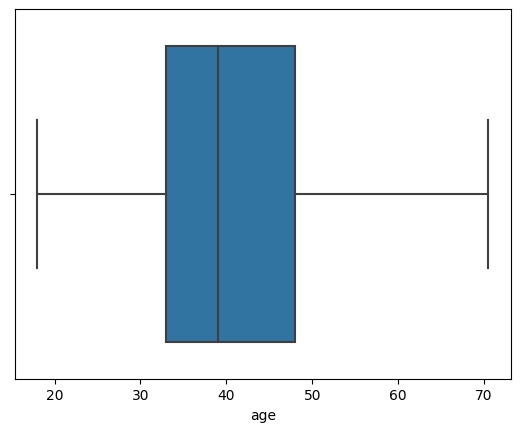

In [129]:
sns.boxplot(data=df,x="age")

<AxesSubplot: xlabel='num_calls'>

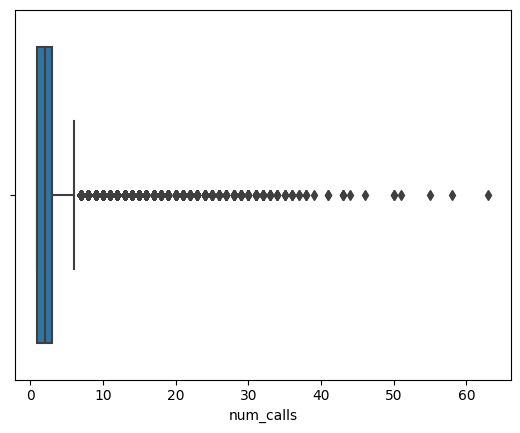

In [130]:
#boxplot for num_calls

sns.boxplot(data=df,x="num_calls")

In [131]:
IQR1=df["num_calls"].quantile(0.75)-df["num_calls"].quantile(0.25)
upper_thresh1=df["num_calls"].quantile(0.75)+ 1.5 * IQR1
upper_thresh1

6.0

In [132]:
df["num_calls"]=df["num_calls"].apply(lambda x: upper_thresh1 if x>upper_thresh1 else x)

<AxesSubplot: xlabel='num_calls'>

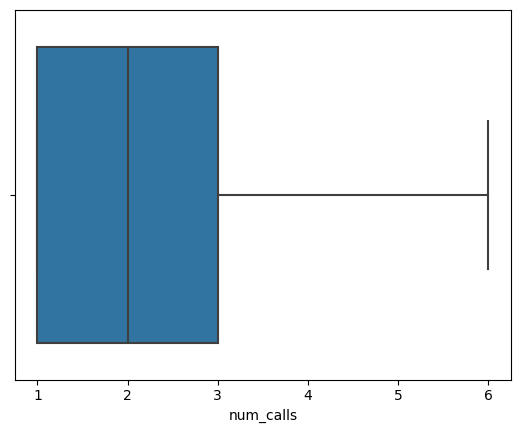

In [133]:
sns.boxplot(data=df,x="num_calls")

<AxesSubplot: xlabel='dur'>

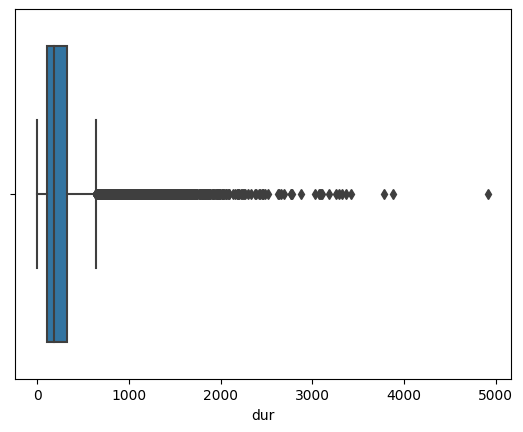

In [134]:
#box plot for duration 

sns.boxplot(data=df,x="dur")

In [135]:
IQR2=df["dur"].quantile(0.75)-df["dur"].quantile(0.25)
upper_thresh2=df["dur"].quantile(0.75)+ 1.5 * IQR2
upper_thresh2

643.0

In [136]:
df[df["dur"]>upper_thresh2].shape

(3235, 11)

In [137]:
df["dur"]=df["dur"].apply(lambda x:upper_thresh2 if x > upper_thresh2 else x)

<AxesSubplot: xlabel='dur'>

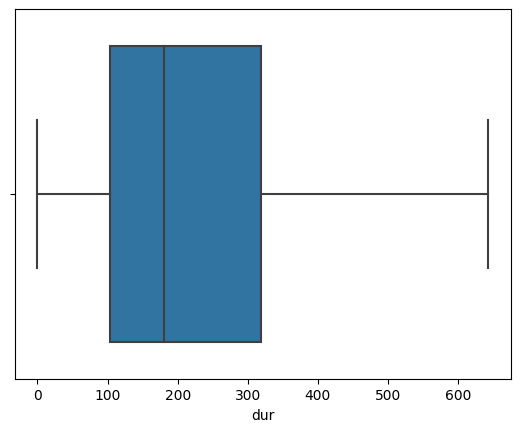

In [138]:
sns.boxplot(data=df,x="dur")

# Feature engineering
### Encoding Techniques

In [139]:
df.head()

,age,job,marital,education_qual,call_type,day,mon,dur,num_calls,prev_outcome,y
0,58.0,management,married,tertiary,unknown,5,may,261.0,1.0,unknown,no
1,44.0,technician,single,secondary,unknown,5,may,151.0,1.0,unknown,no
2,33.0,entrepreneur,married,secondary,unknown,5,may,76.0,1.0,unknown,no
3,47.0,blue-collar,married,unknown,unknown,5,may,92.0,1.0,unknown,no
4,33.0,unknown,single,unknown,unknown,5,may,198.0,1.0,unknown,no


In [140]:
#encoding the y column
df["y"]=df["y"].map({"no":0,"yes":1})

In [141]:
#encoding the job column

df["job"].value_counts()

blue-collar      9730
management       9457
technician       7596
admin.           5170
services         4153
retired          2264
self-employed    1579
entrepreneur     1487
unemployed       1303
housemaid        1240
student           938
unknown           288
Name: job, dtype: int64

In [142]:
df.groupby(["job"])["y"].mean().sort_values()

job
blue-collar      0.072765
entrepreneur     0.082717
housemaid        0.087903
services         0.088851
technician       0.110585
unknown          0.118056
self-employed    0.118429
admin.           0.122050
management       0.137570
unemployed       0.155027
retired          0.227915
student          0.286780
Name: y, dtype: float64

<AxesSubplot: xlabel='job'>

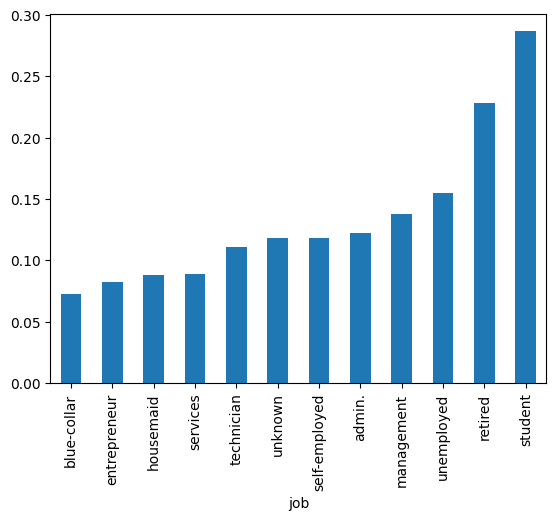

In [143]:
df.groupby(["job"])["y"].mean().sort_values().plot.bar()

In [144]:
#target guided ordinal category encoding

df["job"]=df["job"].map({'blue-collar':0,
 'entrepreneur':1,
 'housemaid':2,
 'services':3,
 'technician':4,
 'self-employed':5,
 'admin.':6,
 'management':7,
 'unemployed':8,
 'retired':9,
 'student':10})

In [145]:
df["job"]=df['job'].fillna(0)

In [146]:
df

,age,job,marital,education_qual,call_type,day,mon,dur,num_calls,prev_outcome,y
0,58.0,7.0,married,tertiary,unknown,5,may,261.0,1.0,unknown,0
1,44.0,4.0,single,secondary,unknown,5,may,151.0,1.0,unknown,0
2,33.0,1.0,married,secondary,unknown,5,may,76.0,1.0,unknown,0
3,47.0,0.0,married,unknown,unknown,5,may,92.0,1.0,unknown,0
4,33.0,0.0,single,unknown,unknown,5,may,198.0,1.0,unknown,0
...,...,...,...,...,...,...,...,...,...,...,...
45206,51.0,4.0,married,tertiary,cellular,17,nov,643.0,3.0,unknown,1
45207,70.5,9.0,divorced,primary,cellular,17,nov,456.0,2.0,unknown,1
45208,70.5,9.0,married,secondary,cellular,17,nov,643.0,5.0,success,1
45209,57.0,0.0,married,secondary,telephone,17,nov,508.0,4.0,unknown,0


In [147]:
#endcoding of marital status column

df["marital"].value_counts()

married     27210
single      12788
divorced     5207
Name: marital, dtype: int64

In [148]:
df.groupby(["marital"])["y"].mean().sort_values()

marital
married     0.101250
divorced    0.119455
single      0.149515
Name: y, dtype: float64

<AxesSubplot: xlabel='marital'>

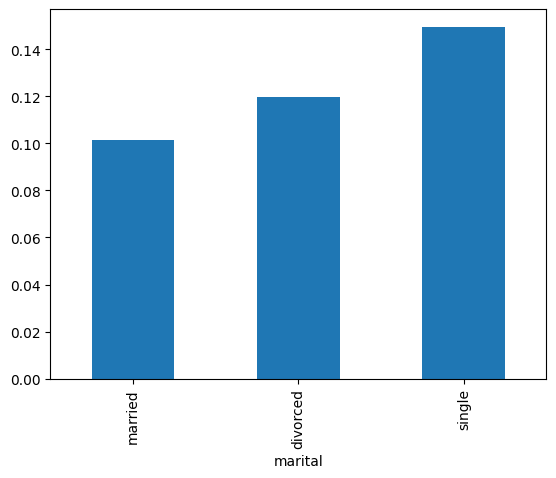

In [149]:
df.groupby(["marital"])["y"].mean().sort_values().plot.bar()

In [150]:
df["marital"]=df["marital"].map({"divorced":0,"married":1,"single":2})
df.head()

,age,job,marital,education_qual,call_type,day,mon,dur,num_calls,prev_outcome,y
0,58.0,7.0,1,tertiary,unknown,5,may,261.0,1.0,unknown,0
1,44.0,4.0,2,secondary,unknown,5,may,151.0,1.0,unknown,0
2,33.0,1.0,1,secondary,unknown,5,may,76.0,1.0,unknown,0
3,47.0,0.0,1,unknown,unknown,5,may,92.0,1.0,unknown,0
4,33.0,0.0,2,unknown,unknown,5,may,198.0,1.0,unknown,0


In [151]:
#encoding the education qualification

df["education_qual"].value_counts()

secondary    23199
tertiary     13299
primary       6850
unknown       1857
Name: education_qual, dtype: int64

In [152]:
df.groupby(["education_qual"])["y"].mean().sort_values()

education_qual
primary      0.086277
secondary    0.105608
unknown      0.135703
tertiary     0.150086
Name: y, dtype: float64

<AxesSubplot: xlabel='education_qual'>

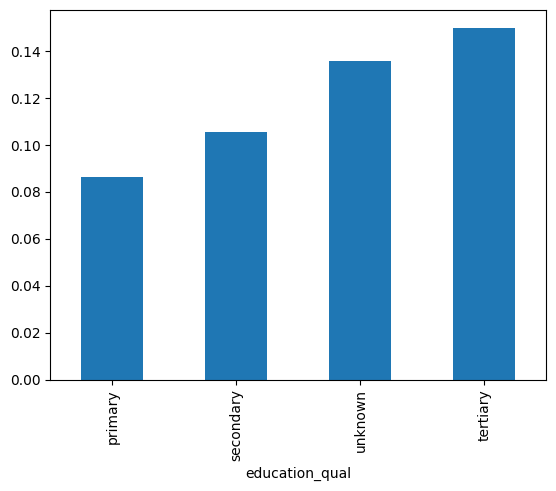

In [153]:
df.groupby(["education_qual"])["y"].mean().sort_values().plot.bar()

In [154]:
df["education_qual"]=df["education_qual"].map({"primary":0,"secondary":1,"unknown":2,"tertiary":3})

In [155]:
df.head()

,age,job,marital,education_qual,call_type,day,mon,dur,num_calls,prev_outcome,y
0,58.0,7.0,1,3,unknown,5,may,261.0,1.0,unknown,0
1,44.0,4.0,2,1,unknown,5,may,151.0,1.0,unknown,0
2,33.0,1.0,1,1,unknown,5,may,76.0,1.0,unknown,0
3,47.0,0.0,1,2,unknown,5,may,92.0,1.0,unknown,0
4,33.0,0.0,2,2,unknown,5,may,198.0,1.0,unknown,0


In [156]:
#encoding the call_type feature

df["call_type"].value_counts()

cellular     29282
unknown      13017
telephone     2906
Name: call_type, dtype: int64

In [157]:
df.groupby(["call_type"])["y"].mean().sort_values()

call_type
unknown      0.040716
telephone    0.134205
cellular     0.149204
Name: y, dtype: float64

<AxesSubplot: xlabel='call_type'>

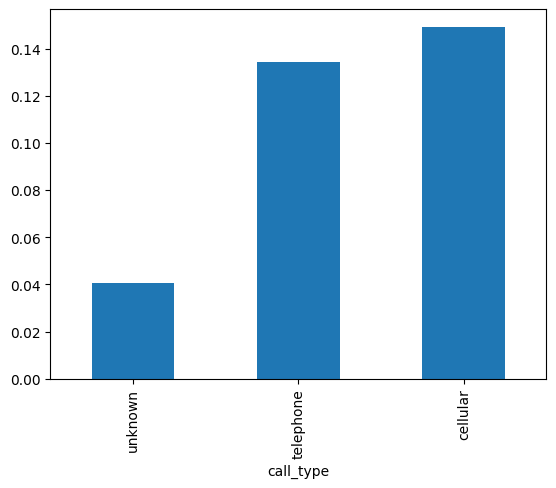

In [158]:
df.groupby(["call_type"])["y"].mean().sort_values().plot.bar()

In [159]:
df["call_type"]=df["call_type"].map({"unknown":0,"telephone":1,"cellular":2})
df.head()

,age,job,marital,education_qual,call_type,day,mon,dur,num_calls,prev_outcome,y
0,58.0,7.0,1,3,0,5,may,261.0,1.0,unknown,0
1,44.0,4.0,2,1,0,5,may,151.0,1.0,unknown,0
2,33.0,1.0,1,1,0,5,may,76.0,1.0,unknown,0
3,47.0,0.0,1,2,0,5,may,92.0,1.0,unknown,0
4,33.0,0.0,2,2,0,5,may,198.0,1.0,unknown,0


In [160]:
#encoding for month column

df.groupby(["mon"])["y"].mean().sort_values()

mon
may    0.067199
jul    0.090949
jan    0.101212
nov    0.101511
jun    0.102266
aug    0.110168
feb    0.166478
apr    0.196794
oct    0.437669
sep    0.464594
dec    0.467290
mar    0.519916
Name: y, dtype: float64

<AxesSubplot: xlabel='mon'>

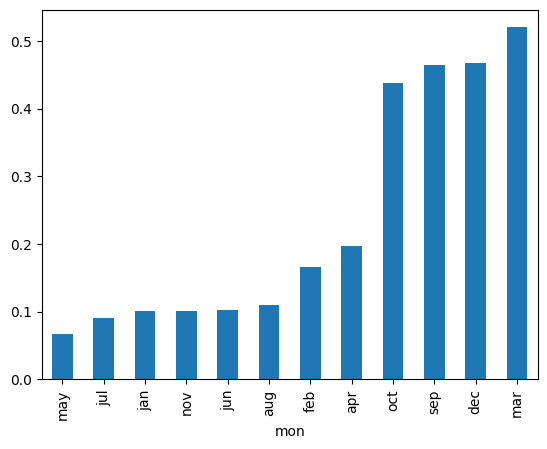

In [161]:
df.groupby(["mon"])["y"].mean().sort_values().plot.bar()

In [162]:
df["mon"]=df["mon"].map({'may':0,
 'jul':1,
 'jan':2,
 'nov':3,
 'jun':4,
 'aug':5,
 'feb':6,
 'apr':7,
 'oct':8,
 'sep':9,
 'dec':10,
 'mar':11})

In [163]:
df.head()

,age,job,marital,education_qual,call_type,day,mon,dur,num_calls,prev_outcome,y
0,58.0,7.0,1,3,0,5,0,261.0,1.0,unknown,0
1,44.0,4.0,2,1,0,5,0,151.0,1.0,unknown,0
2,33.0,1.0,1,1,0,5,0,76.0,1.0,unknown,0
3,47.0,0.0,1,2,0,5,0,92.0,1.0,unknown,0
4,33.0,0.0,2,2,0,5,0,198.0,1.0,unknown,0


In [164]:
#encoding the prev_outcome feature

df["prev_outcome"].value_counts()

unknown    36953
failure     4901
other       1840
success     1511
Name: prev_outcome, dtype: int64

In [165]:
df.groupby(["prev_outcome"])["y"].mean().sort_values()

prev_outcome
unknown    0.091630
failure    0.126097
other      0.166848
success    0.647253
Name: y, dtype: float64

<AxesSubplot: xlabel='prev_outcome'>

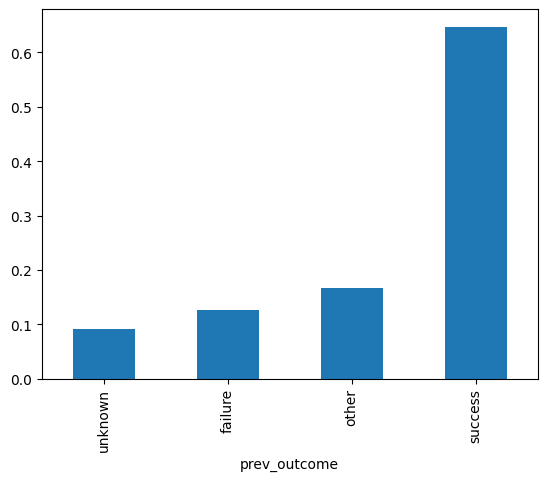

In [166]:
df.groupby(["prev_outcome"])["y"].mean().sort_values().plot.bar()

In [167]:
df["prev_outcome"]=df["prev_outcome"].map({"unknown" : 0,
                                           "failure" : 1,
                                           "other" : 2,
                                           "success" :3})

In [168]:
df.head()

,age,job,marital,education_qual,call_type,day,mon,dur,num_calls,prev_outcome,y
0,58.0,7.0,1,3,0,5,0,261.0,1.0,0,0
1,44.0,4.0,2,1,0,5,0,151.0,1.0,0,0
2,33.0,1.0,1,1,0,5,0,76.0,1.0,0,0
3,47.0,0.0,1,2,0,5,0,92.0,1.0,0,0
4,33.0,0.0,2,2,0,5,0,198.0,1.0,0,0


# Feature Selection

<AxesSubplot: >

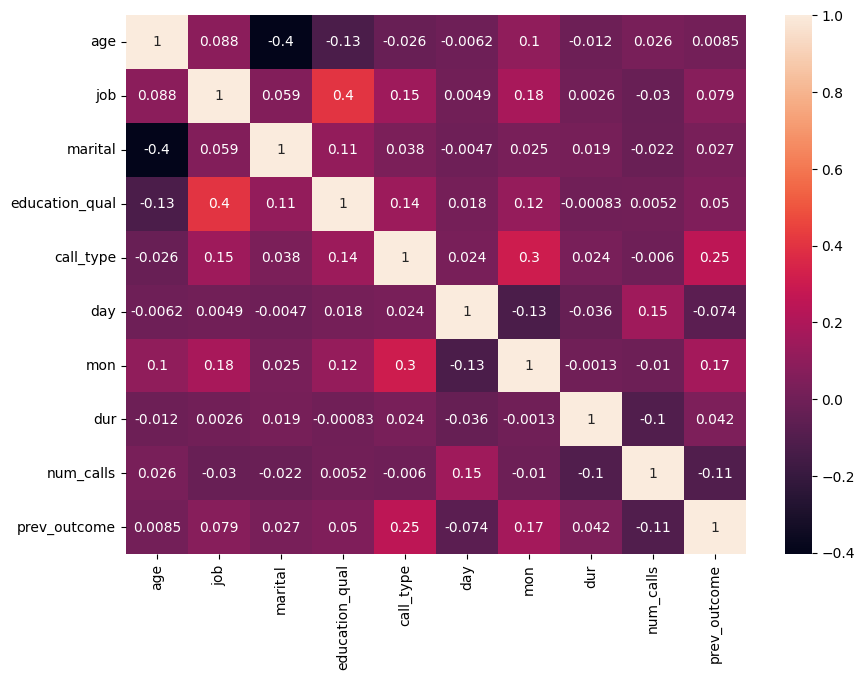

In [489]:
#correleation -based feature selection 

from sklearn.model_selection import train_test_split

x=df.drop(columns="y",axis=1)
y=df["y"]
x_train,x_test,y_train,y_test=train_test_split(x,y,stratify=y,test_size=0.3,random_state=2023)
corr=x_train.corr()
plt.figure(figsize=(10,7))
sns.heatmap(corr,annot=True)

In [170]:
#feature selection - information gain - mutual_info_classification 

from sklearn.feature_selection import mutual_info_classif

mutual_info=mutual_info_classif(x_train,y_train)
mutual_info=pd.Series(mutual_info)
mutual_info.index=x_train.columns
mutual_info.sort_values(ascending=False)

dur               0.070790
prev_outcome      0.027875
mon               0.023193
call_type         0.017686
age               0.012521
job               0.010571
num_calls         0.005245
marital           0.004690
day               0.004328
education_qual    0.001891
dtype: float64

<AxesSubplot: >

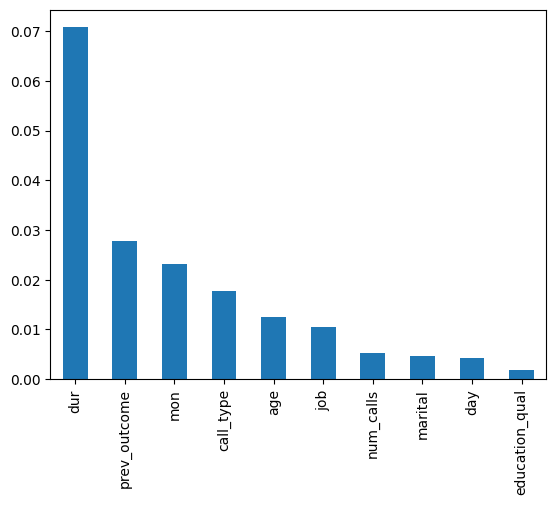

In [171]:
mutual_info.sort_values(ascending=False).plot.bar()

In [172]:
#feature selection using chi-square test

from sklearn.feature_selection import chi2

f_p_values=chi2(x_train,y_train)
f_p_values #it willbe returns f-score values and p-values

f_values=pd.Series(f_p_values[0]) #f-score will be taken
f_values.index=x_train.columns
f_values.sort_values(ascending=False)

dur               635805.665952
prev_outcome        3570.726427
mon                 3370.466760
job                  943.651731
call_type            407.878781
num_calls            245.219152
education_qual       139.592425
day                  108.951282
age                   33.818606
marital               24.219983
dtype: float64

<AxesSubplot: >

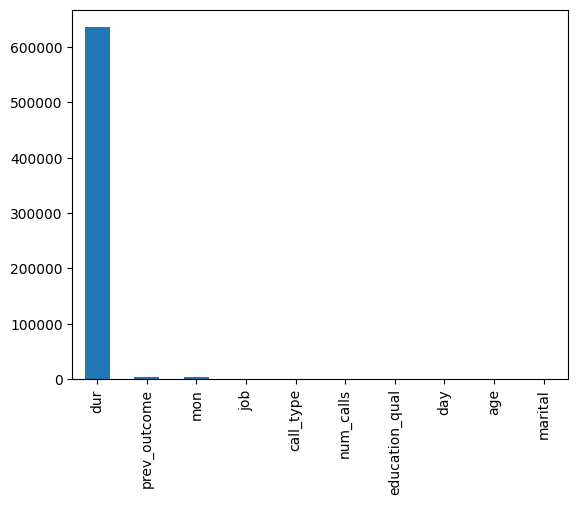

In [173]:
f_values.sort_values(ascending=False).plot.bar()

### imbalancing data_set


In [872]:
from sklearn.model_selection import train_test_split,cross_val_score

x=df.drop(columns="y",axis=1)
y=df["y"]
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=27)

In [873]:
print(x_train.shape,x_test.shape)

(31643, 10) (13562, 10)


In [874]:
y_test.value_counts()

0    11968
1     1594
Name: y, dtype: int64

<AxesSubplot: >

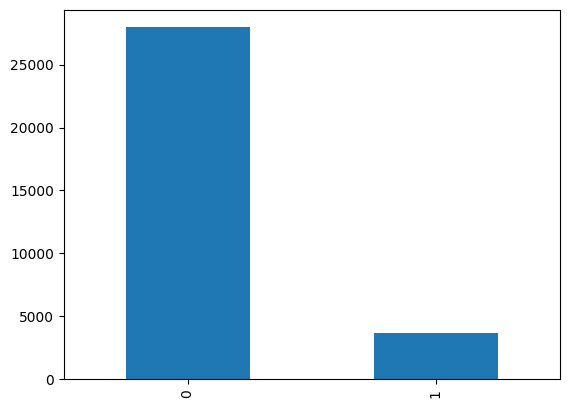

In [634]:
y_train.value_counts().plot.bar()

In [635]:
from imblearn.combine import SMOTETomek

sm=SMOTETomek(sampling_strategy=0.75, random_state=42)
x_sm,y_sm=sm.fit_resample(x_train,y_train)

0    27798
1    20811
Name: y, dtype: int64


<AxesSubplot: >

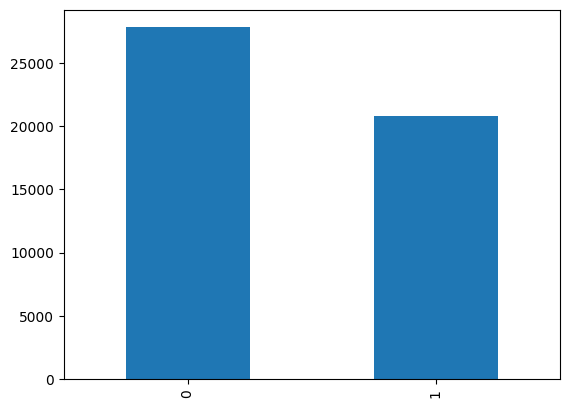

In [636]:
print(y_sm.value_counts())
y_sm.value_counts().plot.bar()

# creating the model

### 1.logistic regression

In [637]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score,classification_report,accuracy_score,confusion_matrix
from sklearn.preprocessing import StandardScaler


#import the pipeline logisticregresion with scale 

model_LR=Pipeline([
    ("scaler",StandardScaler()),
    ("LR",LogisticRegression())
])
model_LR.fit(x_sm,y_sm)


Pipeline(steps=[('scaler', StandardScaler()), ('LR', LogisticRegression())])

In [638]:

#evaluate test dataset
y_pred=model_LR.predict(x_test)
auroc=roc_auc_score(y_test,y_pred)
cls_report=classification_report(y_test,y_pred)

print("confusion matrix:\n",confusion_matrix(y_test,y_pred))
print("the auroc score for test data is:",auroc)
print("auroc score for train data is :",roc_auc_score(y_train,model_LR.predict(x_train)))
print("classification report for test data is:\n",cls_report)


confusion matrix:
 [[9936 2032]
 [ 365 1229]]
the auroc score for test data is: 0.8006151074550956
auroc score for train data is : 0.8018015043596334
classification report for test data is:
               precision    recall  f1-score   support

           0       0.96      0.83      0.89     11968
           1       0.38      0.77      0.51      1594

    accuracy                           0.82     13562
   macro avg       0.67      0.80      0.70     13562
weighted avg       0.90      0.82      0.85     13562



### 2.Decision Tree classifier

In [639]:
from sklearn.tree import DecisionTreeClassifier

#fitting the decision tree
model_dtc=DecisionTreeClassifier()
model_dtc.fit(x_sm,y_sm)

DecisionTreeClassifier()

In [640]:
y_pred=model_dtc.predict(x_test)

In [641]:
#model evaluate

#accuracy score
print("accuracy score of the test data set:",accuracy_score(y_test,y_pred))

#auroc score
print("roc_auc_score of the test data set:",roc_auc_score(y_test,y_pred))

#confusion matrix
print("confusion matrix:\n",confusion_matrix(y_test,y_pred))

accuracy score of the test data set: 0.856510839109276
roc_auc_score of the test data set: 0.7025407884010225
confusion matrix:
 [[10817  1151]
 [  795   799]]


In [642]:

y_pred=model_dtc.predict(x_train)

#accuracy score
print("accuracy score of the train data set:",accuracy_score(y_train,y_pred))

#auroc score
print("roc_auc_score of the train data set:",roc_auc_score(y_train,y_pred))

#confusion matrix
print("confusion matrix:\n",confusion_matrix(y_train,y_pred))

accuracy score of the train data set: 0.9975033972758588
roc_auc_score of the train data set: 0.99600325309346
confusion matrix:
 [[27891    57]
 [   22  3673]]


In [643]:
##OVERFITTING HAPPEN HERE,SO WE REDUCE THE OVER FITTING by using hit and trail cross validation

for depth in ([1,2,3,4,5,6,7,8,9,10,12,14,16,18,20,25,30,35,40,45,50]):
    dt=DecisionTreeClassifier(max_depth=depth)
    dt.fit(x_sm,y_sm)
    print("depth:",depth,"accuracy_score is:",accuracy_score(y_train,dt.predict(x_train)),"CV score is:",np.mean(cross_val_score(dt,x_train,y_train,cv=10)))

depth: 1 accuracy_score is: 0.8154410138103214 CV score is: 0.8832285306858557
depth: 2 accuracy_score is: 0.7390260089119236 CV score is: 0.8917930489731438
depth: 3 accuracy_score is: 0.7858610119141675 CV score is: 0.9003573375833577
depth: 4 accuracy_score is: 0.7936352431817464 CV score is: 0.9027590707465304
depth: 5 accuracy_score is: 0.822930821982745 CV score is: 0.9025376520612021
depth: 6 accuracy_score is: 0.8373731947034099 CV score is: 0.9015895351136303
depth: 7 accuracy_score is: 0.8511519135353791 CV score is: 0.899819873258199
depth: 8 accuracy_score is: 0.8519735802547167 CV score is: 0.8988402006778469
depth: 9 accuracy_score is: 0.8711247353285086 CV score is: 0.8959642442725528
depth: 10 accuracy_score is: 0.8852826849540183 CV score is: 0.8952693013622847
depth: 12 accuracy_score is: 0.9135985842050375 CV score is: 0.8912555946339447
depth: 14 accuracy_score is: 0.940239547451253 CV score is: 0.8862624549882865
depth: 16 accuracy_score is: 0.964510318237841 CV sc

#### based on hyperparameter tuning max_depth value is 5

In [646]:
#auroc_roc score for train dataset
dt=DecisionTreeClassifier(max_depth=5)
dt.fit(x_sm,y_sm)
print("auroc_score for train dataset is:",roc_auc_score(y_train,dt.predict(x_train)))
print("confusion matrix:\n",confusion_matrix(y_train,dt.predict(x_train)))

auroc_score for train dataset is: 0.8153298034838719
confusion matrix:
 [[23064  4884]
 [  719  2976]]


In [647]:
#auroc_roc score for test dataset
print("auroc_score for test data set is:",roc_auc_score(y_test,dt.predict(x_test)))

#acuracy score for test data set
print("accuracy score of test dataset is:",accuracy_score(y_test,dt.predict(x_test)))

#confusion matrix
print("confusion matrix:\n",confusion_matrix(y_test,dt.predict(x_test)))

auroc_score for test data set is: 0.8052462358845671
accuracy score of test dataset is: 0.8107948680135674
confusion matrix:
 [[9724 2244]
 [ 322 1272]]


<AxesSubplot: >

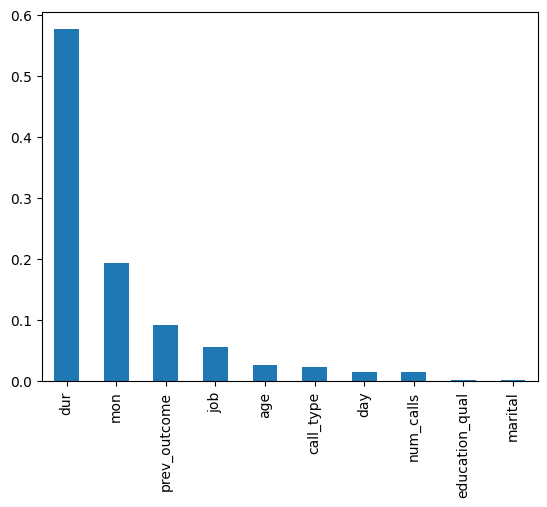

In [649]:
feature_imp=pd.Series(data=dt.feature_importances_,index=['age', 'job','marital', 'education_qual','call_type', 'day', 'mon','dur', 'num_calls', 'prev_outcome'])
feature_imp.sort_values(ascending=False).plot.bar()

### 3.KNN-classifier

In [650]:
#fitting the KNN-classifier model

from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import Pipeline

clf=Pipeline([
    ("scale",StandardScaler()),
    ("knn",KNeighborsClassifier())
])

clf.fit(x_sm,y_sm)
y_pred=clf.predict(x_test)

#auroc score for test dataset
roc_auc_score(y_test,y_pred)

0.7869496931172377

In [651]:
#auroc score for train dataset
roc_auc_score(y_train,clf.predict(x_train))

0.8979615293664456

In [518]:
#HYPERPARAMETER TUNING and HIT AND TRAIL CROSS VALIDATION

for i in ([1,2,3,4,5,6,7,8,9,10,12,14,16,20]):
    knn=Pipeline([
        ("scale",StandardScaler()),
        ("knn",KNeighborsClassifier(n_neighbors=i))
    ])
    
    knn.fit(x_sm,y_sm)
    print("k value:",i,"accuracy is:",accuracy_score(y_train,knn.predict(x_train)),"CV score:",np.mean(cross_val_score(knn,x_train,y_train,cv=10)))

k value: 1 accuracy is: 0.9969619207739728 CV score: 0.8743767077349466
k value: 2 accuracy is: 0.9849865793587588 CV score: 0.8875319886320634
k value: 3 accuracy is: 0.9223962481196354 CV score: 0.8871779193405415
k value: 4 accuracy is: 0.9324543550718225 CV score: 0.8924282566467372
k value: 5 accuracy is: 0.895289502403917 CV score: 0.8907765132238818
k value: 6 accuracy is: 0.906409462289473 CV score: 0.8939916523784547
k value: 7 accuracy is: 0.8819573489071764 CV score: 0.8939032350948068
k value: 8 accuracy is: 0.8924578945816004 CV score: 0.8960859780661806
k value: 9 accuracy is: 0.8719877296994366 CV score: 0.8956139494706183
k value: 10 accuracy is: 0.8815149101849394 CV score: 0.89664625866318
k value: 12 accuracy is: 0.8743768987995163 CV score: 0.8977081098761339
k value: 14 accuracy is: 0.8700115034067781 CV score: 0.8984750106346053
k value: 16 accuracy is: 0.8654396366103295 CV score: 0.8987402537864849
k value: 20 accuracy is: 0.859805916880512 CV score: 0.898887850

#### based on hyper parameter tuning best k value is above 20

In [652]:
knn=Pipeline([
    ("scale",StandardScaler()),
    ("knn",KNeighborsClassifier(n_neighbors=35))
])
knn.fit(x_sm,y_sm)
print(" auroc score for test dataset is :",roc_auc_score(y_test,knn.predict(x_test)))
print(" auroc score for train dataset is :",roc_auc_score(y_train,knn.predict(x_train)))

#confusion matrix
print("confusion matrix:\n",confusion_matrix(y_test,knn.predict(x_test)))

 auroc score for test dataset is : 0.8124040205080549
 auroc score for train dataset is : 0.8424953804600966
confusion matrix:
 [[10053  1915]
 [  343  1251]]


### 4.Naive Bayes

In [653]:
#biuld the model of Gaussian Naive Bayes 
from sklearn.naive_bayes import GaussianNB

model_NB=GaussianNB()
model_NB.fit(x_sm,y_sm)

GaussianNB()

In [654]:
#evaluate the model

print("accuracy score of NB :",accuracy_score(y_test,model_NB.predict(x_test)))
print("auroc score for test dataset is:",roc_auc_score(y_test,model_NB.predict(x_test)))
print("auroc score for train dataset is:",roc_auc_score(y_train,model_NB.predict(x_train)))
print("classification report is:\n",classification_report(y_test,model_NB.predict(x_test)))

#confusion matrix
print("confusion matrix:\n",confusion_matrix(y_test,model_NB.predict(x_test)))

cv score is: 0.8730528277242197
accuracy score of NB : 0.8098363073293025
auroc score for test dataset is: 0.7824074675923751
auroc score for train dataset is: 0.7857143694078679
classification report is:
               precision    recall  f1-score   support

           0       0.96      0.82      0.88     11968
           1       0.35      0.75      0.48      1594

    accuracy                           0.81     13562
   macro avg       0.66      0.78      0.68     13562
weighted avg       0.89      0.81      0.84     13562

confusion matrix:
 [[9793 2175]
 [ 404 1190]]


### 5.Support Vector Machine Classifier

#### hyper parameter tuning 

In [289]:
from sklearn.svm import SVC
# build the poly kernal model

svc_poly=SVC(kernel="poly")
svc_poly.fit(x_sm,y_sm)

SVC(kernel='poly')

In [296]:
#evaluate the poly kernel svc model

print("accuracy score of poly kernel SVC :",accuracy_score(y_test,svc_poly.predict(x_test)))
print("auroc score for test dataset of poly kernel SVC:",roc_auc_score(y_test,svc_poly.predict(x_test)))
print("auroc score for train dataset of poly kernel SVC:",roc_auc_score(y_train,svc_poly.predict(x_train)))

print("classification report of poly kernel SVC:\n",classification_report(y_test,svc_poly.predict(x_test)))

#confusion matrix
print("confusion matrix of poly kernel SVC:\n",confusion_matrix(y_test,svc_poly.predict(x_test)))

accuracy score of poly kernel SVC : 0.8567510175190232
auroc score for test dataset of poly kernel SVC: 0.7295656365681438
auroc score for train dataset of poly kernel SVC: 0.7180025563652673
classification report of poly kernel SVC:
               precision    recall  f1-score   support

           0       0.94      0.90      0.92      9980
           1       0.42      0.56      0.48      1322

    accuracy                           0.86     11302
   macro avg       0.68      0.73      0.70     11302
weighted avg       0.88      0.86      0.87     11302

confusion matrix of poly kernel SVC:
 [[8938 1042]
 [ 577  745]]


In [297]:
#build the rbf kernel model

svc_rbf=SVC(kernel="rbf")
svc_rbf.fit(x_sm,y_sm)

SVC()

In [379]:
#evaluate the rbf kernel svc model

print("accuracy score for test dataset of rbf kernel SVC :",accuracy_score(y_test,svc_rbf.predict(x_test)))
print("accuracy score for train dataset of rbf kernel SVC :",accuracy_score(y_train,svc_rbf.predict(x_train)))

print("auroc score for test dataset of rbf kernel SVC:",roc_auc_score(y_test,svc_rbf.predict(x_test)))
print("auroc score for train dataset of rbf kernel SVC:",roc_auc_score(y_train,svc_rbf.predict(x_train)))
      
print("classification report for test dataset of rbf kernel SVC:\n",classification_report(y_test,svc_rbf.predict(x_test)))

#confusion matrix
print("confusion matrix of rbf kernel SVC:\n",confusion_matrix(y_test,svc_rbf.predict(x_test)))

accuracy score for test dataset of rbf kernel SVC : 0.8042824278888693
accuracy score for train dataset of rbf kernel SVC : 0.8108132023714716
auroc score for test dataset of rbf kernel SVC: 0.7877909373967299
auroc score for train dataset of rbf kernel SVC: 0.7904221931752027
classification report for test dataset of rbf kernel SVC:
               precision    recall  f1-score   support

           0       0.96      0.81      0.88      9980
           1       0.35      0.77      0.48      1322

    accuracy                           0.80     11302
   macro avg       0.66      0.79      0.68     11302
weighted avg       0.89      0.80      0.83     11302

confusion matrix of rbf kernel SVC:
 [[8077 1903]
 [ 309 1013]]


In [300]:
#build the sigmoid kernel  model

svc_sig=SVC(kernel='sigmoid')
svc_sig.fit(x_sm,y_sm)

SVC(kernel='sigmoid')

In [301]:
#evaluate the sigmoid kernel svc model

print("accuracy score of sigmoid kernel SVC :",accuracy_score(y_test,svc_sig.predict(x_test)))
print("auroc score for train dataset of sigmoid kernel SVC:",roc_auc_score(y_test,svc_sig.predict(x_test)))
print("auroc score for test dataset of sigmoid kernel SVC:",roc_auc_score(y_train,svc_sig.predict(x_train)))

print("classification report of sigmoid kernel SVC:\n",classification_report(y_test,svc_sig.predict(x_test)))

#confusion matrix
print("confusion matrix of sigmoid kernel SVC:\n",confusion_matrix(y_test,svc_sig.predict(x_test)))

accuracy score of sigmoid kernel SVC : 0.6888161387365068
auroc score for train dataset of sigmoid kernel SVC: 0.663677657887636
auroc score for test dataset of sigmoid kernel SVC: 0.6561653559355327
classification report of sigmoid kernel SVC:
               precision    recall  f1-score   support

           0       0.93      0.70      0.80      9980
           1       0.22      0.63      0.32      1322

    accuracy                           0.69     11302
   macro avg       0.58      0.66      0.56     11302
weighted avg       0.85      0.69      0.74     11302

confusion matrix of sigmoid kernel SVC:
 [[6951 3029]
 [ 488  834]]


## Ensemble Techniques

### 6.Random Forest 

In [720]:
#import the RF library
from sklearn.ensemble import RandomForestClassifier

rf=RandomForestClassifier(n_estimators=100,max_depth=4, random_state=0)
rf.fit(x_sm,y_sm)


RandomForestClassifier(max_depth=4, random_state=0)

In [721]:
#auroc score for train data
roc_auc_score(y_train,rf.predict(x_train))

0.8210305994527243

In [722]:
#auroc score for test data
roc_auc_score(y_test,rf.predict(x_test))

0.8041470584041761

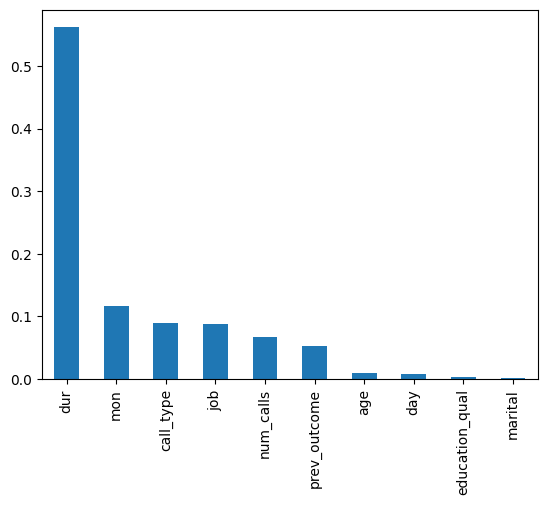

In [723]:
#feature importances

feature_im=pd.Series(data=rf.feature_importances_,index=['age', 'job','marital', 'education_qual', 'call_type', 'day', 'mon','dur', 'num_calls', 'prev_outcome'])
feature_im=feature_im.sort_values(ascending=False).plot.bar()

### 7.Bagging Classifier

In [727]:
from sklearn.ensemble import BaggingClassifier

bc=BaggingClassifier(DecisionTreeClassifier(max_depth=3,random_state=0),n_estimators=100)

bc.fit(x_sm,y_sm)

BaggingClassifier(estimator=DecisionTreeClassifier(max_depth=3, random_state=0),
                  n_estimators=100)

In [728]:
#auroc score for test dataset
roc_auc_score(y_test,bc.predict(x_test))

0.8012004722757131

In [729]:
#auroc score for train dataset
roc_auc_score(y_train,bc.predict(x_train))

0.8108604894107421

### 8. Voting classifier

In [730]:
from sklearn.ensemble import VotingClassifier
import warnings
warnings.filterwarnings('ignore')

model1=LogisticRegression()
model2=DecisionTreeClassifier(max_depth=4)
model3=RandomForestClassifier(n_estimators=100,max_depth=3,random_state=0)


vc=VotingClassifier(estimators=[
    ("lr",model1),("dtc",model2),("rfc", model3)],voting="soft")

In [731]:
vc.fit(x_sm,y_sm)

VotingClassifier(estimators=[('lr', LogisticRegression()),
                             ('dtc', DecisionTreeClassifier(max_depth=4)),
                             ('rfc',
                              RandomForestClassifier(max_depth=3,
                                                     random_state=0))],
                 voting='soft')

In [732]:
#auroc score for test dataset
roc_auc_score(y_test,vc.predict(x_test))

0.8037573219090305

In [733]:
#auroc score for train dataset
roc_auc_score(y_train,vc.predict(x_train))

0.8119657074330774

### 9.XG Boost

In [876]:
from xgboost import XGBClassifier

xgb=XGBClassifier()

xgb.fit(x_sm.values,y_sm.values)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [877]:
#auroc score for test dataset
roc_auc_score(y_test.values,xgb.predict(x_test.values))

0.7396567551110784

In [878]:
#auroc score for train dataset
roc_auc_score(y_train.values,xgb.predict(x_train.values))

0.844686352559257

#### model leads to overfitting on training data. so,we do the hyperparameter tuning

In [674]:
for lr in ([0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.1,0.11,0.12,0.13,0.14,0.15,0.2,0.5,0.7,1]):
    model=XGBClassifier(learning_rate=lr,n_estimators=100,verbosity=0)
    model.fit(x_sm,y_sm)
    print("learing rate:",lr,"Train score:",model.score(x_train,y_train),"CV score:",np.mean(cross_val_score(model,x_train,y_train,cv=10)))

learing rate: 0.01 Train score: 0.8440097335903676 CV score: 0.9025376221033227
learing rate: 0.02 Train score: 0.8606642859400183 CV score: 0.9027274252401124
learing rate: 0.03 Train score: 0.8762759536074329 CV score: 0.9026326784540937
learing rate: 0.04 Train score: 0.8855039029169168 CV score: 0.9028854430670477
learing rate: 0.05 Train score: 0.8935309547135227 CV score: 0.9027906263793108
learing rate: 0.06 Train score: 0.8998514679391967 CV score: 0.9033911720121509
learing rate: 0.07 Train score: 0.9051923016148912 CV score: 0.9034858688683711
learing rate: 0.08 Train score: 0.9083841607938564 CV score: 0.9033278710133551
learing rate: 0.09 Train score: 0.9114812122744367 CV score: 0.9025695272446941
learing rate: 0.1 Train score: 0.9142622380937332 CV score: 0.9024745807394803
learing rate: 0.11 Train score: 0.9154631356066113 CV score: 0.9041494358931341
learing rate: 0.12 Train score: 0.9185601870871914 CV score: 0.9038968010976568
learing rate: 0.13 Train score: 0.9206459

In [879]:
#after hyperparameter tuning
xgbc=XGBClassifier(gamma= 1,learning_rate=0.12,max_depth=3,reg_lambda=10,scale_pos_weight=3,
                   n_estimators=200)
xgbc.fit(x_sm.values,y_sm.values)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=1, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.12, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=200, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [881]:
#auroc score for test dataset
roc_auc_score(y_test.values,xgbc.predict(x_test.values))

0.8489281748401425

In [882]:
#auroc score for train dataset
roc_auc_score(y_train.values,xgbc.predict(x_train.values))

0.8528009392273647

## observation
Above, I developed nine models and calculated the AUROC score for each model. The **XGBoost classifier** model gave the best AUROC score of **85%**. Therefore, we will develop further operations based on the XGBoost classifier model.

### Export the XGBoost Classifier model as pickle format

In [899]:
import pickle

#save the model using pickle
with open("cus_conver_XGBC_model.pkl","wb") as f:
    pickle.dump(xgbc,f)

### important factors for conversion

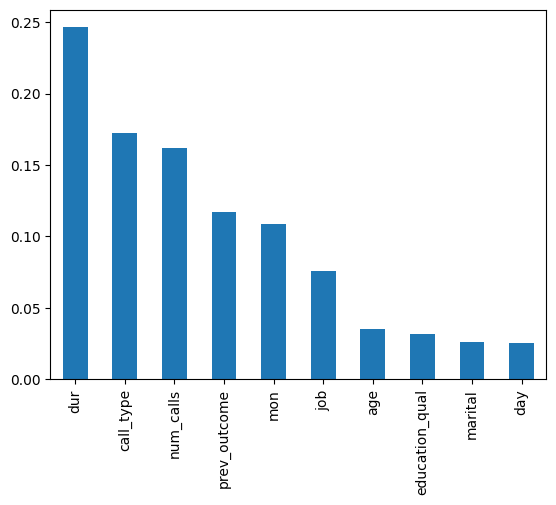

In [898]:
feature_im=pd.Series(data=xgbc.feature_importances_,index=['age', 'job','marital', 'education_qual', 'call_type', 'day', 'mon','dur', 'num_calls', 'prev_outcome'])
feature_im=feature_im.sort_values(ascending=False).plot.bar()

## observation

The duration of the last call plays a major role in the conversion rate of this model. The next steps are to consider the call type and number of calls,prev_outcome and so on